# Long notebook for group 16

**Kaggle competition**: *Moscow Housing*

**Kaggle team name**: *Team 16*

**Team members**: name - studentId
- Laure Beringer - 566761
- Hasse Rombouts - 566536
- Henrik Fjellheim - 490763


In this notebook we will present all important experiments we've tried for the project of the TDT4173 Machine Learning course.  
The notebook will present the following:
1. [EDA](#eda)
2. [Feature Engineering](#featureEngineering)
2. [Models](#models)
3. [Ensemble of models](#ensemble-of-models)


Imports and main common functions:

In [1]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor
from scipy import stats
import json
import seaborn as sns

import plotly.express as px
import matplotlib.pylab as plt
plt.style.use('ggplot')

def root_mean_squared_log_error(y_true, y_pred):
    # Alternatively: sklearn.metrics.mean_squared_log_error(y_true, y_pred) ** 0.5
    assert (y_true >= 0).all() 
    assert (y_pred >= 0).all()
    log_error = np.log1p(y_pred) - np.log1p(y_true)  # Note: log1p(x) = log(1 + x)
    return np.mean(log_error ** 2) ** 0.5

## EDA

This part will contain :
1. [Loading and describing the data](#loading-and-description-of-the-data)
2. [Further investigation and data cleaning]()
3. [Handling missing values](#missing-values)
4. [Feature engineering](#feature-engineering)

### Loading and description of the data

#### Loading

Loading and merging of the data:

In [4]:
# Reading the datasets
# Metadata
metaData_apartment = pd.read_json('../data/apartments_meta.json')
metaData_building = pd.read_json('../data/buildings_meta.json')
metaData = pd.concat([metaData_apartment, metaData_building])

# train
train_apartment = pd.read_csv('../data/apartments_train.csv')
train_building = pd.read_csv('../data/buildings_train.csv')
df_train = pd.merge(train_apartment, train_building, left_on='building_id', right_on='id')
df_train.rename(columns={'id_x' : 'apartment_id'}, inplace=True)
df_train.drop('id_y', axis=1, inplace=True)

# test
test_apartment = pd.read_csv('../data/apartments_test.csv')
test_building = pd.read_csv('../data/buildings_test.csv')
df_test = pd.merge(test_apartment, test_building, left_on='building_id', right_on='id')
df_test.rename(columns={'id_x' : 'apartment_id'}, inplace=True)
df_test.drop('id_y', axis=1, inplace=True)

df_all = pd.concat([df_train, df_test])

Some basic information about the data:

In [7]:
print('Number of Training Examples = {}'.format(df_train.shape[0]))
print('Number of Test Examples = {}\n'.format(df_test.shape[0]))
print('Training X Shape = {}'.format(df_train.shape))
print('Training y Shape = {}\n'.format(df_train['price'].shape[0]))
print('Test X Shape = {}'.format(df_test.shape))
print('Test y Shape = {}\n'.format(df_test.shape[0]))
print('Train columns \n', list(df_train.columns))
print('Test columns \n', list(df_test.columns))

Number of Training Examples = 23285
Number of Test Examples = 9937

Training X Shape = (23285, 34)
Training y Shape = 23285

Test X Shape = (9937, 33)
Test y Shape = 9937

Train columns 
 ['apartment_id', 'seller', 'price', 'area_total', 'area_kitchen', 'area_living', 'floor', 'rooms', 'layout', 'ceiling', 'bathrooms_shared', 'bathrooms_private', 'windows_court', 'windows_street', 'balconies', 'loggias', 'condition', 'phones', 'building_id', 'new', 'latitude', 'longitude', 'district', 'street', 'address', 'constructed', 'material', 'stories', 'elevator_without', 'elevator_passenger', 'elevator_service', 'parking', 'garbage_chute', 'heating']
Test columns 
 ['apartment_id', 'seller', 'area_total', 'area_kitchen', 'area_living', 'floor', 'rooms', 'layout', 'ceiling', 'bathrooms_shared', 'bathrooms_private', 'windows_court', 'windows_street', 'balconies', 'loggias', 'condition', 'phones', 'building_id', 'new', 'latitude', 'longitude', 'district', 'street', 'address', 'constructed', 'mater

#### Description

Functions to describe each colmuns of the data using the metadata:

In [8]:
def describe_column(meta):
    """
    Utility function for describing a dataset column (see below for usage)
    """
    def f(x):
        d = pd.Series(name=x.name, dtype=object)
        m = next(m for m in meta if m['name'] == x.name)
        d['Type'] = m['type']
        d['#NaN'] = x.isna().sum()
        d['Description'] = m['desc']
        if m['type'] == 'categorical':
            counts = x.dropna().map(dict(enumerate(m['cats']))).value_counts().sort_index()
            d['Statistics'] = ', '.join(f'{c}({n})' for c, n in counts.items())
        elif m['type'] == 'real' or m['type'] == 'integer':
            stats = x.dropna().agg(['mean', 'std', 'min', 'max'])
            d['Statistics'] = ', '.join(f'{s}={v :.1f}' for s, v in stats.items())
        elif m['type'] == 'boolean':
            counts = x.dropna().astype(bool).value_counts().sort_index()
            d['Statistics'] = ', '.join(f'{c}({n})' for c, n in counts.items())
        else:
            d['Statistics'] = f'#unique={x.nunique()}'
        return d
    return f

def describe_data(data, meta):
    desc = data.apply(describe_column(meta)).T
    desc = desc.style.set_properties(**{'text-align': 'left'})
    desc = desc.set_table_styles([ dict(selector='th', props=[('text-align', 'left')])])
    return desc 

Description of the apartment data:

In [10]:
print(f'Loaded {len(train_apartment)} apartments')
# metadata as json
with open('../data/apartments_meta.json') as f: 
    apartments_meta = json.load(f)
describe_data(train_apartment, apartments_meta)

Loaded 23285 apartments


,Type,#NaN,Description,Statistics
id,integer_id,0,Unique ID for apartment,#unique=23285
seller,categorical,8830,The type of apartment seller,"Agents(1895), Company(4768), Developer(6185), Owner(1607)"
price,real,0,The listed price of the apartment (TARGET),"mean=23556173.5, std=52643927.8, min=900000.0, max=2600000000.0"
area_total,real,0,Total area of the apartment,"mean=74.5, std=58.7, min=9.3, max=2181.0"
area_kitchen,real,4721,Total kitchen area in the apartment,"mean=12.6, std=6.6, min=1.0, max=100.0"
area_living,real,3882,Total living space area in the apartment,"mean=38.7, std=31.4, min=0.0, max=900.0"
floor,integer,0,Primary building floor of the apartment,"mean=9.0, std=8.3, min=1.0, max=95.0"
rooms,integer,0,Number of rooms in the apartment,"mean=2.2, std=1.1, min=1.0, max=6.0"
layout,categorical,17642,Overal apartment layout,"Adjacent(241), Adjacent_isolated(465), Isolated(4937)"
ceiling,real,11093,Ceiling height in the apartment,"mean=3.3, std=10.8, min=0.0, max=340.0"


We can see that the features with no nan values are : id, price, area_total, floor, rooms and building_id.  
The categorical features of the apartments are : seller, layout and condition.

Description of the building data:

In [12]:
print(f'Loaded {len(train_building)} building')
# metadata as json
with open('../data/buildings_meta.json') as f: 
    building_meta = json.load(f)
describe_data(train_building, building_meta)

Loaded 6791 building


,Type,#NaN,Description,Statistics
id,integer_id,0,Unique ID of building for joining with apartments,#unique=6791
new,boolean,227,Whether it is an old or new building,"False(6141), True(423)"
latitude,real,0,Latitude coordinate of building,"mean=55.7, std=0.1, min=55.2, max=56.0"
longitude,real,0,Longitude coordinate of building,"mean=37.6, std=0.2, min=36.9, max=38.0"
district,categorical,1,Administriative district within Moscow,"Central(637), East(956), North(593), North-East(630), North-West(553), Novomoskovsk(344), South(758), South-East(672), South-West(900), Troitsk(146), West(535), Zelenograd(66)"
street,string,0,Bulding street name,#unique=1682
address,string,0,Building address (within street),#unique=1851
constructed,integer,479,Year when the building was constructed,"mean=1985.8, std=24.3, min=1855.0, max=2023.0"
material,categorical,1165,Primary building material used in building,"Block(679), Bricks(1226), Monolith(1312), Monolithic_brick(19), Panel(2384), Stalin_project(2), Wood(4)"
stories,integer,0,Total number of floors in the building,"mean=13.0, std=7.0, min=1.0, max=95.0"


We can see that the features with no nan values are : id, latitude, longitude, street, address and stories.  
The categorical features of the building data are : district, material, parking and heating

#### First plots

##### Histograms to get an overview
Initially a the histogram of all features were plotted, giving an overview of the data and what to expect from the features. Some immediate points of concern where noted right away.

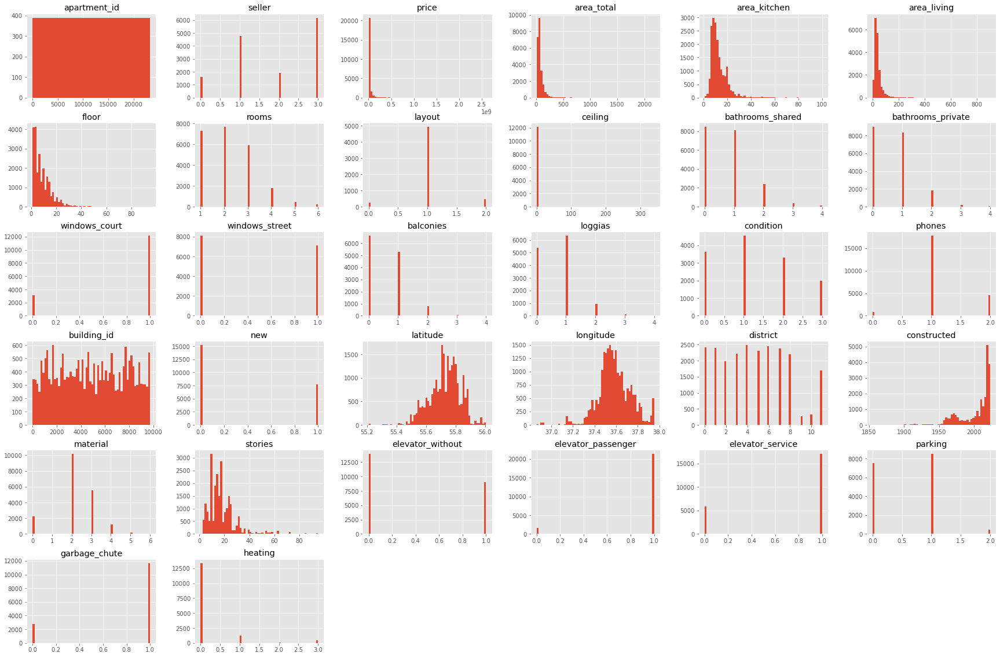

In [13]:
#df_train[["area_total", "area_living", "area_kitchen", "ceiling", "latitude", "longitude"]].hist(bins=60, figsize=(30,7))
df_train.hist(bins=60, figsize=(30,20))
plt.show()

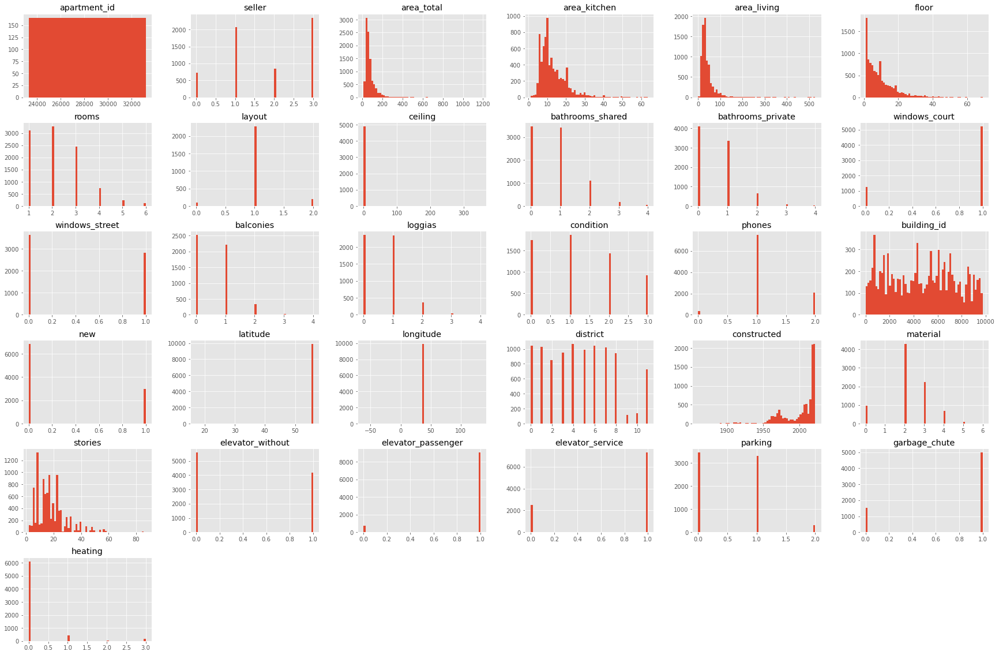

In [14]:
df_test.hist(bins=60, figsize=(30,20))
plt.show()

#### Immediate notes of concern
- The price distribution is heavily skewed. There are appartments in the dataset with a very high price. This is probably the reason for using the RSMLE loss function on our predictions, instead of the standard RMSE.
- Area-data seems to contain some outliers, probably some huge luxury appartments, which heavily skew the histogram. A possible solution for this might be to use logged values of the areas instead.
- Ceiling data for both training and testing data has some super-wide outlayers. It looks like some ceilings are above 300 meters. We will need to look into that.
- While longitude and lattitude seems to have a gaussian distribution for train data, in the testing data there seems to be something off

#### Looking at NaN-distributions
In addition to checking the histograms, looking at the NaN percentages of each features is a good place to start. We see that many features have more than 50% NaN rate, and we will have to be creative if we are to use these effectively. Useful is that both the training and testing dataset typically have a similar NaN rate.

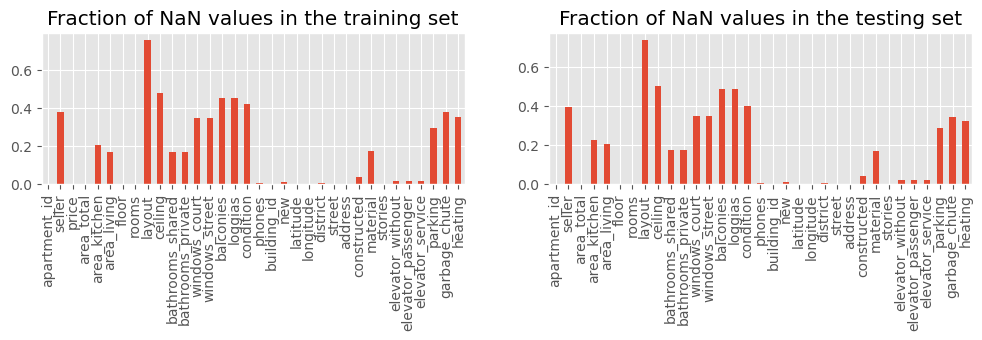

In [15]:
fig, (ax1, ax2) = plt.subplots(figsize=(12, 2), ncols=2, dpi=100)
df_train.isna().mean().plot.bar(ax=ax1, title='Fraction of NaN values in the training set')
df_test.isna().mean().plot.bar(ax=ax2, title='Fraction of NaN values in the testing set');

#### Plot the total correlation map
Knowing what correlates and not will be helpful, both for engineering new features - but also for filling nans!

<AxesSubplot:>

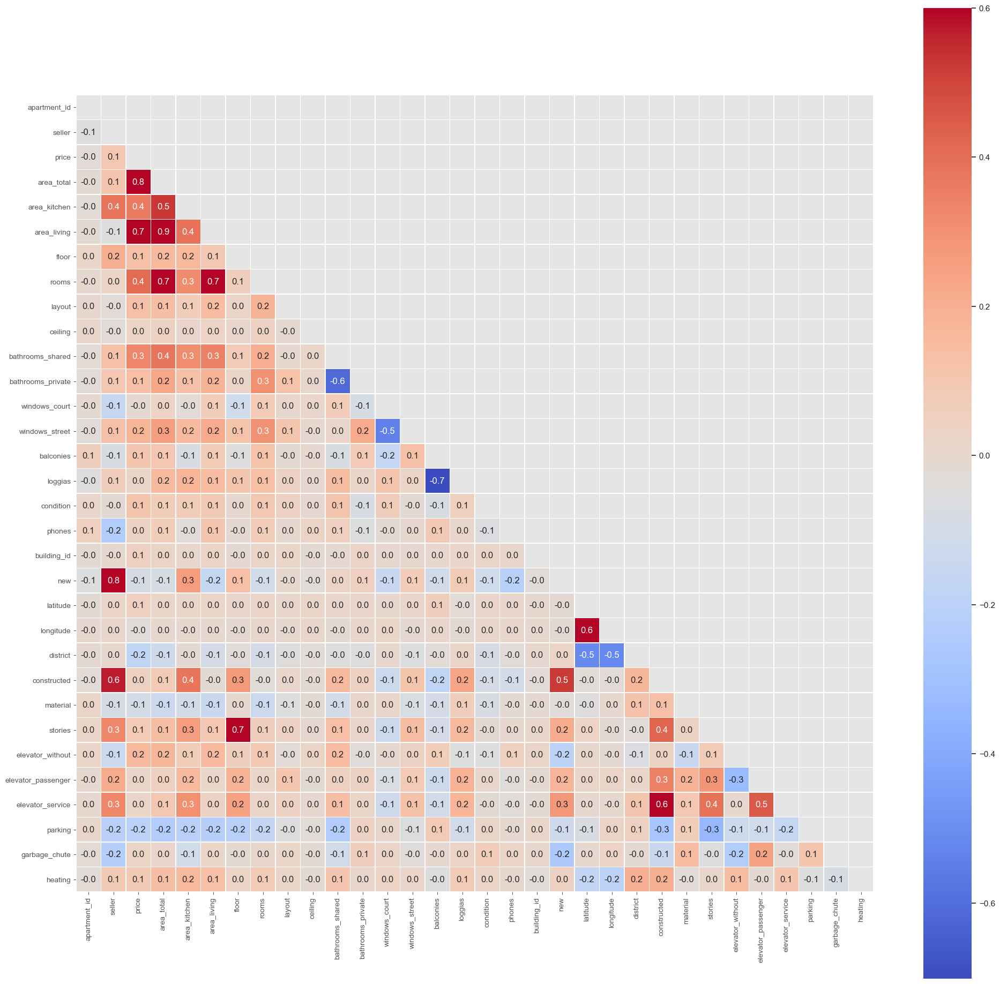

In [16]:
# Compute the correlation matrix
corr = df_all.corr()
# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))
# Set up the matplotlib figure
f, ax1 = plt.subplots(figsize=(24, 24), dpi=100)
# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)
# Draw the heatmap with the mask and correct aspect ratio
sns.set_theme(style="dark")
sns.heatmap(corr, mask=mask, vmax=0.6, square=True, cmap='coolwarm', annot=True, linewidths=.5, fmt= '.1f',ax=ax1)

### Further exploring of features and data cleaning

#### Price distribution
The price distribution in training data contains a lot of outliers, as for the area data, skewing the graph heavily.
We know that an "Root mean squared **logarithic** error" function is going to be used for the loss of this competition, so missing some of the outliers in our prediction won't be that impactful on our score.

*In case we are going to train any models, without the RMSLE loss metric/evaluation/score - we will need to manually log the price before passing it to the model.*

In [17]:
logged_price = np.log(df_train["price"])

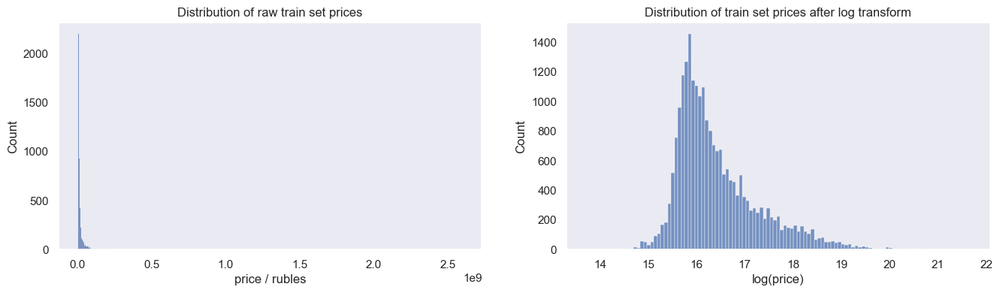

In [19]:
fig, (ax1, ax2) = plt.subplots(figsize=(16, 4), ncols=2, dpi=100)
sns.histplot(df_train.price.rename('price / rubles'), ax=ax1)
ax1.set_title('Distribution of raw train set prices')
sns.histplot(logged_price.rename('log(price)'), ax=ax2)
ax2.set_title('Distribution of train set prices after log transform');

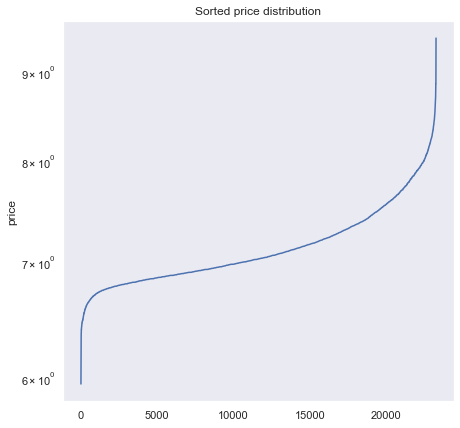

In [20]:
price_sorted = df_train['price'].sort_values(ignore_index=True)
price_sorted.head()
f, ax = plt.subplots(figsize=(7, 7))
ax.set(yscale="log")
ax.set_title('Sorted price distribution')
plot1 = sns.lineplot(data=price_sorted, ax=ax)

#### Area data
Lets now look at area data. We will first log() it, to get a more even distribution.

In [21]:
df_train[["area_total", "area_living", "area_kitchen"]] = np.log1p(df_train[["area_total", "area_living", "area_kitchen"]])
df_test[["area_total", "area_living", "area_kitchen"]] = np.log1p(df_test[["area_total", "area_living", "area_kitchen"]])

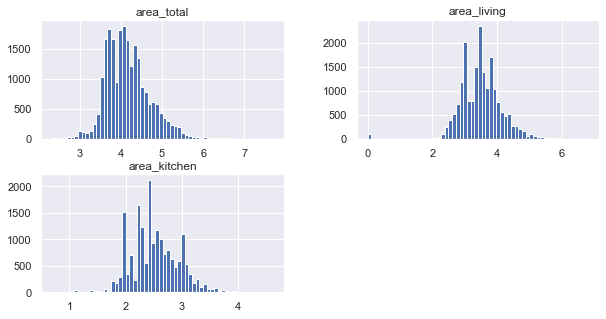

In [22]:
df_train[["area_total", "area_living", "area_kitchen"]].hist(bins=60, figsize=(10, 5));

**Area_living**: Then we will look at some correlation between the different areas. From the correlation map above we see some clear correlation between `area_total` and `area_living` (0.9!) If we see a good correlation we could use `area_total` to fillnans of `area_living`. 

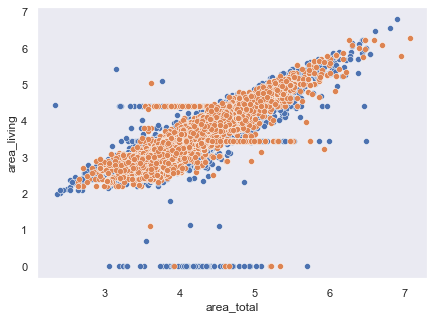

In [24]:
plt.figure(figsize=(7, 5))
sns.scatterplot(data=df_train, x="area_total", y="area_living")
sns.scatterplot(data=df_test, x="area_total", y="area_living")
plt.show()

**Alright** that is indeed a good correlation, but we notice two things we need to fix right away:
- There are **zero** values in the `area_living` dataset. This can be fixed by using the correlated area_total to move the zeroes to a more reasonable position. Area_total also has no nans itself, so this should be possible
- Some apartments have more `area_living` than what they have `area_total`. This is also unrealistic, and will be fixed 

In [25]:
# Replace the zeroes in area_living with expected values based on the area_total of the apartment
remove_zero = [row["area_living"] if row["area_living"] > 0 else row["area_total"]*(df_train["area_living"].mean() / df_train["area_total"].mean()) for _, row in df_train.iterrows()] 
df_train["area_living"] = remove_zero

remove_zero = [row["area_living"] if row["area_living"] > 0 else row["area_total"]*(df_test["area_living"].mean() / df_test["area_total"].mean()) for _, row in df_test.iterrows()] 
df_test["area_living"] = remove_zero

In [26]:
remove_upper_stripe = [row["area_living"] if row["area_living"] < row["area_total"] else row["area_total"]*(df_train["area_living"].mean() / df_train["area_total"].mean()) for _, row in df_train.iterrows()] 
df_train["area_living"] = remove_upper_stripe

remove_upper_stripe = [row["area_living"] if row["area_living"] < row["area_total"] else row["area_total"]*(df_test["area_living"].mean() / df_test["area_total"].mean()) for _, row in df_test.iterrows()] 
df_test["area_living"] = remove_upper_stripe

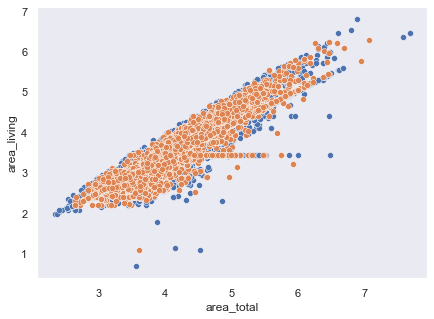

In [27]:
plt.figure(figsize=(7, 5))
sns.scatterplot(data=df_train, x="area_total", y="area_living")
sns.scatterplot(data=df_test, x="area_total", y="area_living")
plt.show()

**Now that is better**: now we can move on to filling the nans of area-living, based on its correlation to area_total, which is without nans.

In [9]:
# A function that fits a linear regression between features, and uses it to fill nans
from sklearn.linear_model import LinearRegression
def fillnaReg(df, X_features, y_feature):
    df = df.copy()
    df_temp = df[df[y_feature].notna()]
    if df_temp.shape[0] == 1: df_temp = df_temp.values.reshape(-1, 1)
    reg = LinearRegression().fit(df_temp[X_features], df_temp[y_feature])
    predict = reg.predict(df[X_features])
    df[y_feature] = np.where(df[y_feature]>0, df[y_feature], predict)
    return df

In [29]:
df_train = fillnaReg(df_train, ['area_total'], 'area_living')
df_test = fillnaReg(df_test, ['area_total'], 'area_living')

In [30]:
display(df_train["area_living"].isna().sum())
display(df_test["area_living"].isna().sum())

0

0

**Area_kitchen** is also heavily correlated to both area_total (0.5) and area_living (0.4) (from correlation plot).

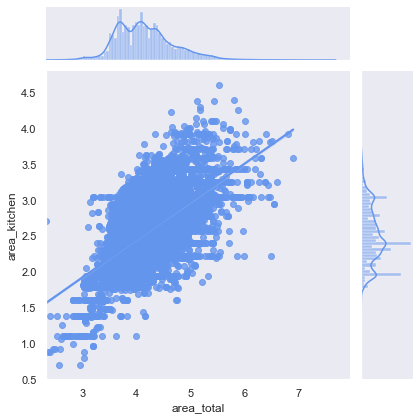

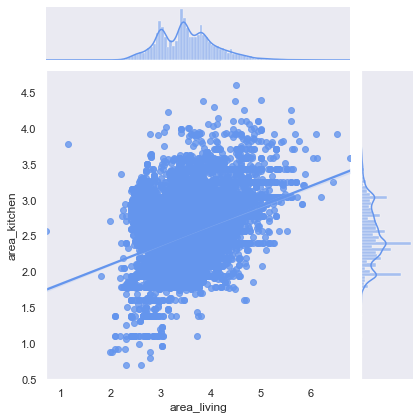

In [31]:
sns.jointplot(x=df_train.loc[:,'area_total'], y=df_train.loc[:,'area_kitchen'], ax=ax1, kind="reg", color="#6495ED")
sns.jointplot(x=df_train.loc[:,'area_living'], y=df_train.loc[:,'area_kitchen'], ax=ax2, kind="reg", color="#6495ED")

*but* we dont see the same strong correlation as we saw between the `area_total` and `area_living`. What about all three at the same time?

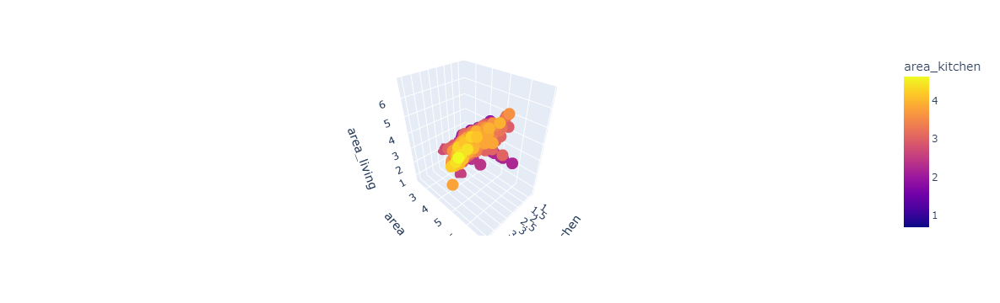

In [32]:
fig = px.scatter_3d(df_train, x='area_kitchen', y='area_total', z='area_living',
              color='area_kitchen')
fig.show()

We can clearly see that all the three features are located on the **same plane**. We can then deduce the missing values of the feature `area_kitchen` with the values of the features `area_total` and `area_living`, using the same fillnaReg() function from earlier

In [33]:
df_train = fillnaReg(df_train, ['area_total', 'area_living'], 'area_kitchen')
df_test = fillnaReg(df_test, ['area_total', 'area_living'], 'area_kitchen')

In [34]:
display(df_train["area_kitchen"].isna().sum())
display(df_test["area_kitchen"].isna().sum())

0

0

#### Apartments position and price
Let's take a closer look at the longitude and latitude data. There are obviously some apartments of the testing data, that are not positioned placed in Moscow at all. We will not be able to drop them from the dataset, but we will see if we can do something about them.

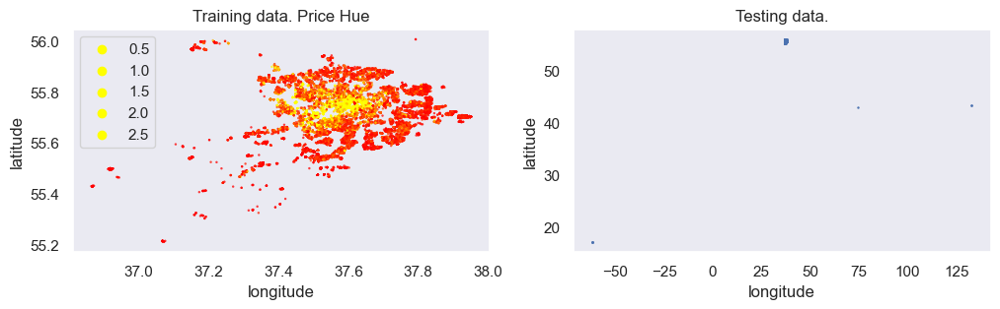

In [35]:
fig, (ax1, ax2) = plt.subplots(figsize=(12, 3), ncols=2, dpi=100)
lo, hi = df_train["price"].quantile([0.1, 0.8])
hue_norm = plt.Normalize(lo, hi)
hue = df_train["price"].tolist()

ax1.set_title("Training data. Price Hue")
ax2.set_title("Testing data.")
sns.scatterplot(x='longitude', y='latitude', ax=ax1, hue=hue, alpha=0.75, s=3, palette="autumn", linewidth=0, hue_norm=hue_norm, data=df_train[['latitude', 'longitude']])
sns.scatterplot(x='longitude', y='latitude', ax=ax2, alpha=1, s=3, palette="autumn", linewidth=0, data=df_test[['latitude', 'longitude']]);

#### Let us clean up the testing data: longitude and lattitude
*WE can start* by moving the homes off the north pole, atlantic ocean, baltic ocean, and back to Moscow.

In [36]:
# Find houses on the north pole
is_outlier = (df_test["longitude"] > 39) | (df_test["longitude"] < 35)
outliers = df_test.copy()[is_outlier]
outliers[["longitude", "latitude", "district", "street"]]

,longitude,latitude,district,street
7010,-61.790500,17.141734,NaN,Бунинские Луга ЖК
7011,-61.790500,17.141734,NaN,Бунинские Луга ЖК
7033,74.517184,42.914700,NaN,улица 1-я Линия
8320,132.768097,43.353545,NaN,улица Центральная
8518,-61.790500,17.141734,NaN,Бунинские Луга ЖК
8519,-61.790500,17.141734,NaN,Бунинские Луга ЖК
9867,132.759204,43.352968,NaN,улица Центральная


We cannot use the district information to replace these building, and have to rely on using the street names instead. Using **Google maps** we see that both `Бунинские Луга ЖК` (37.482297, 55.543673) and `улица Центральная` (37.640383, 55.566131) are streets in Moscow, but not `улица 1-я Линия`, which indeed seems misplaced. We will fill in the long/lats, and also fix the street which is misplaced.

In [37]:
# Find the most popular street
df_test.street.value_counts().head(1)

Ленинский проспект    201
Name: street, dtype: int64

In [38]:
for index in outliers.index:
    if df_test.loc[index,['street']][0]=="Бунинские Луга ЖК":
        print("Бунинские Луга ЖК")
        df_test.loc[index,['longitude']] = 37.482297
        df_test.loc[index,['latitude']] = 55.543673
    elif df_test.loc[index,['street']][0]=="улица Центральная":
        print("улица Центральная")
        df_test.loc[index,['longitude']] = 37.640383
        df_test.loc[index,['latitude']] = 55.566131
    else:
        df_test.loc[index,['longitude']] = df_train["longitude"].mean()
        df_test.loc[index,['latitude']] = df_train["latitude"].mean()
        df_test.loc[index,['street']] = "Ленинский проспект"

Бунинские Луга ЖК
Бунинские Луга ЖК
улица Центральная
Бунинские Луга ЖК
Бунинские Луга ЖК
улица Центральная


In [39]:
df_test.loc[outliers.index,["longitude", "latitude", "district", "street"]]

,longitude,latitude,district,street
7010,37.482297,55.543673,NaN,Бунинские Луга ЖК
7011,37.482297,55.543673,NaN,Бунинские Луга ЖК
7033,37.583425,55.728337,NaN,Ленинский проспект
8320,37.640383,55.566131,NaN,улица Центральная
8518,37.482297,55.543673,NaN,Бунинские Луга ЖК
8519,37.482297,55.543673,NaN,Бунинские Луга ЖК
9867,37.640383,55.566131,NaN,улица Центральная


**Now that is more realistic**, before moving on however, we need to fill some nan values in long/lat

In [40]:
display(df_test[["longitude", "latitude"]].isna().sum())
display(df_train[["longitude", "latitude"]].isna().sum())

longitude    2
latitude     2
dtype: int64

longitude    0
latitude     0
dtype: int64

In [41]:
is_na = (df_test["longitude"].isna())
nas = df_test.copy()[is_na]
nas[["longitude", "latitude", "district", "street"]]

,longitude,latitude,district,street
220,NaN,NaN,NaN,пос. Коммунарка
221,NaN,NaN,NaN,пос. Коммунарка


**Again** this is a Moscow street with a known location: (37.470959, 55.570540)

In [42]:
df_test.loc[nas.index,['longitude']] = 37.470959
df_test.loc[nas.index,['latitude']] = 55.570540

In [43]:
df_test.loc[nas.index,["longitude", "latitude", "district", "street"]]

,longitude,latitude,district,street
220,37.470959,55.57054,NaN,пос. Коммунарка
221,37.470959,55.57054,NaN,пос. Коммунарка


**Let us now go back to the city-plot** and see if it has improved:

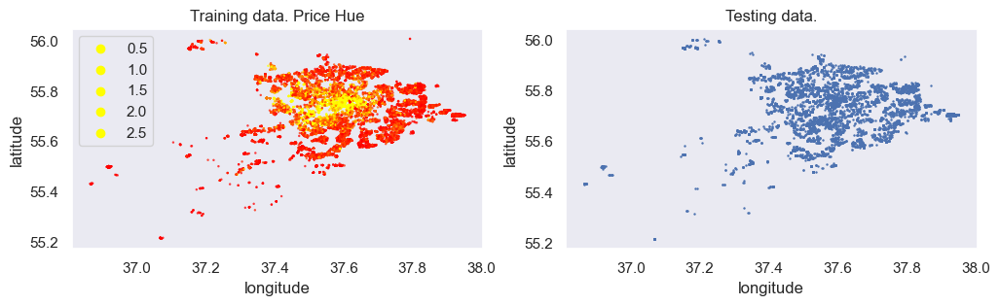

In [44]:
fig, (ax1, ax2) = plt.subplots(figsize=(12, 3), ncols=2, dpi=100)
lo, hi = df_train["price"].quantile([0.1, 0.8])
hue_norm = plt.Normalize(lo, hi)
hue = df_train["price"].tolist()

ax1.set_title("Training data. Price Hue")
ax2.set_title("Testing data.")
sns.scatterplot(x='longitude', y='latitude', ax=ax1, hue=hue, alpha=0.75, s=3, palette="autumn", linewidth=0, hue_norm=hue_norm, data=df_train[['latitude', 'longitude']])
sns.scatterplot(x='longitude', y='latitude', ax=ax2, alpha=1, s=3, palette="autumn", linewidth=0, data=df_test[['latitude', 'longitude']]);

**It really has improved!** - Now it is easier to see that the distribution between the two is pretty similar, and in the same area.

#### District nans
These nans can be eaily be filled using long/lat data from the row. We calculate the mean long, lat for each district and for each nan value in district we place it in the **closest one**.

In [45]:
print(df_test["district"].isna().sum())
print(df_train["district"].isna().sum())

25
130


In [11]:
import math
def closest_district(lat, long, district_centre_long, district_centre_lat):
    best_distance = -1
    closest_dist = -1
    for i in range(len(district_centre_long)):
        long_dist =  district_centre_long[i][0]
        lat_dist = district_centre_lat[i][0]
        total_dist = np.sqrt((long-long_dist)**2 + (lat-lat_dist)**2)
        if total_dist < best_distance or best_distance==-1:
            best_distance = total_dist
            closest_dist = i
    return closest_dist

In [47]:
# Fill districts using long/lat
district_centre_long = np.array(df_train[["district", "longitude"]].groupby(['district']).mean())
district_centre_lat = np.array(df_train[["district", "latitude"]].groupby(['district']).mean())

remove_nan_districts = [closest_district(row["latitude"],
 row["longitude"], district_centre_long, district_centre_lat) if math.isnan(row["district"]) else row["district"] for _, row in df_train.iterrows()] 
df_train["district"] = remove_nan_districts

remove_nan_districts = [closest_district(row["latitude"],
 row["longitude"], district_centre_long, district_centre_lat) if math.isnan(row["district"]) else row["district"] for _, row in df_test.iterrows()] 
df_test["district"] = remove_nan_districts

In [48]:
print(df_test["district"].isna().sum())
print(df_train["district"].isna().sum())

0
0


#### Ceiling feature
So, while plotting the histogram for ceiling we got a bit nervous. Lets look more closely at it.

Max values of each 340.0 350.0
Min values of each 0.0 0.0


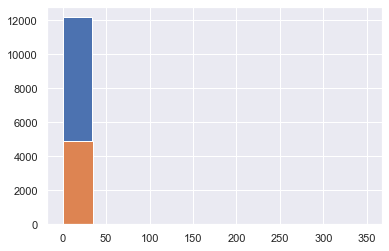

In [49]:
df_train["ceiling"].hist()
df_test["ceiling"].hist()
print("Max values of each", df_train["ceiling"].max(), df_test["ceiling"].max())
print("Min values of each", df_train["ceiling"].min(), df_test["ceiling"].min())

**Two problems:**
- We have a few massive roofs! Need to move these down to the average level.
- We have some 0-height ceilings, that is not realistic, and we also need to move these.

Lets look at **correlation to price**, before and after doing this fix: Before the correlation is only 0.052

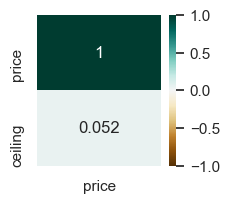

In [50]:
f, ax = plt.subplots(figsize=(2, 2), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train[["ceiling"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

We replace the obvious otlayers, with the mean value from the non-outlayer data

In [51]:
is_outlier = ((df_train["ceiling"] > 10) | (df_train["ceiling"] < 0.5)) # No roofs should be more than 10 meters, or below 0.5 meters. roughly.
outliers = df_train.copy()[is_outlier]
inliers_index=[]
for index in df_train.index:
    if index not in outliers.index:
        inliers_index.append(index)
df_train.loc[outliers.index,['ceiling']] = df_train.loc[inliers_index,['ceiling']].mean()

is_outlier = ((df_test["ceiling"] > 10) | (df_test["ceiling"] < 0.5))
outliers = df_test.copy()[is_outlier]
for index in df_test.index:
    if index not in outliers.index:
        inliers_index.append(index)
df_test.loc[outliers.index,['ceiling']] = df_test.loc[df_test.index.intersection(inliers_index),['ceiling']].mean()

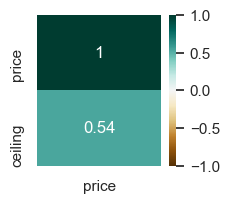

In [52]:
f, ax = plt.subplots(figsize=(2, 2), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train[["ceiling"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**Now that is a big improvement** in correlation! From being a useless feature, to being quite relevant in 1-2-3

Max values of each 8.0 7.0
Min values of each 1.65 1.7


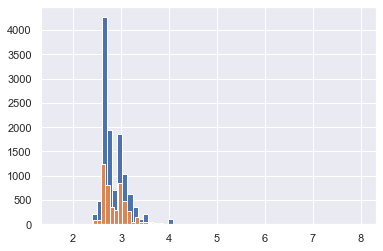

In [53]:
df_train["ceiling"].hist(bins=60)
df_test["ceiling"].hist(bins=60)
print("Max values of each", df_train["ceiling"].max(), df_test["ceiling"].max())
print("Min values of each", df_train["ceiling"].min(), df_test["ceiling"].min())

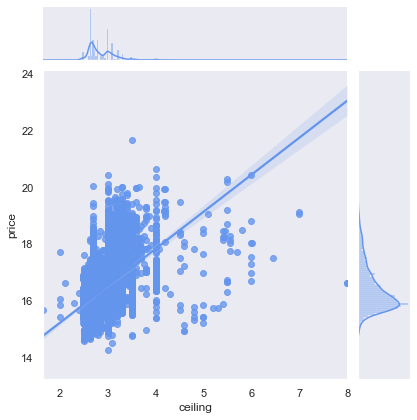

In [54]:
sns.jointplot(x=df_train.loc[:,'ceiling'], y=logged_price, kind="reg", color="#6495ED");

#### Categorical features, filling nans
This is all the non-ordinal categorical features in our data: ["layout", "condition", "district", "material", "parking", "heating", "seller"]. We have already filled the nans that existed in `district`, but for the rest there still remains nans. Let us look at the histogram for these features once more:


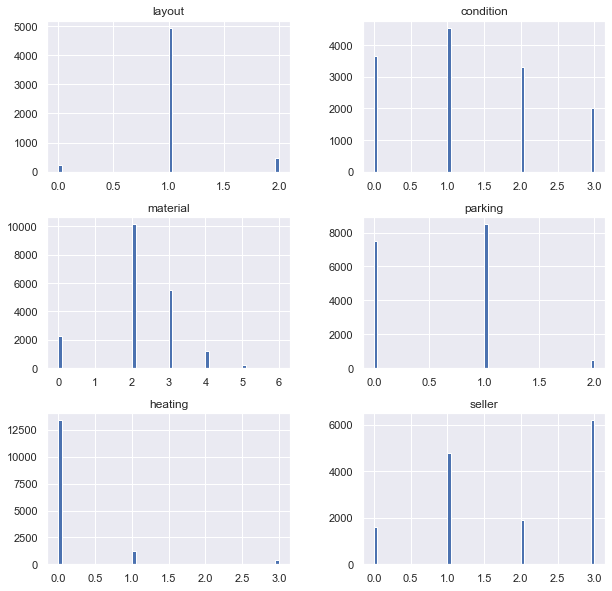

In [55]:
df_train[["layout", "condition", "material", "parking", "heating", "seller"]].hist(bins=60, figsize=(10, 10));

We see that for most categorical data, it is one or two values that dominate the rest in frequency. So for these categorical datas the best approach is probably to fill nans with median/mode, as this will be a pretty safe bet. But first lets look at the correlation, and see if we find a better approach.

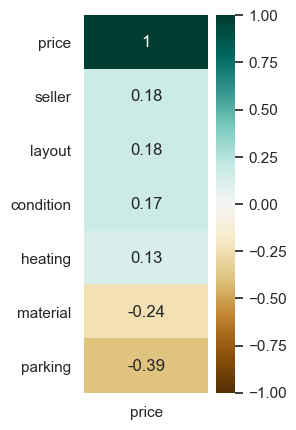

In [56]:
f, ax = plt.subplots(figsize=(2, 5), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train[["layout", "condition", "material", "parking", "heating", "seller"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**Let us conduct an experiment**: what if we fill the nans with a new "unknown category", will this increase the correlation to price?

In [57]:
df_train_copy = df_train.copy()
df_test_copy = df_test.copy()

In [58]:
for feature in ["layout", "condition", "material", "parking", "heating", "seller"]:
    unknown_category = len(list(df_train_copy[feature].unique())) - 1
    df_train_copy[feature] = df_train_copy[feature].fillna(unknown_category)
    df_test_copy[feature] = df_test_copy[feature].fillna(unknown_category)

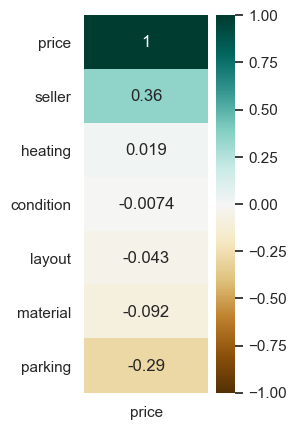

In [59]:
f, ax = plt.subplots(figsize=(2, 5), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train_copy[["layout", "condition", "material", "parking", "heating", "seller"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**Interesting!** Only the `seller` becomes more correlated with price adding the unknown category: what does this mean?
> It could mean that `seller` actually has one, or several more unknow categories that is not included in this dataset, so adding this extra category we added represents these extra categories.

> On the other hand, the other categorical data doesnt have any hidden categories, and what we need to do her is just to fill with median() values.

In [60]:
# Add unknown category to seller.
unknown_category = len(list(df_train["seller"].unique())) - 1
df_train[feature] = df_train["seller"].fillna(unknown_category)
df_test[feature] = df_test["seller"].fillna(unknown_category)

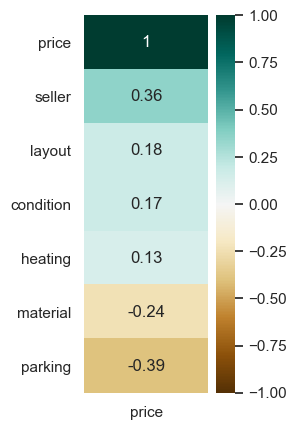

In [61]:
f, ax = plt.subplots(figsize=(2, 5), dpi=100)
heatmap = sns.heatmap(pd.merge(df_train[["layout", "condition", "material", "parking", "heating", "seller"]], logged_price, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

#### People living above their buildings
The `stories` data shows how many stories the building has, while `floor` tells us about what floor the apartment is on. Knowing this, floor should never be more than stories. 

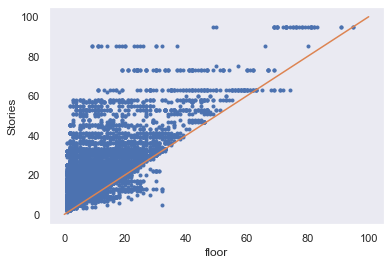

In [62]:
x = np.linspace(0, 100, 100)
y = np.linspace(0, 100, 100)
plt.plot(df_train["floor"], df_train["stories"], ".")
plt.xlabel("floor")
plt.ylabel("Stories")
plt.plot(x, y)
plt.show()

In [63]:
len(df_train[df_train["floor"]>df_train["stories"]])

321

This could either be from something wrong in the building data, being the wrong floor count - or it could be something wrong in the apartments floor count - or it could be something wrong in the apartment_id, linking the two datasets together.

### Extra visualization

Visualizing data is a good way to be inspired for the following feature engineering. Therefor we also developed the following two maps to allow us to interactively play with the location and price of the appartments.

In [64]:
import xyzservices.providers as xyz
from bokeh.plotting import figure, show, output_notebook, ColumnDataSource
from bokeh.tile_providers import CARTODBPOSITRON, get_provider, STAMEN_TERRAIN
from bokeh.models import ColorBar, Select
from bokeh.palettes import Turbo256
from bokeh.transform import linear_cmap, log_cmap
from bokeh.models.widgets import Slider
from bokeh.layouts import row, column

In [65]:
#Establishes color palette and data source.
pal= Turbo256

source = ColumnDataSource(data=df_train[['apartment_id', 'price', 'latitude', 'longitude']])

#Establishes color mapper gradient, hover information, and slider widget.
mapper = log_cmap(field_name = "price", palette = pal, low=min(df_train.price), high=max(df_train.price))
tooltips = [("Price","@price")]

#Defines scatter plot attributes and add map tile. Implement colors and data points.
fig = figure(x_axis_type = 'mercator', y_axis_type = 'mercator', tooltips = tooltips, title = 'Moscow Residential Housing Prices')
fig.add_tile(get_provider(STAMEN_TERRAIN))
fig.circle(x = 'longitude', y = 'latitude', line_color = mapper,color=mapper, source=source)

#Defines color bar attributes and location
color_bar = ColorBar(color_mapper=mapper['transform'], width=8, location=(0,0))
fig.add_layout(color_bar, 'right')

#Defines layout of graph and widgets
layout = column(fig)

#Calls figure
show(layout)

Run the code above to have the first map open in a new browser window.

In [2]:
import folium
import math

from folium import Choropleth, Circle, Marker
from folium.plugins import HeatMap, MarkerCluster

In [5]:
def preprocess(df) :
    df = df[['district','latitude','longitude','price']]
    df = df.replace('NA', np.nan)
    df.dropna(subset=['latitude'], inplace=True)
    df.dropna(subset=['price'], inplace=True)
    df["latitude"] = df["latitude"].astype(float)
    df["longitude"] = df["longitude"].astype(float)
    return df

map1_df = preprocess(df_train)

city_map = folium.Map(location=[55.75,37.62], zoom_start=11.2, tiles='Stamen Terrain')
mc = MarkerCluster()
for idx, row in map1_df.iterrows():
    if not math.isnan(row['longitude']) and not math.isnan(row['latitude']):
        popup = """
        District : <b>%s</b><br>
        Price : <b>%s</b><br>
        """ % (row['district'], row['price'])
        mc.add_child(Marker([row['latitude'], row['longitude']],tooltip=popup))
    city_map.add_child(mc)
city_map

#### Comparing Training and Testing Data
We wanted to check a bit further how (dis)similar the train and test datasets are. 
It is easy to plot the distribution of training and testing set against each other using the code below.

In [136]:
x = df_train.drop(['price'],axis=1)
y = df_train['price']
test = df_test

train_true = [1]*len(x.index)
train_false = [0]*len(test.index)

x['train'] = train_true
test['train'] = train_false
concatenated = pd.concat([x,test], sort=False)
concatenated.drop(['street','address'],axis=1,inplace=True)
for column in concatenated.drop(['train'],axis=1).columns:
    # remove kind="kde" to obtain barplots
    sns.displot(concatenated, x=(concatenated[column]), hue="train", kind="kde", fill=True)

We further need to check whether there are id's or categories that do not overlap in the training or testing dataset.

In [68]:
features_to_check = ["apartment_id","building_id","layout", "condition", "district", "material", "parking", "heating", "seller"]

def intersection(lst1, lst2):
    temp = set(lst2)
    lst3 = [value for value in lst1 if value in temp]
    return set(lst3)

for feature in features_to_check:
    n_intersections = len(intersection(list(df_test[feature]),list(df_train[feature])))
    if n_intersections == 0:
        print (feature, " has no overlapping values")
    test_unique = df_test[feature].unique()
    train_unique = df_train[feature].unique()
    only_test = list(set(test_unique).difference(train_unique))
    only_train = list(set(train_unique).difference(test_unique))
    if len(only_test) != 0 and feature not in ['apartment_id','building_id']:
        print("Current feature: ", feature)
        print("These values occur only in the test set: ", only_test)
    if len(only_train) != 0 and feature not in ['apartment_id','building_id']:
        print("Current feature: ", feature)
        print("These values occur only in the train set: ", only_train)

apartment_id  has no overlapping values
building_id  has no overlapping values
Current feature:  layout
These values occur only in the test set:  [nan]
Current feature:  layout
These values occur only in the train set:  [nan]
Current feature:  condition
These values occur only in the test set:  [nan]
Current feature:  condition
These values occur only in the train set:  [nan]
Current feature:  material
These values occur only in the test set:  [nan]
Current feature:  material
These values occur only in the train set:  [nan]
Current feature:  parking
These values occur only in the test set:  [nan]
Current feature:  parking
These values occur only in the train set:  [nan]
Current feature:  heating
These values occur only in the test set:  [nan]
Current feature:  heating
These values occur only in the train set:  [nan]


We can see that there is no overlap in the id's of the data. Also visible is that all categories exist in both train and test dataset *except* that the test set contains NaN values for all categorical values, whereas the training set does not have this problem.

#### Categorical Features
Also interesting is how the price behaves compared to the categorical values.

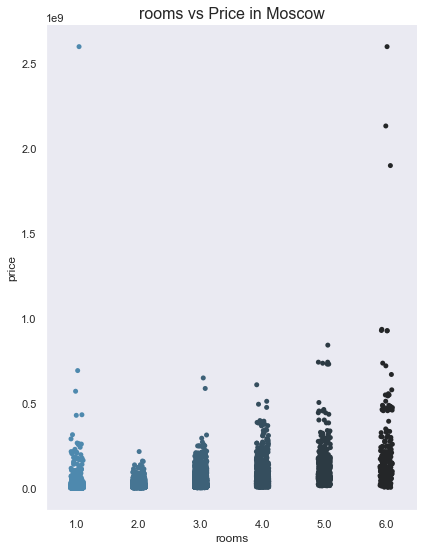

In [69]:
def cat_plot(data,xlabel,p):
    sns.catplot(x=xlabel, y="price", data=data,palette = p)
    plt.title(xlabel + ' vs Price in Moscow',size=16)
    plt.gcf().set_size_inches(6,8)
    plt.show()
    
custom_colors = ["#4e89ae", "#c56183","#ed6663","#ffa372"]
customPalette = sns.set_palette(sns.color_palette(custom_colors))
moscow = sns.dark_palette(custom_colors[0], reverse=True)
cat_plot(df_train,'rooms',moscow)

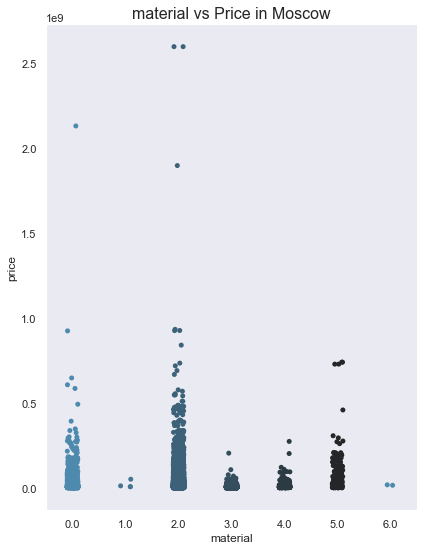

In [70]:
cat_plot(df_train,'material',moscow)
materials_legend = {0:"Bricks", 1:"Wood", 2:"Monolith", 3:"Panel", 4:"Block", 5:"Monolithic_brick", 6:"Stalin_project"}

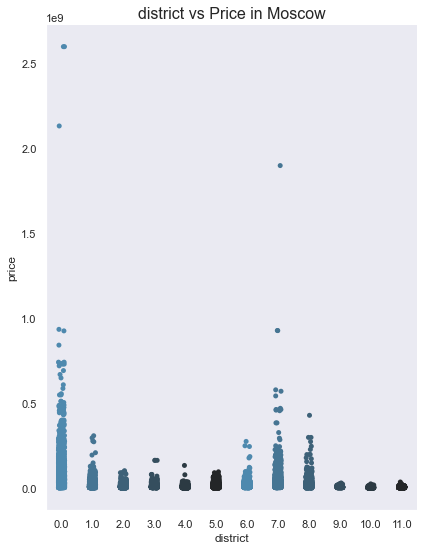

In [71]:
cat_plot(df_train,'district',moscow)
materials_legend = {0:"Central", 1:"North", 2:"North-East", 3:"East", 4:"South-East", 5:"South", 6:"South-West", 7:"West", 8:"North-West", 9:"Zelenograd", 10:"Troitsk", 11:"Novomoskovsk"}

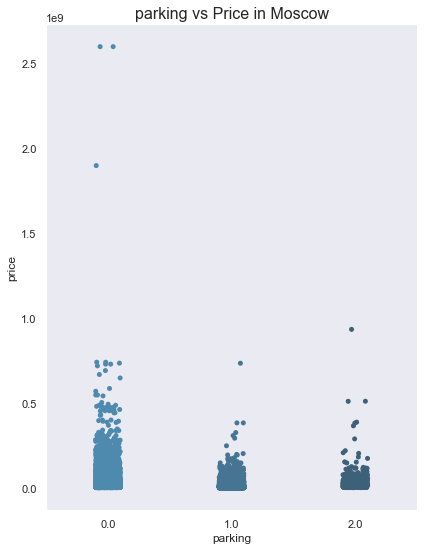

In [72]:
cat_plot(df_train,'parking',moscow)
materials_legend = {0:"Ground", 1:"Underground", 2:"Multilevel"}

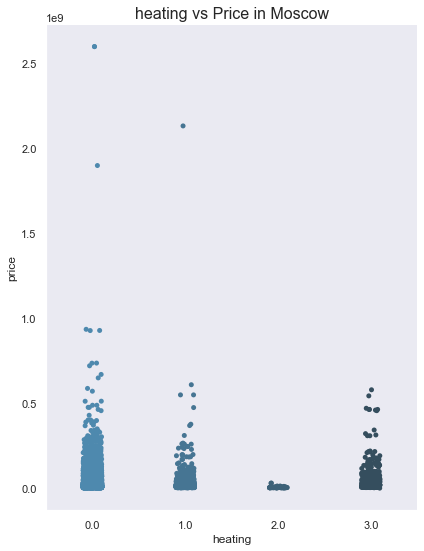

In [73]:
cat_plot(df_train,'heating',moscow)
materials_legend = {0:"Central", 1:"Individual", 2:"Boiler", 3:"Autonomous_boiler"}

We can further check if there is a big difference in new and old properties per district. It seems that most districts offer (much) more old than new appartments, except for district 11.

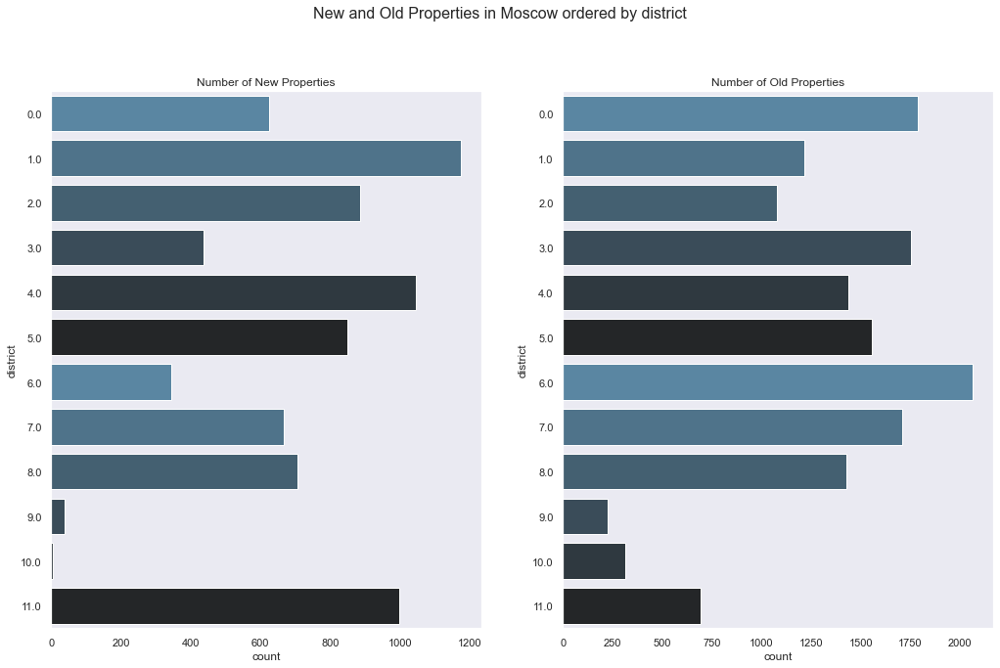

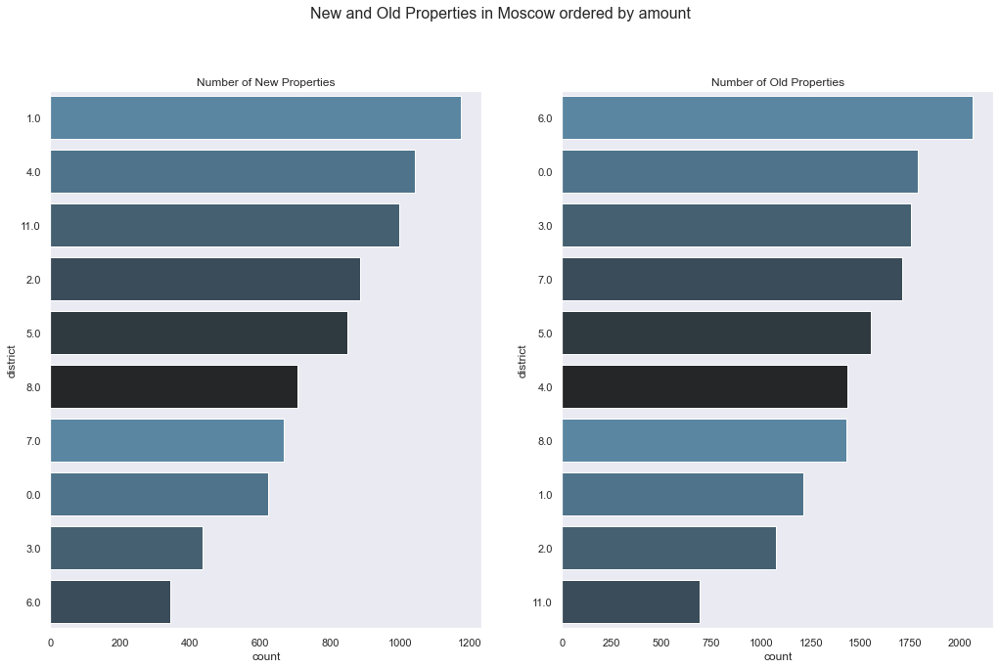

In [74]:
def count_plot(data,title,p):
    df5=data[data['new']== 1]
    df6=data[data['new']== 0]
    fig, ax = plt.subplots(1,2,figsize=(15, 10))
    ax[0]=sns.countplot(y='district', data=df5, ax=ax[0],palette = p)
    ax[0].set_title('Number of New Properties')
    ax[1]=sns.countplot(y='district', data=df6, ax=ax[1],palette = p)
    ax[1].set_title('Number of Old Properties')   
    
    fig.suptitle(title, fontsize=16)
    plt.tight_layout(pad=3.0)
    plt.show()
    
def count_plot_ordered(data,title,p):
    df5=data[data['new']== 1]
    df6=data[data['new']== 0]
    fig, ax = plt.subplots(1,2,figsize=(15, 10))
    ax[0]=sns.countplot(y='district', data=df5, order=df5.district.value_counts().index[:10], ax=ax[0],palette = p)
    ax[0].set_title('Number of New Properties')
    ax[1]=sns.countplot(y='district', data=df6, order=df6.district.value_counts().index[:10], ax=ax[1],palette = p)
    ax[1].set_title('Number of Old Properties')   
    
    fig.suptitle(title, fontsize=16)
    plt.tight_layout(pad=3.0)
    plt.show()
    
count_plot(df_train,'New and Old Properties in Moscow ordered by district',moscow)
count_plot_ordered(df_train,'New and Old Properties in Moscow ordered by amount',moscow)

### Missing values
In the cleaning process seen above, we already removed NaNs from some features, but we need to handle all NaNs before training on models. (XGB models can actually handle NaNs themselves, but most cannot).

Training set features with any missing value: 19/34
Testing set features with any missing value: 19/33
Features with no missing values: ['apartment_id', 'seller', 'price', 'area_total', 'area_kitchen', 'area_living', 'floor', 'rooms', 'building_id', 'latitude', 'longitude', 'district', 'street', 'address', 'stories']


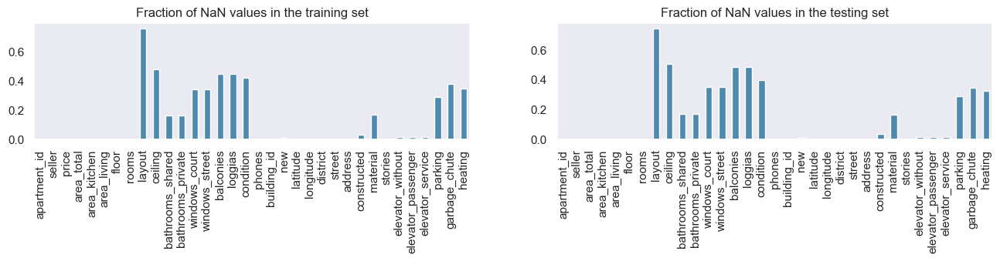

In [76]:
fig, (ax1, ax2) = plt.subplots(figsize=(16, 2), ncols=2, dpi=100)
print(f'Training set features with any missing value: {df_train.isna().any().sum()}/{df_train.shape[1]}')
print(f'Testing set features with any missing value: {df_test.isna().any().sum()}/{df_test.shape[1]}')
df_train.isna().mean().plot.bar(ax=ax1, title='Fraction of NaN values in the training set')
df_test.isna().mean().plot.bar(ax=ax2, title='Fraction of NaN values in the testing set');

featuresNA = dict(df_train.isna().any())
featuresNoNA = []
for key in featuresNA.keys():
    if not featuresNA[key] : featuresNoNA.append(key)
print('Features with no missing values:', featuresNoNA)

#### Other missing values

We still have a lot of columns with missing values in them. For the rest of the missing values, we decided to use the mean to fill the float numerical features and to use the median for all the other types of features. 

In [77]:
float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"] # Float values.
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories/integers
cat_features = ["layout", "condition", "district", "material", "parking", "heating"] # All are non-ordinal categorical data

# Float
df_train[float_numerical_features] = df_train[float_numerical_features].fillna(df_train[float_numerical_features].mean())
df_test[float_numerical_features] = df_test[float_numerical_features].fillna(df_test[float_numerical_features].mean())
# Int
df_train[int_numerical_features] = df_train[int_numerical_features].fillna(df_train[int_numerical_features].median())
df_test[int_numerical_features] = df_test[int_numerical_features].fillna(df_test[int_numerical_features].median())
# Cat
df_train[cat_features] = df_train[cat_features].fillna(df_train[cat_features].median())
df_test[cat_features] = df_test[cat_features].fillna(df_test[cat_features].median())
# Bool (The rest)
df_train = df_train.fillna(df_train.median()) 
df_test = df_train.fillna(df_test.median()) 

Let's check that all NaN values are gone.

Training set features with any missing value: 0/34
Testing set features with any missing value: 0/34
Features with no missing values: ['apartment_id', 'seller', 'price', 'area_total', 'area_kitchen', 'area_living', 'floor', 'rooms', 'layout', 'ceiling', 'bathrooms_shared', 'bathrooms_private', 'windows_court', 'windows_street', 'balconies', 'loggias', 'condition', 'phones', 'building_id', 'new', 'latitude', 'longitude', 'district', 'street', 'address', 'constructed', 'material', 'stories', 'elevator_without', 'elevator_passenger', 'elevator_service', 'parking', 'garbage_chute', 'heating']


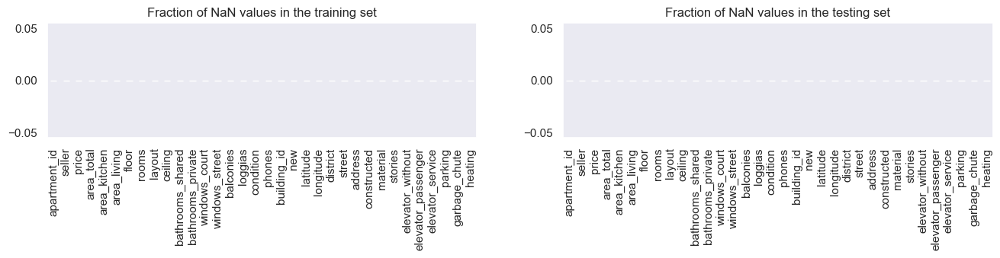

In [78]:
fig, (ax1, ax2) = plt.subplots(figsize=(16, 2), ncols=2, dpi=100)
print(f'Training set features with any missing value: {df_train.isna().any().sum()}/{df_train.shape[1]}')
print(f'Testing set features with any missing value: {df_test.isna().any().sum()}/{df_test.shape[1]}')
df_train.isna().mean().plot.bar(ax=ax1, title='Fraction of NaN values in the training set')
df_test.isna().mean().plot.bar(ax=ax2, title='Fraction of NaN values in the testing set');

featuresNA = dict(df_train.isna().any())
featuresNoNA = []
for key in featuresNA.keys():
    if not featuresNA[key] : featuresNoNA.append(key)
print('Features with no missing values:', featuresNoNA)

## Feature engineering
Now the basic cleaning and exploration is over. It is time to engineer our own data, and to introduce external data that might help.

#### Exploring Feature Correlation

Since feature correlation is a simple way of discovering linear relationships between the features themselves and the features and the target, checking the correlations is both a simple and important step in analyzing the data. Immediately is that some values are heavily correlated. It is important to be aware of this, since correlated features sometimes prevent models from learning their relationship with the target.

Text(0.5, 1.0, 'Correlations all data')

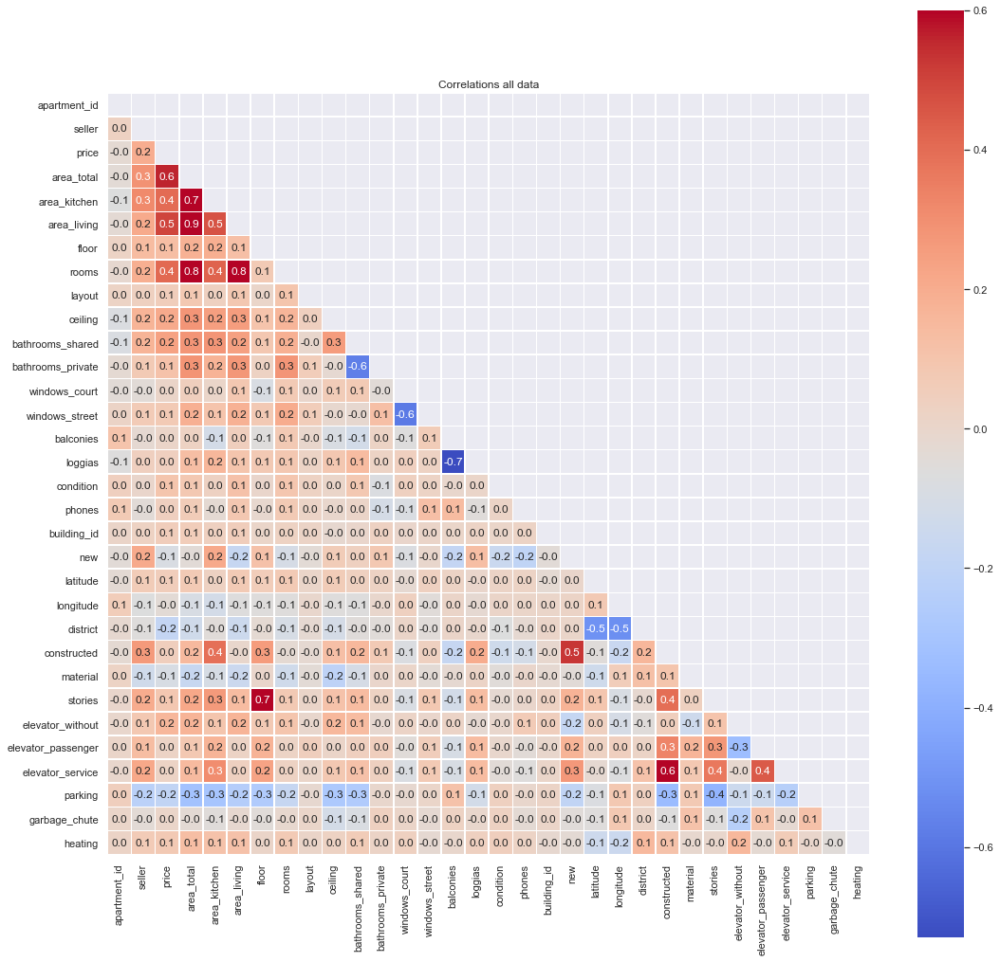

In [79]:
corr = df_train.corr()
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True

f,ax = plt.subplots(figsize=(18, 18))
sns.heatmap(df_train.corr(), mask=mask, vmax=0.6, square=True, cmap='coolwarm', annot=True, linewidths=.5, fmt= '.1f',ax=ax)
plt.title('Correlations all data')

Text(0.5, 1.0, 'Feature Correlation with price')

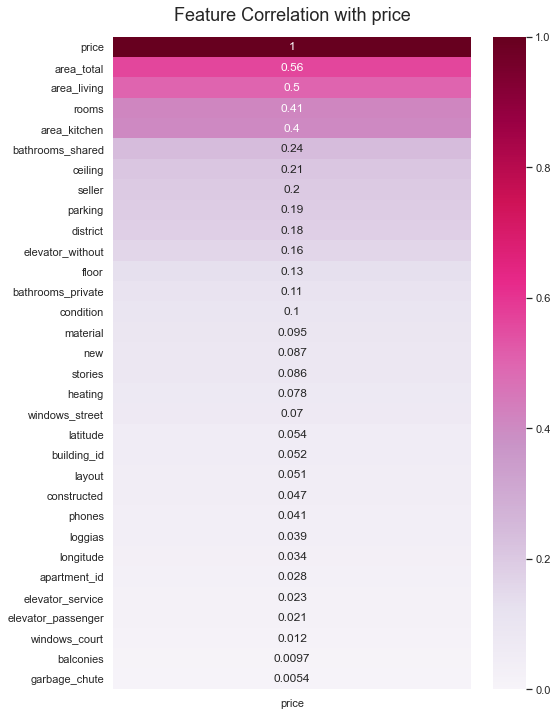

In [80]:
plt.figure(figsize=(8, 12))
heatmap = sns.heatmap(abs(df_train.corr()[['price']]).sort_values(by='price', ascending=False), vmin=0, vmax=1, annot=True, cmap='PuRd')
heatmap.set_title('Feature Correlation with price', fontdict={'fontsize':18}, pad=16)

**Initial thoughts about the feature importance**

The features `area_total` and `rooms` had no missing values in them and correlate strongly with the price. These will thus be some the main features. ( `area_living` and `area_kitchen` are very correlated to `area_total` so they may not be very useful). These features can however become very dominating in the training, limiting how accurate our models can become, because the models become too reliant on these features. 

A possible workaround is to train the model on predicting price/area instead of price directly, and dropping area_total from training data. This strategy ended up improving the score for all our boosting models: LightGBM, GradientBoost, XGBoost and CatBoost.

### Helper functions
Before moving on, we will define some helper functions to both load and clean the data, so we can easily get the results shown above.

In [6]:
def load_all_data(fraction_of_data=1, apartment_id='apartment_id',path=None):
    
    if path is not None:
        # Metadata
        metaData_apartment = pd.read_json(path+'../data/apartments_meta.json')
        metaData_building = pd.read_json(path+'../data/buildings_meta.json')
        metaData = pd.concat([metaData_apartment, metaData_building])

        # Train
        train_apartment = pd.read_csv(path+'../data/apartments_train.csv')
        train_building = pd.read_csv(path+'../data/buildings_train.csv')

        # Test
        test_apartment = pd.read_csv(path+'../data/apartments_test.csv')
        test_building = pd.read_csv(path+'../data/buildings_test.csv')
    
    else:
    # Metadata
        metaData_apartment = pd.read_json('../data/apartments_meta.json')
        metaData_building = pd.read_json('../data/buildings_meta.json')
        metaData = pd.concat([metaData_apartment, metaData_building])

        # Train
        train_apartment = pd.read_csv('../data/apartments_train.csv')
        train_building = pd.read_csv('../data/buildings_train.csv')

        # Test
        test_apartment = pd.read_csv('../data/apartments_test.csv')
        test_building = pd.read_csv('../data/buildings_test.csv')
  
    train = pd.merge(train_apartment, train_building, left_on='building_id', right_on='id')
    train.rename(columns={'id_x' : apartment_id}, inplace=True)
    train.drop('id_y', axis=1, inplace=True)
    train = train.head(int(train.shape[0] * fraction_of_data))


    test = pd.merge(test_apartment, test_building, left_on='building_id', right_on='id')
    test.rename(columns={'id_x' : apartment_id}, inplace=True)
    test.drop('id_y', axis=1, inplace=True)

    return train, test, metaData

In [7]:
def clean_data(train, test,
                 features, float_numerical_features, int_numerical_features, cat_features,
                 log_targets=True, log_area=True, fillNan=True, log1_area=False, log1_targets=False):
    '''Clean the data according to best knowledge so far...
   
    '''



    # Extract
    train_labels = train[features]
    test_labels = test[features]
    train_targets = train['price']

    # Log targets
    if log_targets:
        train_targets = np.log(train_targets)
    elif log1_targets:
        print("log1p targets!")
        train_targets = np.log1p(train_targets)

    ## ------------------------------------------------------------------------------------------------ ##
    # TODO: Shoul we use thise at all?
    # Fill nans using correlated features
    train_labels = fillnaReg(train_labels, ['area_total'], 'area_living')
    test_labels = fillnaReg(test_labels, ['area_total'], 'area_living')
    # Area_kitchen
    train_labels = fillnaReg(train_labels, ['area_total', 'area_living'], 'area_kitchen')
    test_labels = fillnaReg(test_labels, ['area_total', 'area_living'], 'area_kitchen')
    # ceiling
    is_outlier = ((train_labels["ceiling"] > 10) | (train_labels["ceiling"] < 0.5))
    outliers = train_labels.copy()[is_outlier]
    inliers_index=[]
    for index in train_labels.index:
        if index not in outliers.index:
            inliers_index.append(index)
    train_labels.loc[outliers.index,['ceiling']] = train_labels.loc[inliers_index,['ceiling']].mean()

    is_outlier = ((test_labels["ceiling"] > 10) | (test_labels["ceiling"] < 0.5))
    outliers = test_labels.copy()[is_outlier]
    for index in test_labels.index:
        if index not in outliers.index:
            inliers_index.append(index)
    test_labels.loc[outliers.index,['ceiling']] = test_labels.loc[test_labels.index.intersection(inliers_index),['ceiling']].mean()

    ## ------------------------------------------------------------------------------------------------ ##

    # Remove zero area living
    # TODO: why not > 0?
    remove_zero = [row["area_living"] if row["area_living"] >= 1 else row["area_total"]*(train_labels["area_living"].mean() / train_labels["area_total"].mean()) for _, row in train_labels.iterrows()] 
    train_labels["area_living"] = remove_zero

    remove_zero = [row["area_living"] if row["area_living"] >= 1 else row["area_total"]*(test_labels["area_living"].mean() / test_labels["area_total"].mean()) for _, row in test_labels.iterrows()] 
    test_labels["area_living"] = remove_zero

    # Log the areas
    fs = ["area_total", "area_living", "area_kitchen"]
    if log_area:
        for feature in fs:
            # Logging
            train_labels[feature] = np.log(train_labels[feature])
            test_labels[feature] = np.log(test_labels[feature])
    elif log1_area:
        print("log1p area!!")
        for feature in fs:
            # Logging
            train_labels[feature] = np.log1p(train_labels[feature])
            test_labels[feature] = np.log1p(test_labels[feature])


    # remove upper Strip
    remove_upper_stripe = [row["area_living"] if row["area_living"] < row["area_total"] else row["area_total"]*(train_labels["area_living"].mean() / train_labels["area_total"].mean()) for _, row in train_labels.iterrows()] 
    train_labels["area_living"] = remove_upper_stripe

    remove_upper_stripe = [row["area_living"] if row["area_living"] < row["area_total"] else row["area_total"]*(test_labels["area_living"].mean() / test_labels["area_total"].mean()) for _, row in test_labels.iterrows()] 
    test_labels["area_living"] = remove_upper_stripe
    ## ------------------------------------------------------------------------------------------------ ##


    # Fillnans of the two lat/log.
    # Insert median district
    #unknown_index = test_labels[["district", "latitude", "longitude"]][test_labels["latitude"].isna()==True].index
    #test_labels.loc[unknown_index,['district']] = test_labels["district"].median()
    ## Mean the long/lat
    #test_labels["longitude"] = test_labels["longitude"].fillna(test_labels["longitude"].mean())
    #test_labels["latitude"] = test_labels["latitude"].fillna(test_labels["latitude"].mean())

    # Both nans in test-data is in same known street.
    # (37.470959, 55.570540)
    is_na = (test_labels["longitude"].isna())
    nas = test_labels.copy()[is_na]
    test_labels.loc[nas.index,['longitude']] = 37.470959
    test_labels.loc[nas.index,['latitude']] = 55.570540
    

    # Fix houses on the "north pole".
    is_outlier = (test_labels["longitude"] > 39) | (test_labels["longitude"] < 35)
    outliers = test_labels.copy()[is_outlier]
    for index in outliers.index:
        if test_labels.loc[index,['street']][0]=="Бунинские Луга ЖК":
            test_labels.loc[index,['longitude']] = 37.482297
            test_labels.loc[index,['latitude']] = 55.543673
        elif test_labels.loc[index,['street']][0]=="улица Центральная":
            test_labels.loc[index,['longitude']] = 37.640383
            test_labels.loc[index,['latitude']] = 55.566131
        else:
            test_labels.loc[index,['longitude']] = train_labels["longitude"].mean()
            test_labels.loc[index,['latitude']] = train_labels["latitude"].mean()
            test_labels.loc[index,['street']] = "Ленинский проспект"

    
    # Fill districts using long/lat
    district_centre_long = np.array(train_labels[["district", "longitude"]].groupby(['district']).mean())
    district_centre_lat = np.array(train_labels[["district", "latitude"]].groupby(['district']).mean())
    remove_nan_districts = [closest_district(row["latitude"],
     row["longitude"], district_centre_long, district_centre_lat) if math.isnan(row["district"]) else row["district"] for _, row in train_labels.iterrows()] 
    train_labels["district"] = remove_nan_districts
    remove_nan_districts = [closest_district(row["latitude"],
     row["longitude"], district_centre_long, district_centre_lat) if math.isnan(row["district"]) else row["district"] for _, row in test_labels.iterrows()] 
    test_labels["district"] = remove_nan_districts

    # Fix the seller with unknown category
    unknown_category = len(list(train_labels["seller"].unique())) - 1
    train_labels["seller"] = train_labels["seller"].fillna(unknown_category)
    test_labels["seller"] = test_labels["seller"].fillna(unknown_category)
    ## --------------------------------------------------------------------------------------------------------------- ##
    if fillNan:
        # Taking care of the string features first... NB! no nans in string data.
        # Fill rest with median or mean
        # Float
        train_labels[float_numerical_features] = train_labels[float_numerical_features].fillna(train_labels[float_numerical_features].mean())
        # Int
        train_labels[int_numerical_features] = train_labels[int_numerical_features].fillna(train_labels[int_numerical_features].median())
        # Cat
        train_labels[cat_features] = train_labels[cat_features].fillna(train_labels[cat_features].median())
        # Bool (The rest)
        train_labels = train_labels.fillna(train_labels.median()) # Boolean

        # Float
        test_labels[float_numerical_features] = test_labels[float_numerical_features].fillna(test_labels[float_numerical_features].mean())
        # Int
        test_labels[int_numerical_features] = test_labels[int_numerical_features].fillna(test_labels[int_numerical_features].median())
        # Cat
        test_labels[cat_features] = test_labels[cat_features].fillna(test_labels[cat_features].median())
        # Bool (The rest)
        test_labels = test_labels.fillna(test_labels.median()) # Boolean

    if "constructed" in features:
        # Is supposed to be integer.
        train["constructed"] = np.asarray(train["constructed"]).astype("int")
        test["constructed"] = np.asarray(test["constructed"]).astype("int")

    return train_labels, train_targets, test_labels

In [12]:
# All features
features =           ["building_id", # For grouping, later on
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street", "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]

int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = []

# Load data
train, test, metaData = load_all_data()
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=True, log_area=True, fillNan=True)

#### R and Theta

Since the city of Moscow is contains a city center and the most expensive apartments are close to this center, we though it would be more representative to use r and theta (radius and angle) for the apartment position instead of latitude and longitude. We also moved the origin of latitude and longitude to the mean.  

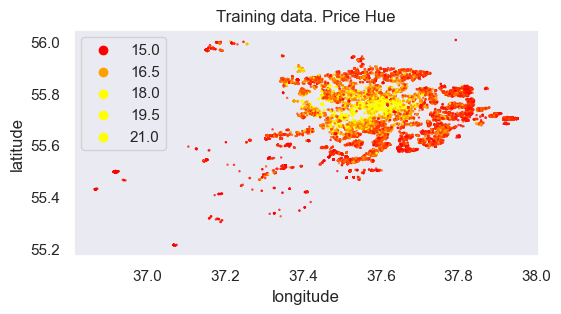

In [87]:
fig, ax1 = plt.subplots(figsize=(6, 3), dpi=100)
lo, hi = train_targets.quantile([0.1, 0.8])
hue_norm = plt.Normalize(lo, hi)
hue = train_targets.tolist()

ax1.set_title("Training data. Price Hue")
sns.scatterplot(x='longitude', y='latitude', ax=ax1, hue=hue, alpha=0.75, s=3, palette="autumn", linewidth=0, hue_norm=hue_norm, data=train_labels[['latitude', 'longitude']]);

In [88]:
#########################################################################################
# Get placeholders, so we dont ruin the original data.
labels1_normed_r = train_labels[["latitude", "longitude"]].copy()
test1_normed_r = test_labels[["latitude", "longitude"]].copy()
#########################################################################################
## Move origo to center of city.
train_float_mean = df_train["longitude"].mean()
test_float_mean = df_test["longitude"].mean()
tl = len(df_train) + len(df_test)
total_mean_long = (train_float_mean*len(df_train) + test_float_mean*len(df_test)) / tl
##
train_float_mean = df_train["latitude"].mean()
test_float_mean = df_test["latitude"].mean()
tl = len(df_train) + len(df_test)
total_mean_lat = (train_float_mean*len(df_train) + test_float_mean*len(df_test)) / tl 
##
labels1_normed_r['latitude'] = labels1_normed_r['latitude'] - total_mean_lat
labels1_normed_r['longitude'] = labels1_normed_r['longitude'] - total_mean_long
test1_normed_r['latitude'] = test1_normed_r['latitude'] -  total_mean_lat
test1_normed_r['longitude'] = test1_normed_r['longitude'] -  total_mean_long
## Convert to polar coordinates
labels1_normed_r['r'] =  np.sqrt(labels1_normed_r['latitude']**2 + labels1_normed_r['longitude']**2)
labels1_normed_r['theta'] = np.arctan(labels1_normed_r['longitude']/labels1_normed_r['latitude'])
test1_normed_r['r'] =  np.sqrt(test1_normed_r['latitude']**2 + test1_normed_r['longitude']**2)
test1_normed_r['theta'] = np.arctan(test1_normed_r['longitude']/test1_normed_r['latitude'])
#########################################################################################
# Add the polar coordinates.
train_labels["r"] = labels1_normed_r['r']
train_labels["theta"] = labels1_normed_r['theta']
test_labels["r"] = test1_normed_r['r']
test_labels["theta"] = test1_normed_r['theta']

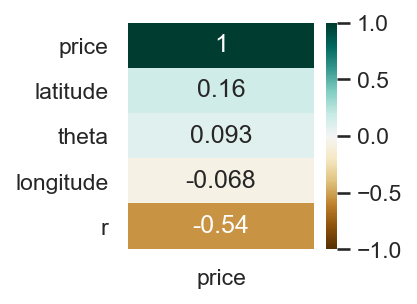

In [89]:
f, ax = plt.subplots(figsize=(2, 2), dpi=150)
heatmap = sns.heatmap(pd.merge(train_labels[["r", "theta", "longitude", "latitude"]],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**The `r`** features is really interesting, with a good correlation, as we could have guessed. The `theta` however doesnt seem that interesting. 

#### Distance to metro
From wikipedia you can get a nice list of all subways stops in Moscow:
https://en.wikipedia.org/wiki/List_of_Moscow_Metro_stations

In [91]:
# The stations of moscow
stations = pd.read_excel("./external_datasets/metro_stations.xlsx")
longs = np.zeros(len(stations))
lats = np.zeros(len(stations))
for i, row in stations.iterrows():
    l = str(row["Coordinates"]).split(",")
    longs[i] = l[0]
    lats[i] = l[1]
    
stations["longitude"] = longs
stations["latitude"] = lats
stations.head(3)

,Name,Coordinates,longitude,latitude
0,Bulvar Rokossovskogo (Sokolnicheskaya line),"37.7342,55.8148,0",37.7342,55.8148
1,Cherkizovskaya,"37.7448,55.8038,0",37.7448,55.8038
2,Preobrazhenskaya Ploshchad,"37.7151,55.7963,0",37.7151,55.7963


**Location** on the stations on a map

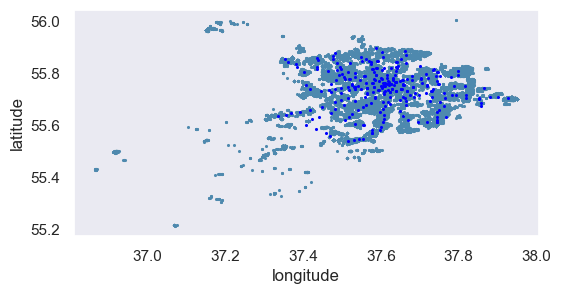

In [92]:
fig, ax1 = plt.subplots(figsize=(6, 3), dpi=100)
sns.scatterplot(x='longitude', y='latitude', ax=ax1, alpha=1, s=5,
                linewidth=0, 
                hue_norm=hue_norm,
                data=train_labels[['longitude', 'latitude']])

sns.scatterplot(x='longitude', y='latitude', color="blue", ax=ax1, s=5, linewidth=0, data=stations[['longitude', 'latitude']])
plt.show()

**We will make two new features based on this:** 
- Lives in "walking" distance from a stop: is a bool
- Distance from nearest stop: a float value

In [22]:
def eucledian_distance(point1, point2):
    return np.sqrt((point1[0]-point2[0])**2 + (point1[1]-point2[1])**2)

Find distance to nearest metro station

In [94]:
## Distance to nearest metro stations
dist_to_metro_train = np.zeros(len(train_labels))
for i, row_t in train_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    nearest_dist = -1
    for j, row_s in stations.iterrows():
        station = (row_s["longitude"], row_s["latitude"]) 
        distance = eucledian_distance(station, apartment)
        if distance < nearest_dist or nearest_dist==-1:
            nearest_dist=distance
    
    dist_to_metro_train[i] = nearest_dist
## Distance to nearest metro stations
dist_to_metro_test = np.zeros(len(test_labels))
for i, row_t in test_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    nearest_dist = -1
    for j, row_s in stations.iterrows():
        station = (row_s["longitude"], row_s["latitude"]) 
        distance = eucledian_distance(station, apartment)
        if distance < nearest_dist or nearest_dist==-1:
            nearest_dist=distance

    dist_to_metro_test[i] = nearest_dist

np.savetxt("external_datasets/metro_distances_train.csv", dist_to_metro_train)
np.savetxt("external_datasets/metro_distances_test.csv", dist_to_metro_test)

Translate the long/lat distance to meters, and add the feature

In [8]:
dist_to_metro_train = np.loadtxt("./external_datasets/metro_distances_train.csv")
dist_to_metro_test = np.loadtxt("./external_datasets/metro_distances_test.csv")

In [9]:
train_labels["dist_to_metro"] = dist_to_metro_train
train_labels["dist_to_metro_in_meters"] = train_labels["dist_to_metro"] * (2*np.pi*(6371000) / 360) # Coordinates to meters
train_labels["metro_walking_distance"] = train_labels["dist_to_metro"]<train_labels["dist_to_metro"].median()

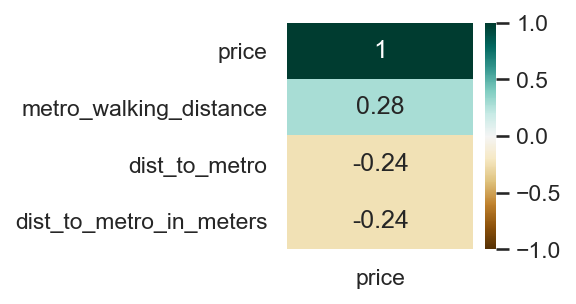

In [97]:
f, ax = plt.subplots(figsize=(2, 2), dpi=150)
heatmap = sns.heatmap(pd.merge(train_labels[["dist_to_metro", "dist_to_metro_in_meters", "metro_walking_distance"]],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

Living close to the metro stops, is as we can see from the map, pretty correlated to living in the center of the city. We already have the feature `r` showing us that buying close to the center is more expensive - so the negative correlation here makes a lot of sense.

#### Floor data - what floor is the best to live on? 

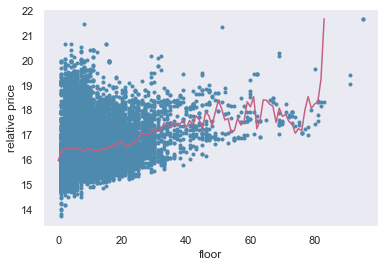

In [98]:
df_all = pd.merge(train_labels[["floor"]], train_targets, left_index=True, right_index=True)
floor_mean = df_all.groupby("floor")["price"].mean()
plt.plot(train_labels["floor"].values, train_targets.values, ".")
plt.plot(range(len(floor_mean)), floor_mean, "-")
plt.xlabel("floor")
plt.ylabel("relative price")
plt.show()

It seems that the general trend is that living higher up is more expensive. Also, we see a clear dip in the data on the first floor -which makes a lot of sense, as living in the first floor of an apartment building is usually not sought after.

We will add some features to try and more efficiently use the information contained in both `stories` and `floor`.

In [100]:
# FLOOR
train_labels['rel_height'] = np.asarray(train_labels["floor"] / train_labels["stories"]).astype("float32")

train_labels["lives_in_highrise"] = np.asarray((train_labels["stories"]>30)).astype("int")

train_labels["first_floor"] = np.asarray(train_labels["floor"]==1).astype("int")

train_labels["floor_inverse"] = train_labels["stories"]-train_labels["floor"]
median_floor_inverse = np.median(train_labels["floor_inverse"])
train_labels["floor_inverse_median"]=train_labels["floor_inverse"].where(train_labels["floor_inverse"]>=0, other=median_floor_inverse)

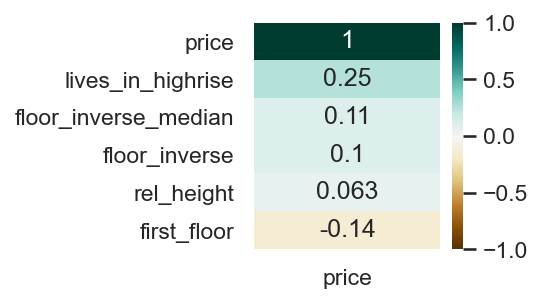

In [101]:
f, ax = plt.subplots(figsize=(2, 2), dpi=150)
heatmap = sns.heatmap(pd.merge(train_labels[["rel_height", "lives_in_highrise", "first_floor", "floor_inverse", "floor_inverse_median"]],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

Since `floor` already had a 0.13 correlation with price, it is not immediately obvious whether the `rel_heigth` and `floor_inverse` features offer additional benefit. However there might be non-linear relations that a good model can discover and exploit, so we will keep them.

### Street names - how good is your russian?

Looking through the streetnames we found (using google translate) some interesting street **types**:

In [99]:
name_dict = {
    "highway" : "шоссе", #33
    "street" : "улица", # 1038
    "park" : "Парк", # 24
    "avenue" : "проспект", # 36
    "meadows" : "Луга", # 3
    "microdistrict" : "мкр", # 31
    "seafront" : "набережная", # 32
    "thoroughfare" : "проезд", # 160
    "boulevard" : "бульвар", # 54
    "alley" : "аллея", # 8
}

In [367]:
added_features=[]
for _, key in enumerate(name_dict.keys()):
    on_type = [1 if name_dict[key] in row["street"] else 0 for _, row in train_labels.iterrows()] 
    train_labels["on_"+key] = on_type
    added_features.append("on_"+key)

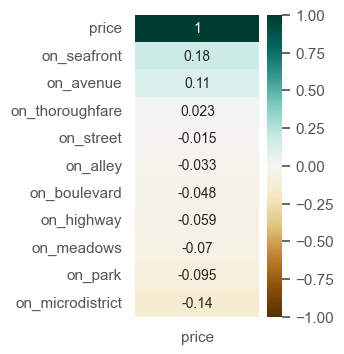

In [370]:
f, ax = plt.subplots(figsize=(2, 4), dpi=100)
heatmap = sns.heatmap(pd.merge(train_labels[added_features],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**So, out of all the types of streets, it was only the `seafront`/`набережная` and `avenue`/`проспект` really that was positive correlated to price.
On the other side we have the `park`/`Парк` and `microdistrict`/`мкр` that was not nice to live in.**

We can add these two as new features, while the others are not really that interesting to keep.

**We then plotted and found the best streets to live on in Moscow***: 

["Мосфильмовская улица", "набережная Пресненская", "улица Ефремова", "Казарменный переулок"] 

In [102]:
good_streets = ["Мосфильмовская улица", "набережная Пресненская", "улица Ефремова", "Казарменный переулок"] # From the analysis below.

In [103]:
added_feats = []
for street_name in good_streets:
    on_street = [1 if street_name in row["street"] else 0 for _, row in train_labels.iterrows()] 
    train_labels["in_"+street_name] = on_street
    added_feats.append("in_"+street_name)

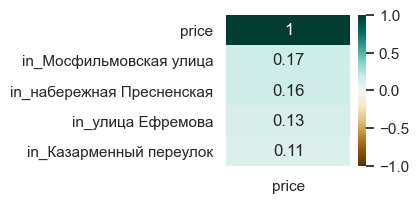

In [104]:
f, ax = plt.subplots(figsize=(2,2), dpi=100)
#[["price"]].sort_values(by="price", ascending=False)
heatmap = sns.heatmap(pd.merge(
    train_labels[added_feats],
    train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

Using *GoogleStreetView* we see that these are indeed some nice areas, confirming our theory.

#### Age of building
Living in an old building is in most cases not sought after; larger electrical bill and more renovation. 
> Lets plot the mean selling price for each year of construction.

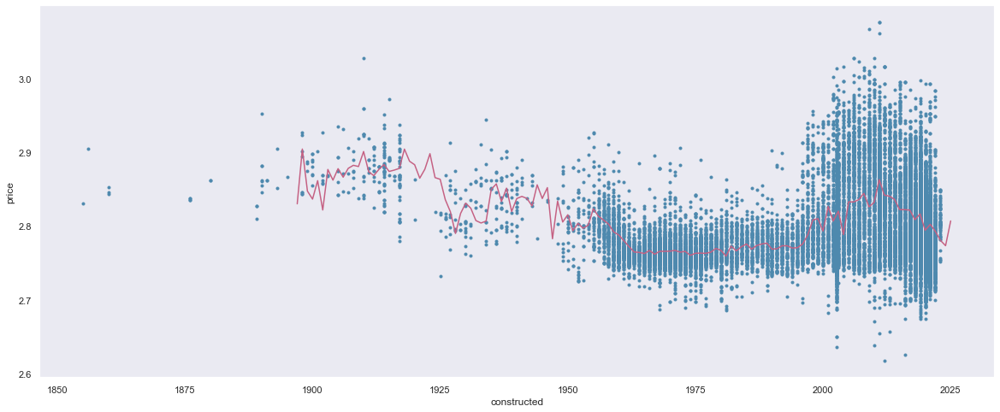

In [105]:
df_all = pd.merge(train_labels[["constructed"]], np.log(train_targets), left_index=True, right_index=True)
constructed_mean = df_all.groupby("constructed")["price"].mean()
plt.figure(figsize=(20, 8))
plt.plot(train_labels["constructed"].values, np.log(train_targets.values), ".")
plt.xlabel("constructed")
plt.ylabel("price")
plt.plot(range(1897, len(constructed_mean)+1897), constructed_mean, "-")
plt.show()

**Interesting!** Very old buildings are either already demolished or well kept it seems. The cold-war period was a period of economic regression in Russia (at least according to my western history teaching). We can see this reflected in the price from this area: pobably a lot of cheap, grey, boring apartment buildings (so-called "østblokk" in norwegian, meaning east-block / boring apartment building from the east (= From russia)). 

In [10]:
train_labels["age_building"] = 2021 - train_labels["constructed"]
train_labels["old_building"] = (train_labels["constructed"]<1950)
train_labels["cold_war_building"] = (train_labels["constructed"]>1955) & (train_labels["constructed"]<2000)
train_labels["modern_but_not_too_modern"] = (train_labels["constructed"]>2000) & (train_labels["constructed"]<2018)

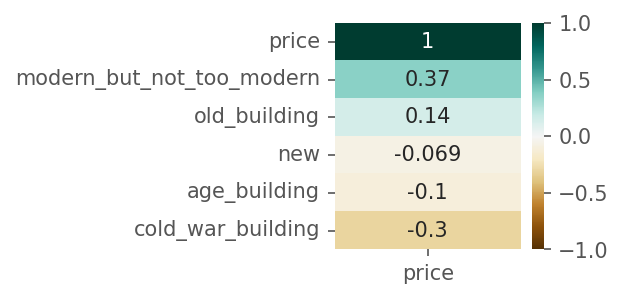

In [11]:
f, ax = plt.subplots(figsize=(2, 2), dpi=150)
heatmap = sns.heatmap(pd.merge(train_labels[["age_building", "old_building", "cold_war_building", "modern_but_not_too_modern", "new"]],
                               train_targets, left_index=True, right_index=True).corr()[["price"]].sort_values(by="price", ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

**`new`** is a feature of the dataset, lets look more into it.

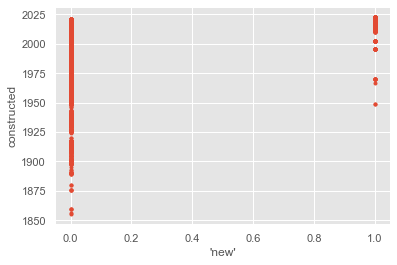

In [364]:
plt.plot(train_labels["new"], train_labels["constructed"], ".")
plt.xlabel("'new'")
plt.ylabel("constructed")
plt.show()

We can see that the "new" feature is not actually when the building was made, and might rather be about when the apartment was refurbished. What is surprising is how uncorrelated it is to price.

#### Some other features

In [111]:
# Add "Spacious_rooms": area per room
train_labels['spacious_rooms'] = train_labels['area_total'] / train_labels['rooms']
test_labels['spacious_rooms'] = test_labels['area_total'] / test_labels['rooms']
added_features.append('spacious_rooms')

train_labels["rel_living"] = np.asarray(train_labels["area_living"] / train_labels["area_total"]).astype("float32")
test_labels["rel_living"] = np.asarray(test_labels["area_living"] / test_labels["area_total"]).astype("float32")
added_features.append("rel_living")

train_labels["total_bathrooms"] = np.asarray(train_labels["bathrooms_private"] + train_labels["bathrooms_shared"]).astype("int")
test_labels["total_bathrooms"] = np.asarray(test_labels["bathrooms_private"] + test_labels["bathrooms_shared"]).astype("int")
added_features.append("total_bathrooms")

# Some boolean features
train_labels["multiple_balconies"] = np.asarray((train_labels["balconies"]>1)).astype("int")
test_labels["multiple_balconies"] = np.asarray((test_labels["balconies"]>1)).astype("int")
added_features.append("multiple_balconies")

train_labels["multiple_loggias"] = np.asarray((train_labels["loggias"]>1)).astype("int")
test_labels["multiple_loggias"] = np.asarray((test_labels["loggias"]>1)).astype("int")
added_features.append("multiple_loggias")

train_labels["both_windows"] = np.asarray((train_labels["windows_court"]==True) & (train_labels["windows_street"]==True)).astype("int")
test_labels["both_windows"] = np.asarray((test_labels["windows_court"]==True) & (test_labels["windows_street"]==True)).astype("int")
added_features.append("both_windows")

# Relative kitchen space
train_labels["rel_kitchen"] = np.asarray(train_labels["area_kitchen"] / train_labels["area_total"]).astype("float32")
test_labels["rel_kitchen"] = np.asarray(test_labels["area_kitchen"] / test_labels["area_total"]).astype("float32")
added_features.append("rel_kitchen")

#Close to state university of moscow
uni_location = (37.5286, 55.7039)
## Distance to state university
dist_to_uni_train = np.zeros(len(train_labels))
for i, row_t in train_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    dist_to_uni_train[i] = eucledian_distance(apartment, uni_location)
dist_to_uni_test = np.zeros(len(test_labels))
for i, row_t in test_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    dist_to_uni_test[i] = eucledian_distance(apartment, uni_location)
# Meter edition
dist_to_uni_train_meters = dist_to_uni_train*(2*np.pi*(6371000) / 360)
dist_to_uni_test_meters = dist_to_uni_test*(2*np.pi*(6371000) / 360)
# Close to uni 
train_labels["close_to_uni"] = np.asarray((dist_to_uni_train_meters<2000)).astype("int")
test_labels["close_to_uni"] = np.asarray((dist_to_uni_test_meters<2000)).astype("int")
added_features.append('close_to_uni')

## close to state hospital
# Location of state hospital
hosp_location = (37.389167, 55.746389)
## Distance to state university
dist_to_hosp_train = np.zeros(len(train_labels))
for i, row_t in train_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    dist_to_hosp_train[i] = eucledian_distance(apartment, hosp_location)
dist_to_hosp_test = np.zeros(len(test_labels))
for i, row_t in test_labels.iterrows():
    apartment = (row_t["longitude"], row_t["latitude"])
    dist_to_hosp_test[i] = eucledian_distance(apartment, hosp_location)

dist_to_hosp_train_meters = dist_to_hosp_train*(2*np.pi*(6371000) / 360)
train_labels["dist_to_hospital_m"] = dist_to_hosp_train_meters
dist_to_hosp_test_meters = dist_to_hosp_test*(2*np.pi*(6371000) / 360)
test_labels["dist_to_hospital_m"] = dist_to_hosp_test_meters
added_features.append('dist_to_hospital_m')

# A collection of more features
train_labels["area_floor"] = train_labels["area_total"] / train_labels["floor"]
train_labels["area_stories"] = train_labels["area_total"] / train_labels["stories"]
train_labels["area_rooms"] = train_labels["area_total"] / np.average(train_labels["rooms"]) # is just the invert of spacious rooms
train_labels["bathroom_area"] = (train_labels["bathrooms_private"] + train_labels["bathrooms_shared"])/train_labels["area_total"]
train_labels['bathrooms_per_room'] = (train_labels["total_bathrooms"])/train_labels["rooms"]

test_labels["area_floor"] = test_labels["area_total"] / test_labels["floor"]
test_labels["area_stories"] = test_labels["area_total"] / test_labels["stories"]
test_labels["area_rooms"] = test_labels["area_total"] / np.average(test_labels["rooms"]) # is just the invert of spacious rooms
test_labels["bathroom_area"] = (test_labels["bathrooms_private"] + test_labels["bathrooms_shared"])/test_labels["area_total"]
test_labels['bathrooms_per_room'] = (test_labels["total_bathrooms"])/test_labels["rooms"]

These features either combine two features already in the dataset - hoping that the model might be able to efficiently analyse this combination - or they use a calculation to obtain the distance from important hallmarks, such as the university and hospital.

##### Areas versus averages
Since area is such an important feature, we made extra features based on the relation area has to different categories. We thus developed the following features:
* `area_average_rooms`: the average total area divided by the average number of rooms.
* `average_area_total_district`: the total area divided by the average total area for the district the apartment is located in.
* `average_area_living_district`: same as above but for living area.
* `average_area_kitchen_district`: same as above but for kitchen area.
* `average_area_total_floor`: the total area divided by the average total area on this floor.
* `average_area_year_constructed`: the total area divided by the average total area for that construction year.

They are calculated as follows:

In [109]:
arr_train = train_labels[["district","area_total","area_living","area_kitchen",]].to_numpy()
arr_test = df_test[["district","area_total","area_living","area_kitchen",]].to_numpy()

arr_full = np.concatenate((arr_train,arr_test),axis=0)

average_area_total_district = {}
average_area_living_district = {}
average_area_kitchen_district = {}

for x in sorted(np.unique(arr_full[...,0])):
    average_area_total_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])
    average_area_living_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,2])
    average_area_kitchen_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,3])

# Calculate floor average areas
arr_train = train_labels[["floor","area_total"]].to_numpy()
arr_test = df_test[["floor","area_total"]].to_numpy()

arr_full = np.concatenate((arr_train,arr_test),axis=0)

average_area_total_floor = {}
for x in sorted(np.unique(arr_full[...,0])):
    average_area_total_floor[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])

# Calculate construction year average areas
arr_train = train_labels[["constructed","area_total","area_living","area_kitchen",]].to_numpy()
arr_test = df_test[["constructed","area_total","area_living","area_kitchen",]].to_numpy()

arr_full = np.concatenate((arr_train,arr_test),axis=0)

average_area_total_constructed = {}
for x in sorted(np.unique(arr_full[...,0])):
    average_area_total_constructed[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])

total_district = []
living_district = []
kitchen_district = []

total_floor = []
total_constructed = []

for _,row in train_labels.iterrows():
    total_district.append(row['area_total']/average_area_total_district[row['district']])
    living_district.append(row['area_living']/average_area_living_district[row['district']])
    kitchen_district.append(row['area_kitchen']/average_area_kitchen_district[row['district']])
    total_floor.append(row['area_total']/average_area_total_floor[row['floor']])
    total_constructed.append(row['area_total']/average_area_total_constructed[row['constructed']] if (pd.notnull(row['area_total']) and pd.notnull(row['constructed'])) else None)

total_district_test = []
living_district_test = []
kitchen_district_test = []

total_floor_test = []
total_constructed_test = []

train_labels["area_average_rooms"] = train_labels["area_total"] / np.average(train_labels["rooms"])
train_labels['average_area_total_district'] = total_district
train_labels['average_area_living_district'] = living_district
train_labels['average_area_kitchen_district'] = kitchen_district
train_labels['average_area_total_floor'] = total_floor
train_labels['average_area_year_constructed'] = total_constructed

We can also look at the correlations with the price. However it is better to look at the correlation with the log of the price, since our models will predict this.

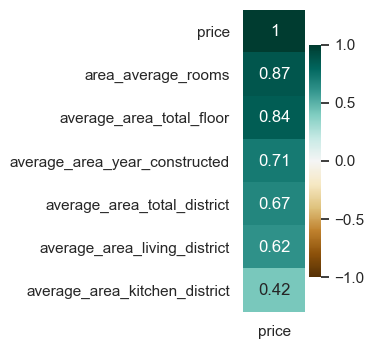

In [110]:
f, ax = plt.subplots(figsize=(1, 4), dpi=100)
heatmap = sns.heatmap(pd.merge(train_labels[[
    'area_average_rooms',
    'average_area_total_district',
    'average_area_living_district',
    'average_area_kitchen_district',
    'average_area_total_floor',
    'average_area_year_constructed',
    ]], 
                               np.log(df_train['price']),
                               left_index=True, 
                               right_index=True).corr()[['price']].sort_values(by='price', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

These features are all very correlated, which can partly be explained due to `area_total`'s high correlation, but they can still be very interesting and useful.

##### District and Popularity

Another very important factor to determine the price is the location, so we developed extra features to further exploit the information contained in the district data.

We browsed Wikipedia and found the population and square area per district. We then used these to calculate the population density per district and added the following features:
> * `density_district`
> * `population_district`
> * `area_district`

We also discovered that Moscow has a ring road: the MKAD and added another boolean feature:
> * `outside_MKAD`

Finally we used the number of apartments available to calculate some popularity features:
> * `popularity_district_dataset`: the number of apartments offered in this district divided by the total amount of apartments.
> * `popularity_district_population`: the district popularity divided by the number of people living in that district.

The correlation map of these features is given below.

In [117]:
train_labels_x, _, _ = feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=False,
    add_dist_to_metro=False,
    add_close_to_uni=False,
    add_dist_to_hospital=False,
    add_floor_features=False,
    add_street_info=False,
    add_some_more_features=True,
    add_district_information=True,
    )

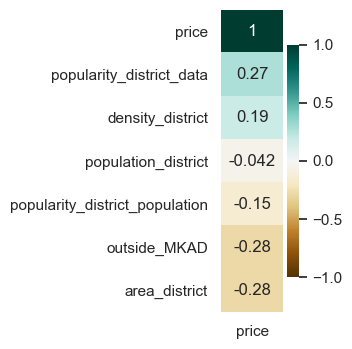

In [118]:
f, ax = plt.subplots(figsize=(1, 4), dpi=100)
heatmap = sns.heatmap(pd.merge(train_labels_x[[
    'density_district',
    'population_district',
    'area_district',
    'outside_MKAD',
    'popularity_district_data',
    'popularity_district_population',
    ]], 
                               np.log(train_targets),
                               left_index=True, 
                               right_index=True).corr()[['price']].sort_values(by='price', ascending=False), vmin=-1, vmax=1, annot=True, cmap='BrBG', ax=ax)

## Models

We are now going to talk about the models, but before that, let us put all features we just saw into a single function. `feature_engineering()` allows us to turn on and off certain features for different models, `normalize` allows to normalize selected features from the dataset using different scalers, and `one_hot_endcoder` allows us to one-hot-encode different categorical data.

In [13]:
def polar_coordinates(train_labels, test_labels, use_city_centre=False):
    '''
    labels and input labels. Adds theta and also R to the dataframe copy.
    '''
    # Make a copy to manipulate
    labels1_normed_r = train_labels[["latitude", "longitude"]].copy()
    test1_normed_r = test_labels[["latitude", "longitude"]].copy()

    # City centre 55.755833, 37.617222 (lat/long)
    # Instead of mean, use city centre: 
    if use_city_centre:
        labels1_normed_r['latitude'] = labels1_normed_r['latitude'] - 55.755833
        labels1_normed_r['longitude'] = labels1_normed_r['longitude'] - 37.617222
        test1_normed_r['latitude'] = test1_normed_r['latitude'] -  55.755833
        test1_normed_r['longitude'] = test1_normed_r['longitude'] -  37.617222
    else: # just use means
        # FLOAT
        train_float_mean = train_labels["longitude"].mean()
        test_float_mean = test_labels["longitude"].mean()
        tl = len(train_labels) + len(test_labels)
        total_mean_long = (train_float_mean*len(train_labels) + test_float_mean*len(test_labels)) / tl

        train_float_mean = train_labels["latitude"].mean()
        test_float_mean = test_labels["latitude"].mean()
        tl = len(train_labels) + len(test_labels)
        total_mean_lat = (train_float_mean*len(train_labels) + test_float_mean*len(test_labels)) / tl 

        labels1_normed_r['latitude'] = labels1_normed_r['latitude'] - total_mean_lat
        labels1_normed_r['longitude'] = labels1_normed_r['longitude'] - total_mean_long
        test1_normed_r['latitude'] = test1_normed_r['latitude'] -  total_mean_lat
        test1_normed_r['longitude'] = test1_normed_r['longitude'] -  total_mean_long

    # Convert to polar coordinates
    labels1_normed_r['r'] =  np.sqrt(labels1_normed_r['latitude']**2 + labels1_normed_r['longitude']**2)
    labels1_normed_r['theta'] = np.arctan(labels1_normed_r['longitude']/labels1_normed_r['latitude'])
    test1_normed_r['r'] =  np.sqrt(test1_normed_r['latitude']**2 + test1_normed_r['longitude']**2)
    test1_normed_r['theta'] = np.arctan(test1_normed_r['longitude']/test1_normed_r['latitude'])

    # Add polar coordinates
    train_labels["r"] = labels1_normed_r['r']
    train_labels["theta"] = labels1_normed_r['theta']
    test_labels["r"] = test1_normed_r['r']
    test_labels["theta"] = test1_normed_r['theta']

    return train_labels, test_labels

In [14]:
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder

def feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=False,
    add_dist_to_metro=False,
    add_close_to_uni=False,
    add_dist_to_hospital=False,
    add_floor_features=False,
    add_street_info=False,
    add_some_more_features=False,
    add_district_information=False,
    ):

    if add_base_features:
        added_features = []
        # Add R and theta
        train_labels, test_labels = polar_coordinates(train_labels, test_labels)
        added_features.append("r")
        added_features.append("theta")

        # Add "Spacious_rooms": area per room
        train_labels['spacious_rooms'] = train_labels['area_total'] / train_labels['rooms']
        test_labels['spacious_rooms'] = test_labels['area_total'] / test_labels['rooms']
        added_features.append('spacious_rooms')

        # Newly_built
        is_new = [1 if row["constructed"] >= 2000 else 0 for _, row in train_labels.iterrows()] 
        train_labels["actually_new"] = is_new
        is_new = [1 if row["constructed"] >= 2000 else 0 for _, row in test_labels.iterrows()] 
        test_labels["actually_new"] = is_new
        added_features.append("actually_new")

        train_labels["rel_living"] = np.asarray(train_labels["area_living"] / train_labels["area_total"]).astype("float32")
        test_labels["rel_living"] = np.asarray(test_labels["area_living"] / test_labels["area_total"]).astype("float32")
        added_features.append("rel_living")
            
        train_labels["total_bathrooms"] = np.asarray(train_labels["bathrooms_private"] + train_labels["bathrooms_shared"]).astype("int")
        test_labels["total_bathrooms"] = np.asarray(test_labels["bathrooms_private"] + test_labels["bathrooms_shared"]).astype("int")
        added_features.append("total_bathrooms")

    if add_bool_features:
        # Some boolean features
        train_labels["multiple_balconies"] = np.asarray((train_labels["balconies"]>1)).astype("int")
        test_labels["multiple_balconies"] = np.asarray((test_labels["balconies"]>1)).astype("int")
        added_features.append("multiple_balconies")

        train_labels["multiple_loggias"] = np.asarray((train_labels["loggias"]>1)).astype("int")
        test_labels["multiple_loggias"] = np.asarray((test_labels["loggias"]>1)).astype("int")
        added_features.append("multiple_loggias")

        train_labels["both_windows"] = np.asarray((train_labels["windows_court"]==True) & (train_labels["windows_street"]==True)).astype("int")
        test_labels["both_windows"] = np.asarray((test_labels["windows_court"]==True) & (test_labels["windows_street"]==True)).astype("int")
        added_features.append("both_windows")

    if add_weak_features:
        # Weakly correlated ones.
        train_labels["rel_kitchen"] = np.asarray(train_labels["area_kitchen"] / train_labels["area_total"]).astype("float32")
        test_labels["rel_kitchen"] = np.asarray(test_labels["area_kitchen"] / test_labels["area_total"]).astype("float32")
        added_features.append("rel_kitchen")

        train_labels['rel_height'] = np.asarray(train_labels["floor"] / train_labels["stories"]).astype("float32")
        test_labels['rel_height'] = np.asarray(test_labels["floor"] / test_labels["stories"]).astype("float32")
        added_features.append('rel_height')

    if add_dist_to_metro:
        # Pre-calculated
        dist_to_metro_train = np.loadtxt("metro_distances_train.csv")
        dist_to_metro_test = np.loadtxt("metro_distances_test.csv")
        # Meter variant
        train_labels["dist_to_metro_m"] = dist_to_metro_train * (2*np.pi*(6371000) / 360)
        test_labels["dist_to_metro_m"] = dist_to_metro_test * (2*np.pi*(6371000) / 360)
        added_features.append('dist_to_metro_m')
        # Walking distance
        train_labels["metro_walking_distance"] = np.asarray(train_labels["dist_to_metro_m"]<train_labels["dist_to_metro_m"].median()).astype("int")
        test_labels["metro_walking_distance"] = np.asarray(test_labels["dist_to_metro_m"]<test_labels["dist_to_metro_m"].median()).astype("int")
        added_features.append('metro_walking_distance')
    
    if add_close_to_uni:
        # Uni location
        uni_location = (37.5286, 55.7039)
        ## Distance to state university
        dist_to_uni_train = np.zeros(len(train_labels))
        for i, row_t in train_labels.iterrows():
            apartment = (row_t["longitude"], row_t["latitude"])
            dist_to_uni_train[i] = eucledian_distance(apartment, uni_location)
        dist_to_uni_test = np.zeros(len(test_labels))
        for i, row_t in test_labels.iterrows():
            apartment = (row_t["longitude"], row_t["latitude"])
            dist_to_uni_test[i] = eucledian_distance(apartment, uni_location)
        # Meter edition
        dist_to_uni_train_meters = dist_to_uni_train*(2*np.pi*(6371000) / 360)
        dist_to_uni_test_meters = dist_to_uni_test*(2*np.pi*(6371000) / 360)
        # Close to uni 
        train_labels["close_to_uni"] = np.asarray((dist_to_uni_train_meters<2000)).astype("int")
        test_labels["close_to_uni"] = np.asarray((dist_to_uni_test_meters<2000)).astype("int")
        added_features.append('close_to_uni')

    if add_dist_to_hospital:
        # Location of state hospital
        hosp_location = (37.389167, 55.746389)
        ## Distance to state university
        dist_to_hosp_train = np.zeros(len(train_labels))
        for i, row_t in train_labels.iterrows():
            apartment = (row_t["longitude"], row_t["latitude"])
            dist_to_hosp_train[i] = eucledian_distance(apartment, hosp_location)
        dist_to_hosp_test = np.zeros(len(test_labels))
        for i, row_t in test_labels.iterrows():
            apartment = (row_t["longitude"], row_t["latitude"])
            dist_to_hosp_test[i] = eucledian_distance(apartment, hosp_location)

        dist_to_hosp_train_meters = dist_to_hosp_train*(2*np.pi*(6371000) / 360)
        train_labels["dist_to_hospital_m"] = dist_to_hosp_train_meters
        dist_to_hosp_test_meters = dist_to_hosp_test*(2*np.pi*(6371000) / 360)
        test_labels["dist_to_hospital_m"] = dist_to_hosp_test_meters
        added_features.append('dist_to_hospital_m')

    if add_floor_features:
        train_labels["lives_in_highrise"] = np.asarray((train_labels["stories"]>30)).astype("int")
        test_labels["lives_in_highrise"] = np.asarray((test_labels["stories"]>30)).astype("int")
        added_features.append('lives_in_highrise')

        train_labels["first_floor"] = np.asarray(train_labels["floor"]==1).astype("int")
        test_labels["first_floor"] = np.asarray(test_labels["floor"]==1).astype("int")
        added_features.append('first_floor')
        
        train_labels["floor_inverse"] = train_labels["stories"]-train_labels["floor"]
        median_floor_inverse = np.median(train_labels["floor_inverse"])
        train_labels["floor_inverse"]=train_labels["floor_inverse"].where(train_labels["floor_inverse"]>=0, other=median_floor_inverse)
        test_labels["floor_inverse"] = test_labels["stories"]-test_labels["floor"]
        test_labels["floor_inverse"]=test_labels["floor_inverse"].where(test_labels["floor_inverse"]>=0, other=median_floor_inverse)
        added_features.append('floor_inverse')

    if add_street_info:
        # Seafront = набережная.
        # This was pretty much the only one correlated to price.
        on_type = [1 if "набережная" in row["street"] else 0 for _, row in train_labels.iterrows()] 
        train_labels["on_seafront"] = on_type
        on_type = [1 if "набережная" in row["street"] else 0 for _, row in test_labels.iterrows()] 
        test_labels["on_seafront"] = on_type
        added_features.append('on_seafront')
        # Also, these streets seemed good to live in.
        good_streets = ["Мосфильмовская улица", "набережная Пресненская",
         "улица Ефремова", "Казарменный переулок"]
        for street_name in good_streets:
            on_street = [1 if street_name in row["street"] else 0 for _, row in train_labels.iterrows()] 
            train_labels["in_"+street_name] = on_street
        for street_name in good_streets:
            on_street = [1 if street_name in row["street"] else 0 for _, row in test_labels.iterrows()] 
            test_labels["in_"+street_name] = on_street
            added_features.append("in_"+street_name)
        
    if add_some_more_features:
        # This is moved to data_cleaning.
        #train_labels = train_labels.astype({'constructed':'int'})
        #test_labels = test_labels.astype({'constructed':'int'})

        train_labels["area_floor"] = train_labels["area_total"] / train_labels["floor"]
        train_labels["area_stories"] = train_labels["area_total"] / train_labels["stories"]
        train_labels["area_rooms"] = train_labels["area_total"] / np.average(train_labels["rooms"]) # is just the invert of spacious rooms
        train_labels["old_building"] = (train_labels["constructed"]<1950)
        train_labels["cold_war_building"] = (train_labels["constructed"]>1955) & (train_labels["constructed"]<2000)
        train_labels["modern_but_not_too_modern"] = (train_labels["constructed"]>2000) & (train_labels["constructed"]<2018)
        train_labels["bathroom_area"] = (train_labels["bathrooms_private"] + train_labels["bathrooms_shared"])/train_labels["area_total"]
        train_labels['bathrooms_per_room'] = (train_labels["total_bathrooms"])/train_labels["rooms"]

        test_labels["area_floor"] = test_labels["area_total"] / test_labels["floor"]
        test_labels["area_stories"] = test_labels["area_total"] / test_labels["stories"]
        test_labels["area_rooms"] = test_labels["area_total"] / np.average(test_labels["rooms"]) # is just the invert of spacious rooms
        test_labels["old_building"] = (test_labels["constructed"]<1950)
        test_labels["cold_war_building"] = (test_labels["constructed"]>1955) & (test_labels["constructed"]<2000)
        test_labels["modern_but_not_too_modern"] = (test_labels["constructed"]>2000) & (test_labels["constructed"]<2018)
        test_labels["bathroom_area"] = (test_labels["bathrooms_private"] + test_labels["bathrooms_shared"])/test_labels["area_total"]
        test_labels['bathrooms_per_room'] = (test_labels["total_bathrooms"])/test_labels["rooms"]


        # Calculate district average areas
        arr_train = train_labels[["district","area_total","area_living","area_kitchen",]].to_numpy()
        arr_test = test_labels[["district","area_total","area_living","area_kitchen",]].to_numpy()

        arr_full = np.concatenate((arr_train,arr_test),axis=0)

        average_area_total_district = {}
        average_area_living_district = {}
        average_area_kitchen_district = {}

        for x in sorted(np.unique(arr_full[...,0])):
            average_area_total_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])
            average_area_living_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,2])
            average_area_kitchen_district[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,3])

        # Calculate floor average areas
        arr_train = train_labels[["floor","area_total"]].to_numpy()
        arr_test = test_labels[["floor","area_total"]].to_numpy()

        arr_full = np.concatenate((arr_train,arr_test),axis=0)

        average_area_total_floor = {}
        for x in sorted(np.unique(arr_full[...,0])):
            average_area_total_floor[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])
   
        # Calculate construction year average areas
        arr_train = train_labels[["constructed","area_total","area_living","area_kitchen",]].to_numpy()
        arr_test = test_labels[["constructed","area_total","area_living","area_kitchen",]].to_numpy()
        
        arr_full = np.concatenate((arr_train,arr_test),axis=0)

        average_area_total_constructed = {}
        for x in sorted(np.unique(arr_full[...,0])):
            average_area_total_constructed[x] = np.average(arr_full[np.where(arr_full[...,0]==x)][...,1])
   
        total_district = []
        living_district = []
        kitchen_district = []

        total_floor = []
        total_constructed = []

        for _,row in train_labels.iterrows():
            total_district.append(row['area_total']/average_area_total_district[row['district']])
            living_district.append(row['area_living']/average_area_living_district[row['district']])
            kitchen_district.append(row['area_kitchen']/average_area_kitchen_district[row['district']])
            total_floor.append(row['area_total']/average_area_total_floor[row['floor']])
            total_constructed.append(row['area_total']/average_area_total_constructed[row['constructed']] if (pd.notnull(row['area_total']) and pd.notnull(row['constructed'])) else None)
        
        total_district_test = []
        living_district_test = []
        kitchen_district_test = []

        total_floor_test = []
        total_constructed_test = []

        for _,row in test_labels.iterrows():
            total_district_test.append(row['area_total']/average_area_total_district[row['district']])
            living_district_test.append(row['area_living']/average_area_living_district[row['district']])
            kitchen_district_test.append(row['area_kitchen']/average_area_kitchen_district[row['district']])
            total_floor_test.append(row['area_total']/average_area_total_floor[row['floor']])
            total_constructed_test.append(row['area_total']/average_area_total_constructed[row['constructed']] if (pd.notnull(row['area_total']) and pd.notnull(row['constructed'])) else None)

        train_labels['average_area_total_district'] = total_district
        train_labels['average_area_living_district'] = living_district
        train_labels['average_area_kitchen_district'] = kitchen_district
        train_labels['average_area_total_floor'] = total_floor
        train_labels['average_area_year_constructed'] = total_constructed

        test_labels['average_area_total_district'] = total_district_test
        test_labels['average_area_living_district'] = living_district_test
        test_labels['average_area_kitchen_district'] = kitchen_district_test
        test_labels['average_area_total_floor'] = total_floor_test
        test_labels['average_area_year_constructed'] = total_constructed_test
    
    if add_district_information:
        density = {
            0: 701353/66.1755,
            1: 1112846/109.9,
            2: 1240062/101.889,
            3: 1394497/154.6,
            4: 1116924/117.6,
            5: 1593065/132,
            6: 1179211/111.4,
            7: 1049104/153,
            8: 779965/93.281,
            9: 215727/37.22,
            10:86752/1084.3,
            11:113569/361.4
          }
        population = {
            0: 701353,
            1: 1112846,
            2: 1240062,
            3: 1394497,
            4: 1116924,
            5: 1593065,
            6: 1179211,
            7: 1049104,
            8: 779965,
            9: 215727,
            10:86752,
            11:113569
                }
        district_area ={
            0: 66.1755,
            1: 109.9,
            2: 101.889,
            3: 154.6,
            4: 117.6,
            5: 132,
            6: 111.4,
            7: 153,
            8: 93.281,
            9: 37.22,
            10:1084.3,
            11:361.4
                }

        district_popularity_train_set = train_labels[['district','building_id']].groupby(['district']).count()
        district_popularity_test_set = test_labels[['district','building_id']].groupby(['district']).count()
        population_df = pd.DataFrame.from_dict(population,orient='index')
        total = len(train_labels) + len(test_labels)
        popularity_data_df = (district_popularity_train_set+district_popularity_test_set)/total
        popularity_data = popularity_data_df.to_dict()['building_id']
        popularity_population_df = pd.DataFrame.from_dict(popularity_data,orient='index')/population_df
        popularity_population = popularity_population_df.to_dict()[0]



        density_district = [density[row['district']] for _,row in train_labels.iterrows()]
        population_district = [population[row['district']] for _,row in train_labels.iterrows()]
        area_district = [district_area[row['district']] for _,row in train_labels.iterrows()]
        outside_MKAD = [1 if (row["district"] in [9,10,11]) else 0 for _,row in train_labels.iterrows()]
        popularity_district_data = [popularity_data[row['district']] for _,row in train_labels.iterrows()]
        popularity_district_population = [popularity_population[row['district']] for _,row in train_labels.iterrows()]

        train_labels["density_district"] = density_district
        train_labels["population_district"] = population_district
        train_labels["area_district"] = area_district
        train_labels["outside_MKAD"] = outside_MKAD        
        train_labels["popularity_district_data"] = popularity_district_data
        train_labels["popularity_district_population"] = popularity_district_population


        density_district_test = [density[row['district']] for _,row in test_labels.iterrows()]
        population_district_test = [population[row['district']] for _,row in test_labels.iterrows()]
        area_district_test = [district_area[row['district']] for _,row in test_labels.iterrows()]
        outside_MKAD_test = [1 if (row["district"] in [9,10,11]) else 0 for _,row in test_labels.iterrows()]
        popularity_district_data_test = [popularity_data[row['district']] for _,row in test_labels.iterrows()]
        popularity_district_population_test = [popularity_population[row['district']] for _,row in test_labels.iterrows()]

        test_labels["density_district"] = density_district_test
        test_labels["population_district"] = population_district_test
        test_labels["area_district"] = area_district_test
        test_labels["outside_MKAD"] = outside_MKAD_test
        test_labels["popularity_district_data"] = popularity_district_data_test
        test_labels["popularity_district_population"] = popularity_district_population_test


    return train_labels, test_labels, added_features

def normalize(train_labels, test_labels, features, scaler="minMax"):
    # Only normalize/scale the numerical data. Categorical data is kept as is.
    train_labels_n = train_labels.filter(features)
    test_labels_n = test_labels.filter(features)

    # Scale it.
    if scaler=="minMax":
        print("minMax")
        scaler = MinMaxScaler(feature_range=(0, 1))
        train_labels_scaled = scaler.fit_transform(train_labels_n)
        test_labels_scaled = scaler.transform(test_labels_n)
    elif scaler=="std":
        print("Std")
        std_scale = preprocessing.StandardScaler().fit(train_labels_n)
        train_labels_scaled = std_scale.transform(train_labels_n)
        test_labels_scaled = std_scale.transform(test_labels_n)
    else:
        assert ValueError, "Incorrect scaler"

    # Re-enter proceedure
    training_norm_col = pd.DataFrame(train_labels_scaled, index=train_labels_n.index, columns=train_labels_n.columns) 
    train_labels.update(training_norm_col)

    testing_norm_col = pd.DataFrame(test_labels_scaled, index=test_labels_n.index, columns=test_labels_n.columns) 
    test_labels.update(testing_norm_col)

    return train_labels, test_labels

def one_hot_encoder(train_df, test_df, cat_features, drop_old=True):
    '''
    Returns a copy of all three dfs, after one-hot encoding and !removing!
    their old cat_features.

    NB! pd.get_dummies() does pretty much the same job!
    https://stackoverflow.com/questions/36285155/pandas-get-dummies
    BUG! Some categories are only present in train not test or the other way around!
        - Then the encoding is made differently for the two!
    https://stackoverflow.com/questions/57946006/one-hot-encoding-train-with-values-not-present-on-test
    '''
    # TODO: use Laures one-hot encoder.
    
    #if(len(train_df.isna())!=0 or len(train_df.isna())!=0 or len(train_df.isna())!=0):
    #    assert ValueError

    train_labels = train_df.copy()
    test_labels = test_df.copy()

    encoded_features = []
    dfs=[train_labels, test_labels]
    for df in dfs:
        for feature in cat_features:
            encoded_feat = OneHotEncoder().fit_transform(df[feature].values.reshape(-1, 1)).toarray()
            n = df[feature].nunique()
            cols = ['{}_{}'.format(feature, n) for n in range(1, n + 1)]
            encoded_df = pd.DataFrame(encoded_feat, columns=cols)
            encoded_df.index = df.index
            encoded_features.append(encoded_df)

    n = len(cat_features)

    train_labels = pd.concat([train_labels, *encoded_features[ : n]], axis=1)
    test_labels = pd.concat([test_labels, *encoded_features[n : ]], axis=1)


    # Now drop the non-encoded ones!
    if drop_old:
        train_labels.drop(cat_features, inplace=True, axis=1)
        test_labels.drop(cat_features, inplace=True, axis=1)
    return train_labels, test_labels

### A note about validation: Grouped-k-fold-cross-validation

We noticed in data cleaning that none of the buildings present in the training set was actually present in the testing set. This made us realize that when we were splitting off data for the validation data, we should make sure that we dont have buildings present in both in training and validation data at the same time! 

This is solved using **Grouped-k-fold-cross-validation**, grouping on the building_id. There is **no** real improvement using `stratified cross validation` as we are already logging the targets. 

We will include `building_id` in the training data, just to get the grouping - but will remove it before the actual training happens.

### Random forest

I started using this model this the beginning of this project and used the class RandomForestRegressor from the library Sklearn.  

For the hyperparameters, I plotted each one of them individually to get an estimated best version of the model. The parameter `n_estimator` was very practical to have different computation times. The higher it was, the better the score was and the longer the model took. I kept the value 2000 so that the model would only take about 1 minute.  

This model did not benefit from scaling (the price), logging the price or any of the features nor from one hot encoding, since categorical data is already well treated by this model. The new features formed during the feature engineering part, were also pretty useless for this model.

**Hyperparameters** shown below were the best found by just some manual tuning - we focused more on automatic tuning for the later models.

In [81]:
from sklearn.ensemble import RandomForestRegressor

model = RandomForestRegressor(
    n_estimators=2000,
    max_depth=400,
    min_samples_split=2,
    min_samples_leaf= 2,
    min_weight_fraction_leaf=0.00008,
    max_features='auto',
    max_leaf_nodes=None,
    min_impurity_decrease=1100,
    bootstrap=True,
    oob_score=False,
    n_jobs=None,
    random_state=None,
    verbose=0,
    warm_start=True,
    ccp_alpha=20000,
    max_samples=None
)

We load the data and clean it without logging the targets.

In [32]:
train, test, metaData = load_all_data()

features =           ["building_id", # For grouping, later on
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                     "street", "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]

int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

X_train, y_train, X_test = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features, log_targets=False, log_area=False, fillNan=True)

C:\Users\henri\AppData\Local\Temp/ipykernel_19460/2629155559.py:137: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  train_labels = train_labels.fillna(train_labels.median()) # Boolean
C:\Users\henri\AppData\Local\Temp/ipykernel_19460/2629155559.py:146: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  test_labels = test_labels.fillna(test_labels.median()) # Boolean


In [33]:
## From these fetures, extract some
extract_features = ["building_id", "area_total", "latitude", "longitude", "floor", "district", "stories", 'condition']
X_train = X_train[extract_features]
X_test = X_test[extract_features]

Definition of the cross validation for this model :

In [39]:
from sklearn.model_selection import GroupKFold
def RF_groupKFold(number_of_splits, model, X_train, y_train):  
    ''' y_train needs to be log. Model trains to predict logs now!'''
    X_train = X_train.copy()
    y_train = y_train.copy()
    
    scores = []
    gkf = GroupKFold(n_splits=number_of_splits)
    groups = X_train["building_id"]

    best_score = 1
    i = 0
    best_model = None
    best_index = 0

    for train_index, test_index in gkf.split(X_train, y_train, groups):
        model = RandomForestRegressor(
            n_estimators=2000,
            max_depth=400,
            min_samples_split=2,
            min_samples_leaf= 2,
            min_weight_fraction_leaf=0.00008,
            max_features='auto',
            max_leaf_nodes=None,
            min_impurity_decrease=1100,
            bootstrap=True,
            oob_score=False,
            n_jobs=None,
            random_state=None,
            verbose=0,
            warm_start=True,
            ccp_alpha=20000,
            max_samples=None
        )
        
        X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]
        model.fit( X_train2, y_train2) 
        prediction = model.predict(X_test)
        score = root_mean_squared_log_error(prediction, y_test)
        if score <  best_score:
            best_score = score
            best_model = model
            best_index = i
        scores.append(score)
        i += 1
    return scores, np.average(scores), best_model, best_index

Definition of the function to predict and store the results:

In [80]:
def RF_groupKFold(number_of_splits, model, X_train, y_train):  
    ''' y_train needs to be log. Model trains to predict logs now!'''
    X_train = X_train.copy()
    y_train = y_train.copy()
    
    scores = []
    gkf = GroupKFold(n_splits=number_of_splits)
    groups = X_train["building_id"]

    best_score = 1
    i = 0
    best_model = model
    best_index = 0

    for train_index, test_index in gkf.split(X_train, y_train, groups):
        X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]
        model.fit( X_train2, y_train2) 
        prediction =model.predict(X_test)
        score = root_mean_squared_log_error(prediction, y_test)
        if score <  best_score:
            best_score = score
            best_model = model
            best_index = i
        scores.append(score)
        i += 1
    return scores, np.average(scores), best_model, best_index

In [82]:
%%capture --no-display
scores, average, best_model, best_index = RF_groupKFold(5, model, X_train, y_train)

In [83]:
print(scores, average)

[0.2699786323333343, 0.08778471307640394, 0.08327521139101171, 0.09783481873409795, 0.08167635166916358] 0.1241099454408023


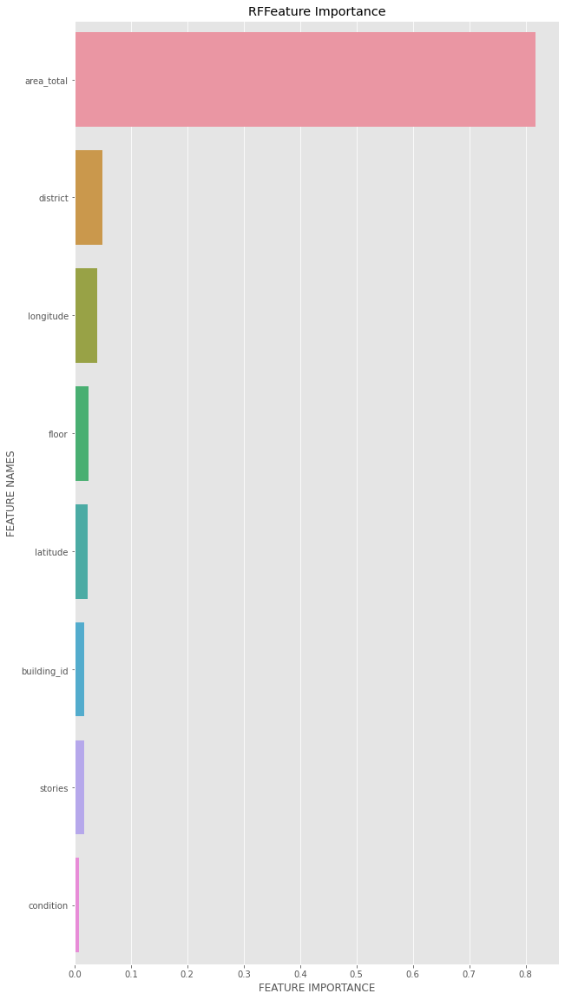

In [86]:
plot_feature_importance(best_model.feature_importances_,extract_features,'RF')

For random forrest, we tried adding more and less features - but it got the best kaggle score with this set of features, not adding too many. Our theory is that adding to many features would result in overfitting on training data, especially as we used `no early_stopping` to prevent it for random forest. We started using this later. We can see that `area_total` is the main used feature.

In [ ]:
predict_and_store(model, X_test, test, path="default", exponential=False, price_per_sq = False, total_area_df = None, exponentialm1=False)

The best score on Kaggle of this model was around 0.20.

### K nearest neighbors

This model wasn't really useful since it is a very simple one. However it was used in some bagging submissions to add some different result and help the best models in the bag. 

In [ ]:
from sklearn.neighbors import KNeighborsRegressor

features = ["area_total", "ceiling", "r", "theta", "floor", "condition", "bathrooms_shared", "parking", "stories", "rooms", "windows_street", "balconies", "elevator_without", "heating", "district", "building_id"]

model = KNeighborsRegressor(
    n_neighbors=20, 
    weights='uniform', 
    algorithm='ball_tree', 
    leaf_size=30, 
    p=1, 
    metric='minkowski', 
    metric_params=None, 
    n_jobs=None
)

Loading and cleaning of the data.

In [ ]:
train, test, metaData = load_all_data()

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features =  ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories
cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

# Normalize
train, test = normalize(train, test, float_numerical_features, scaler="minMax")
# One-hot encoding
train, test = one_hot_encoder(train, test, ["condition", "district", "material", "parking", "heating", "seller"], drop_old=True)

X_train, y_train, X_test = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features, log_targets=True, log_area=True, fillNan=True)


In [ ]:
def KNN_groupKFold(number_of_splits, model, X_train, y_train):  
    ''' y_train needs to be log. Model trains to predict logs now!'''
    X_train = X_train.copy()
    y_train = np.log(y_train.copy())
    
    scores = []
    gkf = GroupKFold(n_splits=number_of_splits)
    groups = X_train["building_id"]

    best_score = 1
    i = 0
    best_model = model
    best_index = 0

    for train_index, test_index in gkf.split(X_train, y_train, groups):
        X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]
        model.fit( X_train2, y_train2) 
        prediction =model.predict(X_test)
        score = root_mean_squared_log_error(np.exp(prediction), np.exp(y_test))
        if score <  best_score:
            best_score = score
            best_model = model
            best_index = i
        scores.append(score)
        i += 1
    return scores, np.average(scores), best_model, best_index

In [ ]:
scores, average, best_model, best_index = KNN_groupKFold(5, model, train[features], train['price'])
print(scores, average)

In [ ]:
predict_and_store(model, X_test, test, path="default", exponential=True, price_per_sq = False, total_area_df = None, exponentialm1=False)

The best score for this model was 0.33.

### LightGBM

On it's own, LightGBM was our most succesfull model, scoring at best `0.15653` on the public leaderboard.

Since LightGBM benefited enormously from hyperparameter tuning, this was handled using the state of the art **Optuna** framework. It has a bunch of optimization algorithms with early stopping and pruning features already included - ideal for this project. Even with the short runtime of lgbm, Scikit-learn random grid search with cross validation and manual looping where too time expensive.

A first tuning was done using the following parameter grid, based on suggested values found online:
```
param_grid = {
    # "device_type": trial.suggest_categorical("device_type", ['gpu']),
    "num_iterations": trial.suggest_int("num_iterations",1e2,1e5,log=True),
    "n_estimators": trial.suggest_int("n_estimators", 1e1,1e4,log=True),
    "learning_rate": trial.suggest_float("learning_rate", 0.001, 0.3,log=True),
    "num_leaves": trial.suggest_int("num_leaves", 5, 2000, step=20),
    "max_depth": trial.suggest_int("max_depth", 3, 18),
    "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 200, 10000, step=100),
    "lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=5),
    "lambda_l2": trial.suggest_int("lambda_l2", 0, 100, step=5),
    "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15),
    "bagging_fraction": trial.suggest_float(
        "bagging_fraction", 0.5, 0.95, step=0.1
    ),
    "bagging_freq": trial.suggest_int("bagging_freq", 1,11,step=1),
    "feature_fraction": trial.suggest_float(
        "feature_fraction", 0.2, 0.95, step=0.1
    ),
}
```
After more than a 100 runs the result was this:
```
Best value (rmsle): 0.26229
Best params:
    num_iterations: 405
    n_estimators: 4596
    learning_rate: 0.22799605867389866
    num_leaves: 65
    max_depth: 12
    min_data_in_leaf: 200
    lambda_l1: 80
    lambda_l2: 5
    min_gain_to_split: 2.2609116007082672
    bagging_fraction: 0.9
    bagging_freq: 7
    feature_fraction: 0.7
```
Since this was not a score we were happy with, we manually tried some parameter variation to see what worked best and tried the parameter search again. The final search used the functions below and returned this result:
```
Best value (rmse): 0.20012
Best params:
    num_iterations: 10000
    n_estimators: 152
    learning_rate: 0.05
    num_leaves: 40
    max_depth: 10
    min_data_in_leaf: 20
    bagging_fraction: 0.9
    bagging_freq: 5
    feature_fraction: 0.8
```
Note that after the tuning was done, we ended up doing some more feature engineering and added a bunch of features. This means that if there was time to do the hyperparameter tuning again, lgbm might be able to obtain even better results.

In [29]:
from optuna.integration import LightGBMPruningCallback
import lightgbm as lgbm
random_state = 1
number_of_splits = 5

def objective(trial, X, y):
    
    param_grid = {
        "num_iterations": trial.suggest_categorical("num_iterations",[10000]),
        "n_estimators": trial.suggest_int("n_estimators", 1e2,1e3,log=True),
        "learning_rate": trial.suggest_categorical("learning_rate", [0.05]),
        "num_leaves": trial.suggest_categorical("num_leaves", [40]),
        "max_depth": trial.suggest_categorical("max_depth", [10]),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 20,500, step=50),
#         "lambda_l1": trial.suggest_int("lambda_l1", 0, 100, step=5),
#         "lambda_l2": trial.suggest_int("lambda_l2", 0, 100, step=5),
#         "min_gain_to_split": trial.suggest_float("min_gain_to_split", 0, 15),
        "bagging_fraction": trial.suggest_categorical(
            "bagging_fraction",[ 0.9]
        ),
        "bagging_freq": trial.suggest_categorical("bagging_freq", [5]),
        "feature_fraction": trial.suggest_categorical(
            "feature_fraction",[0.8]
        ),
    }
    
    X_train = X
    y_train = y
    
    scores = []
        
    cv = GroupKFold(n_splits=number_of_splits)
    groups = X_train["building_id"]

    with io.capture_output() as captured:
        for train_index, test_index in cv.split(X_train, y_train, groups):
            X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
            y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]

            model = lgbm.LGBMRegressor(**param_grid, random_state=random_state,early_stopping_round=100,silent=True,metric='regression',num_threads=4)

            model.fit(
                X_train2,
                y_train2,
                eval_set=[(X_test, y_test)],
                eval_metric='rmse',
                verbose=False,
                early_stopping_rounds=100,
                callbacks = [LightGBMPruningCallback(trial, 'rmse')],
            )
            prediction = np.exp(model.predict(X_test))
            score = root_mean_squared_log_error(prediction, np.exp(y_test))
            scores.append(score)
    return np.average(scores)

study = optuna.create_study(direction="minimize", study_name="LGBM Classifier")
with io.capture_output() as captured:
    func = lambda trial: objective(trial, X_train, y_train_log)
    study.optimize(func, n_trials=20)

After the hyperparameter tuning with Optuna, we decided to decrease the `learning_rate` and  `n_estimators` accordingly. The scores (both cross validation and Kaggle) showed that a learning rate of 0.01 was about optimal. The final model we used is then shown below.

In [123]:
params= {
 'num_iterations': 10000,
 'n_estimators': 152*5,
 'learning_rate': 0.05/5,
 'num_leaves': 40,
 'max_depth': 10,
 'min_data_in_leaf': 20,
 'bagging_fraction': 0.9,
 'bagging_freq': 5,
 'feature_fraction': 0.8,
}
model = lgbm.LGBMRegressor(
    **params, 
    random_state=random_state,
    early_stopping_round=100,
    silent=True,
    metric='regression',
    num_threads=4)
model_no_cv = lgbm.LGBMRegressor(
    **params, 
    random_state=random_state,
    silent=True,
    metric='regression',
    num_threads=4)

The model also benefited from using as many features as possible. Removing even the bottom 10 features not used by the model resulted in a worse score on Cross Validation and Kaggle, which shows that it doesn't yet use the many features to overfit. 

Surprisingly, even though LightGBM offers methods of dealing with categorical data, it performed better when the categorical data was one-hot-encoded before the model was trained.

Furthermore it was important to train lgbm with price per square meter as target, and then multiply this prediction with the total area to obtain a submission, since this discovery improved our score by not allowing the model to only focus on `area_total`.

We can show how our LightGBM worked at the end. First we make sure all the data is properly loaded, all the feature engineering is included and one-hot-encoding is performed.

In [130]:
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street", "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = []

# Load data
train, test, metaData = load_all_data()
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features, log_targets=False, log_area=True, fillNan=True)
# Add new features
train_labels, test_labels, added_features = feature_engineering(
    train_labels, 
    test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    add_some_more_features=True,
    add_district_information=True,
    )

# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# One-hot encoding
train_labels, test_labels = one_hot_encoder(train_labels, test_labels, ["condition", "district", "material", "parking", "heating", "seller"], drop_old=True)
# Drop some features
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

droptable = ['street','address']
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

minMax


Then we use Cross Validation to assess the performance of the model.

In [136]:
from sklearn.model_selection import GroupKFold

def lgbm_groupKFold(number_of_splits, model, X_train, y_train,
    eval_metric=None):  
    # y_train is log!!
    X_train = X_train.copy()
    y_train = y_train.copy()
    
    scores = []
    gkf = GroupKFold(n_splits=number_of_splits)
    groups = X_train["building_id"]
    best_score = 1
    i = 0
    
    for train_index, test_index in gkf.split(X_train, y_train, groups):
        X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]
        model.fit(
            X_train2,
            y_train2,
            eval_set=[(X_test, y_test)],
            eval_metric=eval_metric,
            verbose=False,
        )    
        prediction = np.exp(model.predict(X_test))
        score = root_mean_squared_log_error(prediction, np.exp(y_test))
        if score <  best_score:
            best_score = score
            best_model = model
            best_index = i
        scores.append(score)
        i += 1
    return scores, np.average(scores), best_model, best_index

In [137]:
%%capture --no-display
price_per_square_meter = train_targets/train['area_total']
scores, average_score, best_model, best_index = lgbm_groupKFold(
    number_of_splits=number_of_splits,
    model=model,
    X_train=train_labels.drop(['area_total'],axis=1), 
    y_train=np.log(price_per_square_meter))

In [138]:
print("scores:        ", scores)
print("average score: ", average_score)

scores:         [0.19670039074832724, 0.168847392435609, 0.18999258180454692, 0.1833227696473554, 0.2145738182043432]
average score:  0.19068739056803635


This also shows how important cross validation was to properly be able to predict our score, because some splits perform way better than others.

A submission is then obtained using a model that does not do early stopping, because this requires validation data and the model became better when trained on more data.

In [140]:
def predict_and_store(model, test_labels, test_pd, path="default", exponential=False, price_per_sq = False, total_area_df = None, exponentialm1=False):
    '''
        Inputs
        - test_pd needs to be the original full test dataframe
    '''
    result = model.predict(test_labels)
    if exponential:
        result = np.exp(result)
    elif exponentialm1:
        print("expm1")
        result = np.expm1(result)
    if price_per_sq:
        result = result*total_area_df
    submission = pd.DataFrame()
    submission['id'] = test_pd['apartment_id']
    submission['price_prediction'] = result
    if len(submission['id']) != 9937:
        raise Exception("Not enough rows submitted!")
    submission.to_csv(path, index=False)

In [150]:
model_no_cv.fit(train_labels.drop(['area_total'],axis=1),np.log(price_per_square_meter))
predict_and_store(model_no_cv, test_labels.drop(['area_total'],axis=1), test, path="LGBM.csv", exponential=True, price_per_sq = True, total_area_df = test['area_total'])
# This model scored 0.15800 on Kaggle!

On Kaggle this model actually scored `0.15800` which makes it on of our **best scores!**

Because the score is so different (and much better) from the validation score, we also tested this model using Cross Validation without early stopping. We also believe that overfitting is prevented by the rest of the parameters anyway, so we don't want the model to stop too early and prevent it from learning new patterns in the data.

In [147]:
%%capture --no-display
price_per_square_meter = train_targets/train['area_total']
scores, average_score, best_model, best_index = lgbm_groupKFold(
    number_of_splits=number_of_splits,
    model=model_no_cv,
    X_train=train_labels.drop(['area_total'],axis=1), 
    y_train=np.log(price_per_square_meter))

In [148]:
print("scores:        ", scores)
print("average score: ", average_score)

scores:         [0.19573282149727395, 0.16835223423884976, 0.18894607753139217, 0.18133205443804995, 0.21487938027167652]
average score:  0.18984851359544846


We also explored the feature importance using lgbm. We continuously did this during the project, which also allowed us to isolate features that at first seemed quite unimportant but when used as a basis for creating new features allowed the model to perform even better. The feature importance of the final model (trained on all the features) is:

In [34]:
def plot_feature_importance(importance,names,model_type, figsize=(10,20)):
    
    #Create arrays from feature importance and feature names
    feature_importance = np.array(importance)
    feature_names = np.array(names)
    
    #Create a DataFrame using a Dictionary
    data={'feature_names':feature_names,'feature_importance':feature_importance}
    fi_df = pd.DataFrame(data)
    
    #Sort the DataFrame in order decreasing feature importance
    fi_df.sort_values(by=['feature_importance'], ascending=False,inplace=True)
    
    #Define size of bar plot
    plt.figure(figsize=figsize)
    #Plot Searborn bar chart
    sns.barplot(x=fi_df['feature_importance'], y=fi_df['feature_names'])
    #Add chart labels
    plt.title(model_type + 'Feature Importance')
    plt.xlabel('FEATURE IMPORTANCE')
    plt.ylabel('FEATURE NAMES')

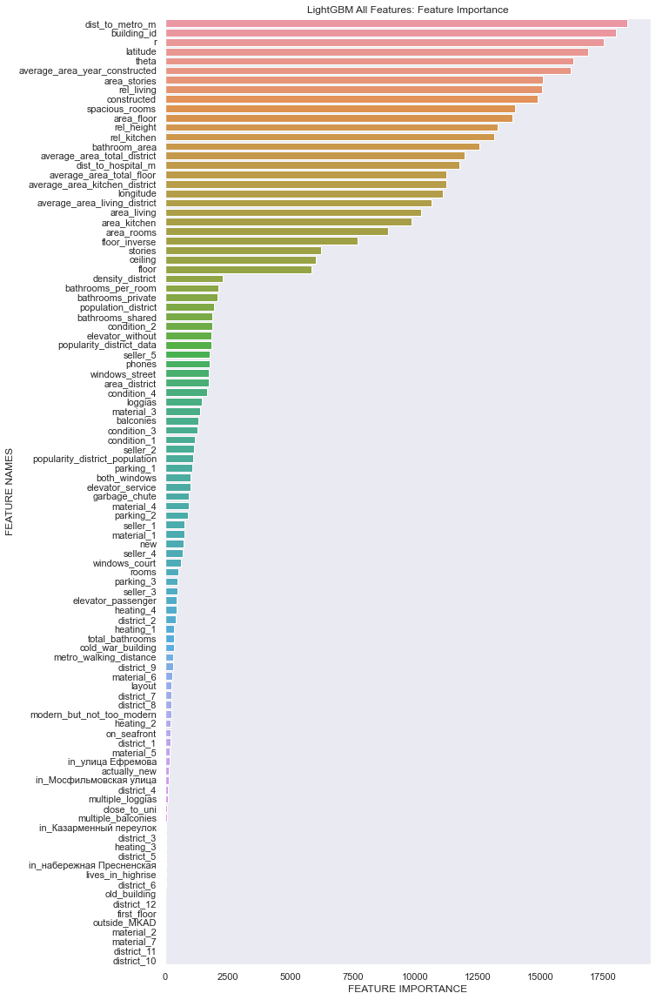

In [156]:
lgbm_importances = model_no_cv.feature_importances_
plot_feature_importance(lgbm_importances, list(train_labels.drop(['area_total'],axis=1).columns), 'LightGBM All Features: ')

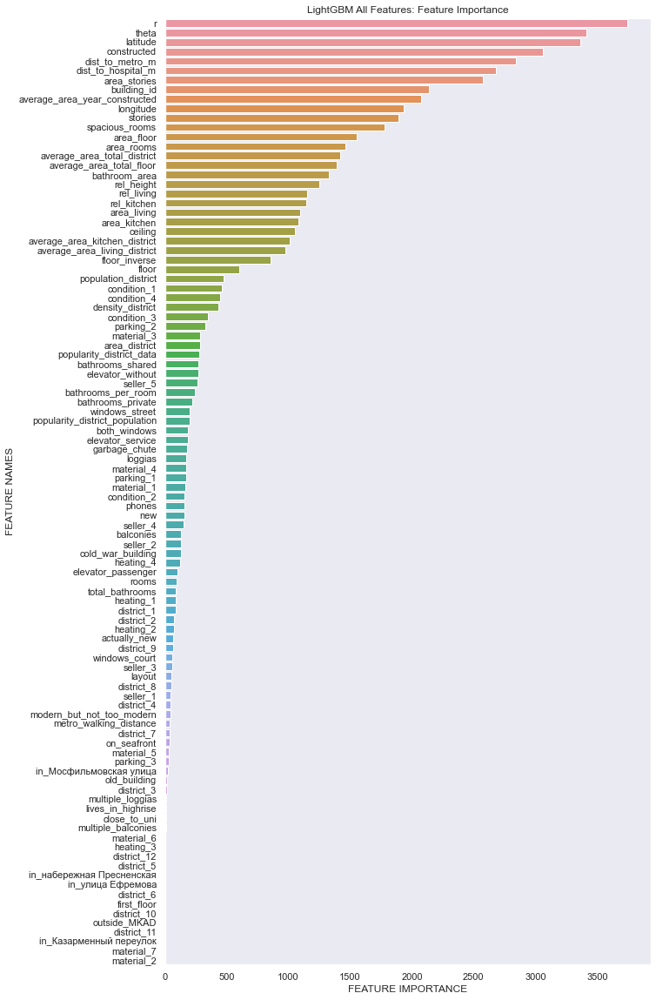

In [155]:
lgbm_importances = model.feature_importances_
plot_feature_importance(lgbm_importances, list(train_labels.drop(['area_total'],axis=1).columns), 'LightGBM All Features: ')

We can see that the model develops different feature importances when it is trained on the entire dataset versus on only the 80% accessible during cross validation. This difference might also help explain the difference in scoring between Kaggle and cross validation.
Note also that the model bases itself on `building_id`! We already know there is no overlap in `building_id` between the training and testing dataset, so we can expect a model that does not use this to perform even better. We tested this hypothesis and did indeed obtain a **better submission**! It's Kaggle score was `0.15623`.

In [161]:
%%capture --no-display
price_per_square_meter = train_targets/train['area_total']
scores, average_score, best_model, best_index = lgbm_groupKFold(
    number_of_splits=number_of_splits,
    model=model_no_cv,
    X_train=train_labels.drop(['area_total'],axis=1), 
    y_train=np.log(price_per_square_meter))

In [162]:
print("scores:        ", scores)
print("average score: ", average_score)

scores:         [0.19573282149727395, 0.16835223423884976, 0.18894607753139217, 0.18133205443804995, 0.21487938027167652]
average score:  0.18984851359544846


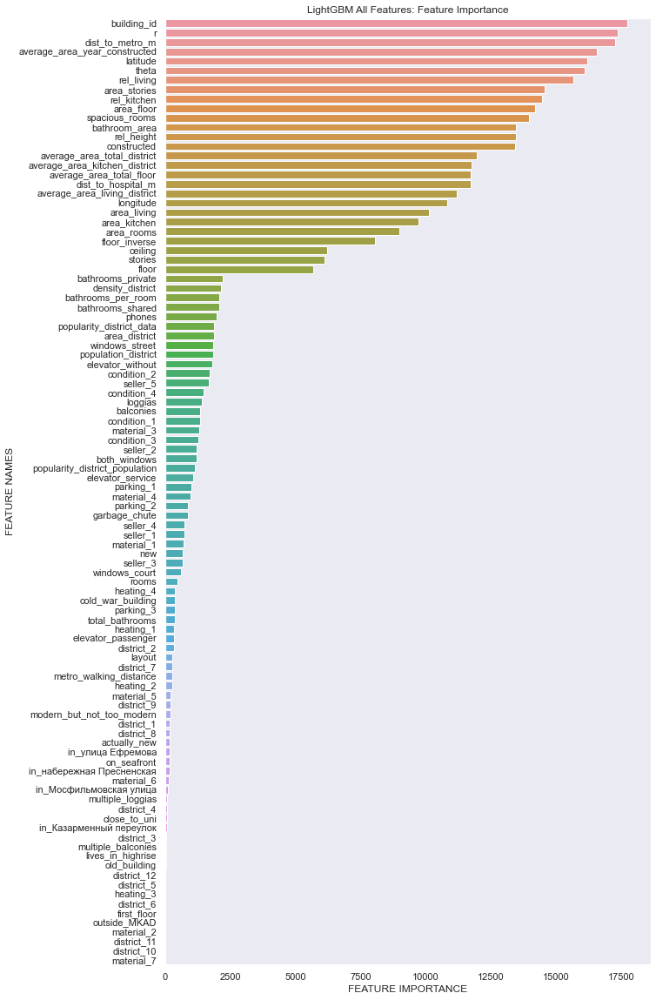

In [163]:
lgbm_importances = model_no_cv.feature_importances_
plot_feature_importance(lgbm_importances, list(train_labels.drop(['area_total'],axis=1).columns), 'LightGBM All Features: ')

In [158]:
model_no_cv.fit(train_labels.drop(['area_total','building_id'],axis=1),np.log(price_per_square_meter))
predict_and_store(model_no_cv, test_labels.drop(['area_total','building_id'],axis=1), test, path="LGBM_2.csv", exponential=True, price_per_sq = True, total_area_df = test['area_total'])
# This model scored 0.15623 on Kaggle!

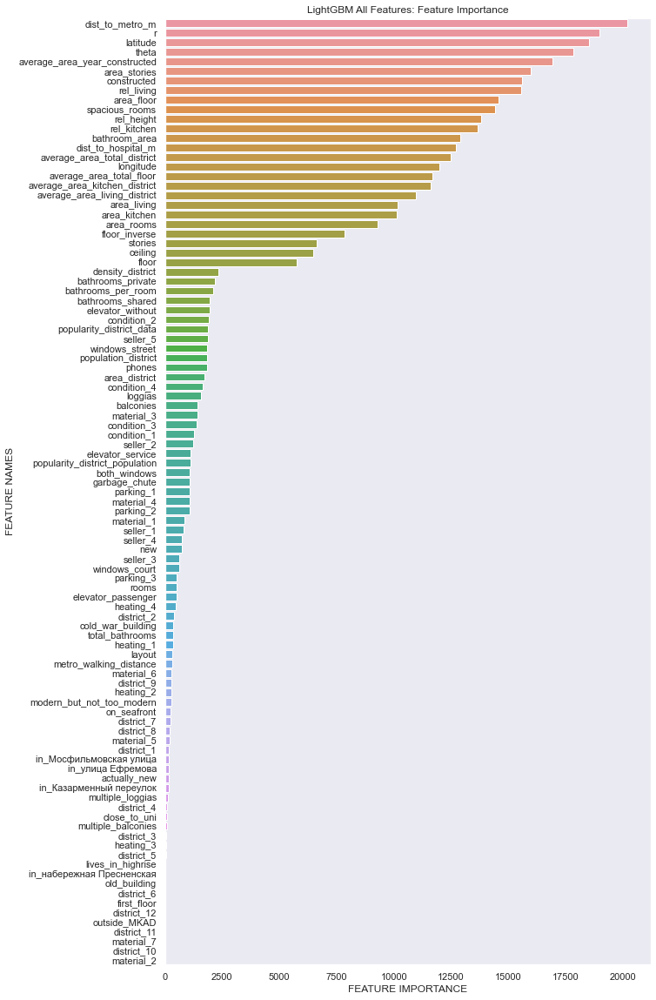

In [160]:
lgbm_importances = model_no_cv.feature_importances_
plot_feature_importance(lgbm_importances, list(train_labels.drop(['area_total','building_id'],axis=1).columns), 'LightGBM All Features: ')

### Gradient Boosting

Scikit-learn's `GradientBoostingRegressor` is a very well known implementation of a Gradient Boosting Machine and thus was also tried and tested - and it quite matched our expectations. In the beginning of the semester we made a gradient boost submission on only *nine* features, namely the following: `['area_total','area_kitchen','floor','bathrooms_private', 'longitude','latitude','district','constructed','stories']` and this submission (`submission.csv`) had a score of `0.19968` on the public leaderboard.

The model used to obtain this score was the following:

In [165]:
from sklearn.ensemble import GradientBoostingRegressor

In [166]:
grad_boost_regr = GradientBoostingRegressor(
    learning_rate=0.01,
    n_estimators=2000,
    subsample=1.0, 
    criterion='mse', 
    min_samples_split=4, 
    min_samples_leaf=2, 
    min_weight_fraction_leaf=0.0, 
    max_depth=9, 
    min_impurity_decrease=0.0, 
    init=None, 
    random_state=0, 
    max_features=None,
    alpha=0.9,
    verbose=0,
    max_leaf_nodes=None,
    warm_start=False,
    validation_fraction=0.1,
    n_iter_no_change=None,
    tol=0.0001,
    ccp_alpha=0.0
)

It was then also very important to find a way to tune `GradientBoostingRegressor`. However, the model takes a very long time to train, so using external functions such as grid search or even the preferred Optuna were not very feasible. We then tried a manual tuning process to obtain (hopefully) optimal hyperparameters. We are aware that doing this in an iterative manner opens the way for ending up in local optima instead of a global optimum, but we decided this was an acceptable trade-off for the saved computation power and time.

Note this tuning was also done with minimal extra features added (all the given features were taken into account, as well as `r` and `theta`, plus the features pertaining to the relative height of the apartment.

We started with an extremely simple model and a standard high learning rate of 0.1:

In [173]:
gb1 = GradientBoostingRegressor(
    learning_rate = 0.1,
    loss = 'squared_error',
    criterion = 'squared_error',
    verbose = 0,
    warm_start = False,
    random_state=random_state
)

We then tried to determine an optimum number of trees corresponding to this learning rate. To this goal we created the code above. Unfortunately the score was *still* improving with increasing number of trees. Because at this point we were hoping to keep the computation time slightly down, we kept this as the current optimal value for `n_estimators`.

In [170]:
n_estimators = np.linspace(10,300,20).astype(int)

best_average_score = 1

for n_est in n_estimators:
    print("current number of trees: ", n_est)
    params = dict(n_estimators = n_est)
    model = GradientBoostingRegressor(
                **params,
                learning_rate = 0.1,
                loss = 'squared_error',
                criterion = 'squared_error',
                verbose = 0,
                warm_start = False,
                random_state = random_state,
            )
    scores, average_score, _, _ = gradient_boost_groupKFold(number_of_splits=number_of_splits,
                                                            model=model,
                                                            X_train=X_train, 
                                                            y_train=y_train_log
                                                            )
    print(average_score)
    if average_score < best_average_score:
        best_average_score = average_score
        best_params = params
        print(">>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>><<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<")
        print("scores: ", scores)
        print("average score: ", average_score)
        print("parameters: ", best_params)

In [172]:
optimal_n_estimators = 300

We then went ahead tuning the tree-specific parameters: `max_depth` & `min_samples_split`

In [ ]:
max_depth = np.arange(start=4,stop=16,step=2).astype(int)
min_samples_split = np.logspace(1, 4, num=7, endpoint=True).astype(int)

best_average_score = 1

for m_depth in max_depth:
    for m_s_split in min_samples_split:
        print("       -----------------       ")
        print("current max depth:         ", m_depth)
        print("current min samples split: ", m_s_split)
        params = dict(
            max_depth = m_depth,
            min_samples_split = m_s_split,
        )
        model = GradientBoostingRegressor(
                    **params,
                    n_estimators = optimal_n_estimators,
                    learning_rate = 0.1,
                    loss = 'squared_error',
                    criterion = 'squared_error',
                    verbose = 0,
                    warm_start = False,
                    random_state = random_state,
                )
        scores, average_score, _, _ = gradient_boost_groupKFold(number_of_splits=number_of_splits,
                                                                model=model,
                                                                X_train=X_train, 
                                                                y_train=y_train_log
                                                                )
        print(average_score)
        if average_score < best_average_score:
            best_average_score = average_score
            best_params = params
            print(">>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>><<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<<")
            print("scores: ", scores)
            print("average score: ", average_score)
            print("parameters: ", best_params)

**Result:** 
```
scores:  [0.20500680772749033, 0.20547976952996316, 0.17665855113277418, 0.20171066397528792, 0.22715854765728632]
average score:  0.2032028680045604
parameters:  {'max_depth': 14, 'min_samples_split': 1000}
```

Because an optima always occurred for `min_samples_split = 1000`, we tried some more variations of the `max_depth` around this value. We finally arived at an intermediate score of `0.20272` for `max_depth = 13` 

In [174]:
optimal_max_depth = 13
optimal_min_samples_split = 1000

We then tuned `optimal_min_samples_leaf` in the exact same manner. The score ended up being lowest for a value of 1 (`0.2032028680045604`) but the score for a value of 40 was very similar (`0.20446437151272606`) so we chose the highest value to combat overfitting.

In [175]:
optimal_min_samples_leaf = 40

We then went on to `max_features` which had an optimum at 40, and finally `subsample` which was best kept at 1.0.

In [176]:
optimal_max_features = 40
optimal_subsample = 1.0

The resulting model had a score of `0.20343` on cross validation and is shown below.

In [177]:
model = GradientBoostingRegressor(
            n_estimators = optimal_n_estimators,
            max_depth = optimal_max_depth,
            min_samples_split = optimal_min_samples_split,
            min_samples_leaf = optimal_min_samples_leaf,
            max_features = optimal_max_features,
            subsample = optimal_subsample,
            learning_rate = 0.1,
            loss = 'squared_error',
            criterion = 'squared_error',
            verbose = 0,
            warm_start = False,
            random_state = random_state,
        )

We then decreased the learning rate and increased the number of trees respectively.

The following learning rates and number of estimators were tried:

| `learning_rate`   |      `n_estimators`      |  average cv score |
|----------|:-------------:|------:|
| 0.05 |  600 |0.20310 |
| 0.01 |    3000   | 0.20126|

Because of the computation time (and because this was a reasonable score on those features) we decided to keep these parameters, even though the Kaggle score was slightly worse than expected (submission `GB3.0.csv` scored `0.22481`)

However, the score improved a lot after adding more features and predicting price per square meter instead of price directly. Gradient boost also benefited from one-hot-encoding.

The following code was used to implement cross validation and obtain submissions.

In [183]:
def gradient_boost_groupKFold(number_of_splits, model, X_train, y_train):
    X_train = X_train.copy()
    y_train = y_train.copy()

    scores = []
    gkf = GroupKFold(n_splits=number_of_splits)
    groups = X_train["building_id"]
    best_score = 1
    i = 0

    for train_index, test_index in gkf.split(X_train, y_train, groups):
        print('starting on split ',i+1,' of cross validation')
        X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]
        model.fit(
            X_train2,
            y_train2,
        )    
        prediction = np.exp(model.predict(X_test))
        score = root_mean_squared_log_error(prediction, np.exp(y_test))
        if score <  best_score:
            best_score = score
            best_model = model
            best_index = i
        scores.append(score)
        i += 1
    return scores, np.average(scores), best_model, best_index

In [180]:
optimal_n_estimators = 300
optimal_max_depth = 13
optimal_min_samples_split = 1000
optimal_min_samples_leaf = 40
optimal_max_features = 40
optimal_subsample = 0.95
original_learning_rate = 0.1

model = GradientBoostingRegressor(
            n_estimators = optimal_n_estimators*10,
            max_depth = optimal_max_depth,
            min_samples_split = optimal_min_samples_split,
            min_samples_leaf = optimal_min_samples_leaf,
            max_features = optimal_max_features,
            subsample = optimal_subsample,
            learning_rate = original_learning_rate / 10,
            loss = 'squared_error',
            criterion = 'squared_error',
            verbose = 0,
            warm_start = False,
            random_state = random_state,
        )

model_no_cv = GradientBoostingRegressor(
            n_estimators = optimal_n_estimators*10,
            max_depth = optimal_max_depth,
            min_samples_split = optimal_min_samples_split,
            min_samples_leaf = optimal_min_samples_leaf,
            max_features = optimal_max_features,
            subsample = optimal_subsample,
            learning_rate = original_learning_rate / 10,
            loss = 'squared_error',
            criterion = 'squared_error',
            verbose = 0,
            warm_start = False,
            random_state = random_state,
        )

In [182]:
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street", "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = []

# Load data
train, test, metaData = load_all_data()
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features, log_targets=False, log_area=True, fillNan=True)
# Add new features
train_labels, test_labels, added_features = feature_engineering(
    train_labels, 
    test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    )

# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# One-hot encoding
train_labels, test_labels = one_hot_encoder(train_labels, test_labels, ["condition", "district", "material", "parking", "heating", "seller"], drop_old=True)
# Drop some features
droptable = ['street','address']
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

minMax


In [ ]:
scores, average_score, best_model, best_index = gradient_boost_groupKFold(number_of_splits=number_of_splits,
                                                        model=model,
                                                        X_train=train_labels.drop(['area_total','building_id'], 
                                                        y_train=np.log(train_targets)
                                                        )

In [ ]:
print("scores:        ", scores)
print("average score: ", average_score)

Two of the important gradient boost submissions were `GB5.0.csv` and `GB5.1.csv` because they used the exact same features but `GB5.1.csv` predicted the price per square meter and scored `0.17172` as oposed to `0.17661`.

The final submission is the one made below, which is allowed to use every one of the features we developed and of course predicts price per area. It scored `0.16401` on Kaggle. So although slightly worse than LightGBM, also performs very well.

Below we also plot the feature importance and noticable is that it both uses different and a lot less features heavily compared to lgbm. However, the score still improved when adding the extra features.

In [189]:
model_no_cv.fit(train_labels.drop(['area_total','building_id'],axis=1),np.log(price_per_square_meter))
predict_and_store(model_no_cv, test_labels.drop(['area_total','building_id'],axis=1), test, path="GB.csv", exponential=True, price_per_sq = True, total_area_df = test['area_total'])

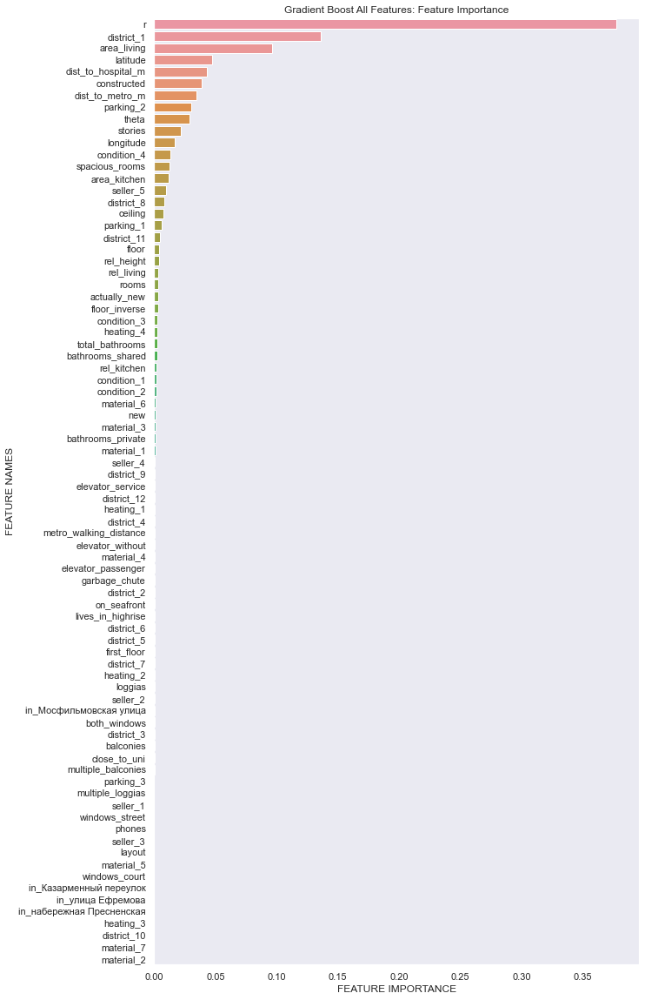

In [188]:
gradient_boost_importances = model_no_cv.feature_importances_
plot_feature_importance(gradient_boost_importances, list(train_labels.drop(['building_id','area_total'],axis=1).columns), 'Gradient Boost All Features: ')

### CatBoost

CatBoost was also tuned using Optuna, on only the most important and the categorical features. The code can be found below.

In [18]:
from catboost import CatBoostRegressor
import optuna
from optuna.samplers import TPESampler

selected_features_catboost=['building_id','area_kitchen', 'area_living',
       'rooms', 'ceiling', 'bathrooms_shared', 'bathrooms_private',
       'windows_court', 'windows_street', 'balconies', 'loggias', 'phones',
       'new', 'street', 'address', 'seller', 'layout', 'condition', 'district',
       'constructed', 'stories', 'elevator_without', 'elevator_passenger',
       'material', 'parking', 'heating', 'r', 'rel_height']

X_train = train_labels[selected_features_catboost]
test_labels = test_labels[selected_features_catboost]
categorical = ['street','address','seller','layout','condition','district','material','parking','heating']

X_train = X_train.astype({'street':'int','address':'int','seller':'int','layout':'int','condition':'int','district':'int','material':'int','parking':'int','heating':'int'})
test_labels = test_labels.astype({'street':'int','address':'int','seller':'int','layout':'int','condition':'int','district':'int','material':'int','parking':'int','heating':'int'})

def objective(trial,X_train,y_train):
    
    param = {
        "learning_rate": trial.suggest_loguniform("learning_rate", 1e-5, 1e-1),
        "l2_leaf_reg": trial.suggest_loguniform("l2_leaf_reg", 1e-2, 1e0),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.1),
        "depth": trial.suggest_int("depth", 1, 10),
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical("bootstrap_type", ["Bayesian", "Bernoulli", "MVS"]),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 2, 20),
        "one_hot_max_size": trial.suggest_int("one_hot_max_size", 2, 20),  
    }
    # Conditional Hyper-Parameters
    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    scores = []
        
    cv = GroupKFold(n_splits=number_of_splits)
    groups = X_train["building_id"]
    i = 1
    for train_index, test_index in cv.split(X_train, y_train, groups):
        print("starting on split ",i)
        i+=1
        X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]
        X_train2.drop(['building_id'], axis=1,inplace=True)
        X_test.drop(['building_id'], axis=1,inplace=True)

        model = CatBoostRegressor(**param, random_state=random_state,loss_function='RMSE', cat_features=categorical)
        
        model.fit(
            X_train2,
            y_train2,
            eval_set=[(X_test, y_test)],
            verbose=False,
            early_stopping_rounds=100,
        )
        
        prediction = np.exp(model.predict(X_test))
        score = root_mean_squared_log_error(prediction, np.exp(y_test))
        scores.append(score)
    return np.average(scores)

study = optuna.create_study(sampler=TPESampler(), direction="minimize")
func = lambda trial: objective(trial, X_train, y_train_log)
study.optimize(func, n_trials=10, timeout=600) # Run for 10 minutes
print("Number of completed trials: {}".format(len(study.trials)))
print("Best trial:")
trial = study.best_trial

print("\tBest Score: {}".format(trial.value))
print("\tBest Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))
    
study.optimize(func, n_trials=1000)

print("Number of completed trials: {}".format(len(study.trials)))
print("Best trial:")
trial = study.best_trial

print("\tBest Score: {}".format(trial.value))
print("\tBest Params: ")
for key, value in trial.params.items():
    print("    {}: {}".format(key, value))

We let the Optuna trials run for an entire night, in which it completed about 460 trials, and in the morning evaluated the results.

I've selected 5 trials to discuss the tuning, they are ordered by improving score:

Trial 449 finished with value: ```0.5542284052526306``` and parameters: ```{'learning_rate': 0.0009728418109572844, 'l2_leaf_reg': 0.30051036860892455, 'colsample_bylevel': 0.08816379281516293, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS', 'min_data_in_leaf': 16, 'one_hot_max_size': 9}.```

Trial 457 finished with value: ```0.26187749686179945``` and parameters: ```{'learning_rate': 0.058062306498398955, 'l2_leaf_reg': 0.36115004854385463, 'colsample_bylevel': 0.09228172758947267, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS', 'min_data_in_leaf': 12, 'one_hot_max_size': 11}.``` 

Trial 438 finished with value: ```0.26035104710375645``` and parameters: ```{'learning_rate': 0.07979622203930528, 'l2_leaf_reg': 0.4434173979295824, 'colsample_bylevel': 0.08605288211758522, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS', 'min_data_in_leaf': 17, 'one_hot_max_size': 11}.``` 

Trial 446 finished with value: ```0.26033042130942874``` and parameters:``` {'learning_rate': 0.07608938488623739, 'l2_leaf_reg': 0.36052283914139044, 'colsample_bylevel': 0.09183053727905705, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS', 'min_data_in_leaf': 17, 'one_hot_max_size': 10}.```

Trial 437 finished with value: ```0.2596557027450385``` and parameters: ```{'learning_rate': 0.0772446776104594, 'l2_leaf_reg': 0.5709519938247928, 'colsample_bylevel': 0.09221911838854839, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS', 'min_data_in_leaf': 17, 'one_hot_max_size': 11}.```


From this it is obvious that:
* decreasing the learning rate too much results in terrible performance
* Optimal learning rate should be searched around 0.07-0.08
* `bootstrap_type` `MVS` seems to be prefferred over both `Bernoulli` and `Bayesian`
* `boosting_type` `Plain` seems to be preffered
* `l2_leaf_reg`: typically around 0.36-0.44 but best score has 0.57
* `colsample_bylevel`: between 0.086-0.092
* `depth`: always 9
* `min_data_in_leaf`: 17 selected most often
* `one_hot_max_size`: 9-11

The cross validation score with these parameters was around `0.2597`. However, when actually using the model, we did feed it all possible data, and obtained much better scores. Obviously, since CatBoost is known for how it intelligently handles categorical data, we did not use one-hot-encoding on the datasets.

In [19]:
def catboost_groupKFold(number_of_splits, model, X_train, y_train, categorical_features=[],text_features=[],random_state=1):
    scores = []
        
    cv = GroupKFold(n_splits=number_of_splits)
    
    groups = X_train["building_id"]
    best_score = 1
    i = 1
    
    for train_index, test_index in cv.split(X_train, y_train, groups):
        print("starting on split ",i)
        i+=1
        X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]
        X_train2.drop(['building_id'], axis=1,inplace=True)
        X_test.drop(['building_id'], axis=1,inplace=True)
        
        model.fit(
            X_train2,
            y_train2,
            eval_set=[(X_test, y_test)],
            verbose=False,
            early_stopping_rounds=100,
        )
        prediction = np.exp(model.predict(X_test))
        score = root_mean_squared_log_error(prediction, np.exp(y_test))
        if score <  best_score:
            best_score = score
            best_model = model
            best_index = i
        scores.append(score)
    return scores, np.average(scores), best_model, best_index

In [20]:
from catboost import CatBoostRegressor

best_params = {
    'learning_rate': 0.0772446776104594, 
    'l2_leaf_reg': 0.5709519938247928, 
    'colsample_bylevel': 0.09221911838854839, 
    'depth': 9, 
    'boosting_type': 'Plain', 
    'bootstrap_type': 'MVS', 
    'min_data_in_leaf': 17, 
    'one_hot_max_size': 11}
model = CatBoostRegressor(**best_params, random_state=42,loss_function='RMSE', cat_features=cat_features)

In [23]:
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street", "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = []

# Load data
train, test, metaData = load_all_data()
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features, log_targets=False, log_area=True, fillNan=True)
# Add new features
train_labels, test_labels, added_features = feature_engineering(
    train_labels, 
    test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    )

# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# One-hot encoding
    # train_labels, test_labels = one_hot_encoder(train_labels, test_labels, ["condition", "district", "material", "parking", "heating", "seller"], drop_old=True)
# Drop some features
droptable = ['street','address']
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

minMax


In [24]:
cat_dict = {}
for feature in cat_features:
    cat_dict[feature] = 'int'
train_labels = train_labels.astype(cat_dict)
test_labels = test_labels.astype(cat_dict)

In [26]:
price_per_square_meter = train_targets/train['area_total']

In [33]:
scores, average_score, best_model, best_index = catboost_groupKFold(
    number_of_splits=number_of_splits,
    model=model, 
    X_train=train_labels.drop(['area_total'],axis=1),
    y_train=np.log(price_per_square_meter),
    categorical_features=cat_features,
    random_state=random_state)

In [31]:
print("scores:        ", scores)
print("average score: ", average_score)

scores:         [0.19386659150737875, 0.1721157921816474, 0.19598522311185917, 0.18375059377727215, 0.22271521980563994]
average score:  0.19368668407675949


The best CatBoost submission is shown below and scored `0.16264`.

In [ ]:
model.fit(train_labels.drop(['area_total','building_id'],axis=1),np.log(price_per_square_meter))
predict_and_store(model, test_labels.drop(['area_total','building_id'],axis=1), test, path="CatBoost.csv", exponential=True, price_per_sq = True, total_area_df = test['area_total'])

We also tried training it on less features, but the performance became worse, even when only selecting the features that were not used at all according to feature importance. 

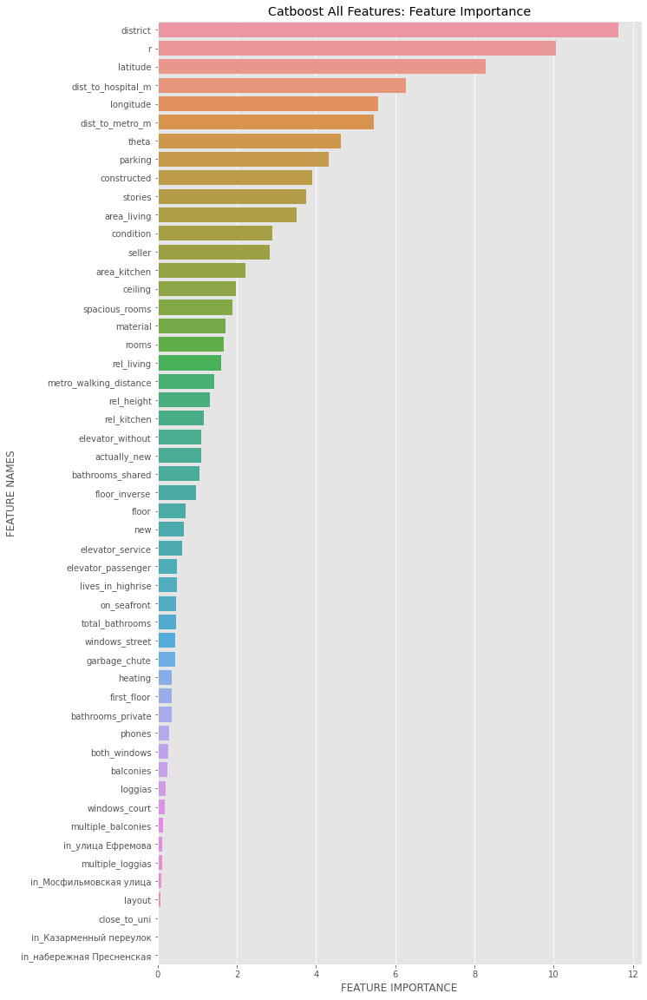

In [35]:
catboost_importances = model.feature_importances_
plot_feature_importance(catboost_importances, list(train_labels.drop(['area_total','building_id'],axis=1).columns), 'Catboost All Features: ')

### AdaBoost

We also tried AdaBoost but it was immediately outperformed by almost every other model and was dropped very early in the semester. Below is the model and hyperparameters we used.

In [36]:
from sklearn.ensemble import AdaBoostRegressor

adaboost = AdaBoostRegressor(
    n_estimators=1500,
    learning_rate=0.05,
    loss='exponential',
    random_state=42
)

In [37]:
# Import data without one hot encoding
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street", "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = []

# Load data
train, test, metaData = load_all_data()
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features, log_targets=False, log_area=True, fillNan=True)
# Add new features
train_labels, test_labels, added_features = feature_engineering(
    train_labels, 
    test_labels,
    add_base_features=True, 
    add_bool_features=False,
    add_weak_features=False,
    add_dist_to_metro=False,
    add_close_to_uni=False,
    add_dist_to_hospital=False,
    add_floor_features=False,
    add_street_info=False,
    add_some_more_features=False,
    add_district_information=False,
    )

# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# One-hot encoding
    # train_labels, test_labels = one_hot_encoder(train_labels, test_labels, ["condition", "district", "material", "parking", "heating", "seller"], drop_old=True)
# Drop some features
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

droptable = ['street','address']
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

minMax


In [38]:
selected_features = ['area_total','r','floor','district','parking']

In [40]:
X_train, X_test, y_train, y_test = train_test_split(train_labels, train_targets, test_size=0.2, random_state=42)
adaboost.fit(X_train[selected_features], y_train)
ada_prediction = adaboost.predict(X_test[selected_features])
ada_rmsle = root_mean_squared_log_error(y_test, ada_prediction)
print('Adaboost RMSLE:', ada_rmsle)

Adaboost RMSLE: 1.5905772894777979


In [41]:
X_train, X_test, y_train, y_test = train_test_split(train_labels, train_targets, test_size=0.2, random_state=42)
adaboost.fit(X_train[selected_features], np.log(y_train))
ada_prediction = np.exp(adaboost.predict(X_test[selected_features]))
ada_rmsle = root_mean_squared_log_error(y_test, ada_prediction)
print('Adaboost RMSLE:', ada_rmsle)

Adaboost RMSLE: 0.3873905097079976


When trained on only five features, the predicted score was around `1.5906`. Note that we show the training and predicting using only five features because the predicted score was even worse when using all the features available. It was possible to improve the score quite a bit predicting on the log of the price instead of the price directly (as shown below using the log allows the model to benefit from more features), but we did not think this model would really outperform any of the others, especially because our data is inherently noisy.

In [42]:
X_train, X_test, y_train, y_test = train_test_split(train_labels, train_targets, test_size=0.2, random_state=42)
adaboost.fit(X_train, np.log(y_train))
ada_prediction = np.exp(adaboost.predict(X_test))
ada_rmsle = root_mean_squared_log_error(y_test, ada_prediction)
print('Adaboost RMSLE:', ada_rmsle)

Adaboost RMSLE: 0.33967003044635674


Looking at the feature importance below it is also obvious that adaboost is a very selective model that doesn't utilize all possible features.

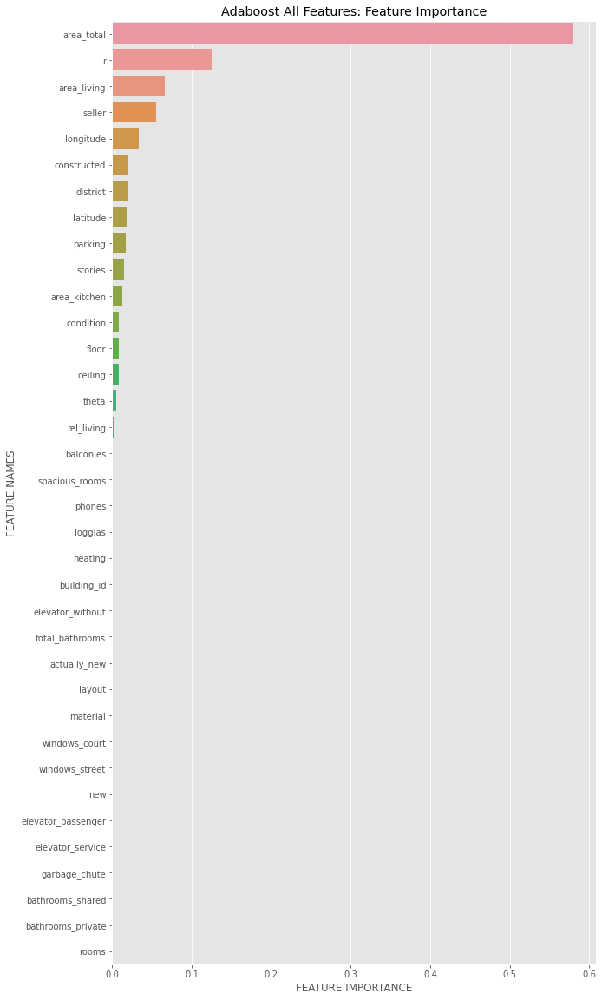

In [43]:
adaboost_importances = adaboost.feature_importances_
plot_feature_importance(adaboost_importances, list(train_labels.columns), 'Adaboost All Features: ')

### Support Vector Regression

We also tried our hand at some SVR using the Sklearn libraries. However, for all three kernels, the model performed quite terribly, thus we did not continue exploring this further.

In [190]:
from sklearn.svm import SVR
svr_rbf = SVR(kernel='rbf')
svr_lin = SVR(kernel='linear')
svr_poly = SVR(kernel='poly')

For all given features + `r` and `theta`, the scores were around (without using cross validation):
> RBF RMSLE: 0.8873730041998729\
> Polynomial RMSLE: 0.887365659487154\
> Linear RMSLE: 0.4533829312894586

We also plotted the feature importance for the linear kernel (which performed best) and saw that it only really based itself on `area_total`, `area_living`, `stories`, `floor` and `r`.

### Artificial neural network

We wanted to make a different model, that would hopefully be able to do different errors than the other models. This will be very important in the ensemble part, as the adding models to a stack or a bag will only be useful if they "think" differently from the others. Imagine having five friends all giving you the same advise: is it good advise, or have you just gotten a lot of similar friends? Hard to tell...

In [68]:
from tensorflow.keras import metrics, losses, callbacks
from tensorflow import nn
from tensorflow.keras import backend as K
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Dropout
import tensorflow

The deep anns of keras has no built in RMSLE loss, so we created our own. Alternatively we could just have trained on the log(price) like some of the other models do.

In [46]:
def rmsle_custom(y_true, y_pred):
    msle = losses.MeanSquaredLogarithmicError()
    return K.sqrt(msle(y_true, y_pred))

A classic function to track progress of training, as it can be slow sometimes.

In [49]:
class PrintDot(callbacks.Callback):
    def on_epoch_end(self, epoch, logs):
        if epoch % 100 == 0: print('')
        print('.', end='')

Grouped KFOLD for ANN, pretty similar to the other ones.

`strict_restart` is used to re-run a fold, in case the model crashes - as it often does.

In [71]:
def ANN_groupKFold(number_of_splits, model_params, X_train, y_train, strict_restart=False):  
    ''' y_train needs not to be log: as we got the RMSLE loss function for ANN!'''
    X_train = X_train.copy()
    y_train = y_train.copy()
    
    gkf = GroupKFold(n_splits=number_of_splits)
    groups = X_train["building_id"]
    best_score = 10
    i = 0
    ann_scores = []
    hists=[]
    models=[]
    for train_index, test_index in gkf.split(X_train, y_train, groups):
        not_good_enough=True
        while not_good_enough:
            X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
            y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]
            
            # We don't need it anymore.
            X_train2 = X_train2.drop(["building_id"], axis=1)
            X_test = X_test.drop(["building_id"], axis=1)
            
            model = create_ANN_model(*model_params)
            early_stop = callbacks.EarlyStopping(monitor='val_loss', verbose=1, mode='min', patience=40)

            history = model.fit(x=X_train2, y=y_train2.values,
            validation_data=(X_test, y_test),
            verbose=0, epochs=1000, callbacks=[early_stop, PrintDot()]
            )

            if strict_restart and (history.history["val_loss"][-1]>0.4):
                print("strict restart!")
                continue
            else:
                not_good_enough=False

            ann_score = history.history["val_loss"][-1]
            ann_scores.append(ann_score)
            hists.append(history)
            models.append(model)
            if ann_score <  best_score:
                print("New best model!")
                best_score = ann_score
                best_model = model
            i += 1
            
    return ann_scores, models, best_model, hists

In [69]:
def create_ANN_model(dense_layers=[64, 64, 64], activation=nn.leaky_relu,
                     dropout=[False, False, False], dropout_rate=0.2, optimizer="adamn", #'adamn'
                      loss_function=rmsle_custom, metrics=['accuracy'], output_activation=True
                      ):
    # Model
    model = tensorflow.keras.Sequential()
    for i, n in enumerate(dense_layers):
        model.add(Dense(n, activation=activation))
        if dropout[i]:
            model.add(Dropout(dropout_rate))
    
    if output_activation:
        model.add(Dense(1, activation=nn.relu))
    else:
        model.add(Dense(1)) #Output

    # Optimized for reducing msle loss.
    model.compile(optimizer=optimizer, 
                loss=loss_function, #'msle', 'rmse', RMSLETF, rmsle_custom
                metrics=metrics) # metrics=['mse', 'msle'] metrics=[tf.keras.metrics.Accuracy()]

    return model

In [72]:
# ALL, and building ID!
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street"] # , "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

**Feature selection for ANN**

Unlike the for some of the boosting models, the ANN is quite sensitive to adding new features. Especially features that are heavily correlated to each other. One of the advantages of ANN is being able to see patterns itself, without us having to give it new features specifcally. Given enough data and depth of course... That is why we dropped all features that were more correlated to each other than to the target itself. Also, we drop features with less than 0.1 correlation to price, as we alrady have so many features to train on.

In [73]:
## Drop the worst stuff
droptable = ["bathrooms_private", "bathrooms_shared","longitude", "latitude", "area_kitchen", "area_living",  # Dropped cuz they correlate too much with other features
            "theta", "loggias", "elevator_passenger", "layout", "phones", "windows_court", "balconies", "garbage_chute", "new",  # Dropped cuz they suck
             "heating", "windows_street", "loggias", "elevator_service", "street"]

In [55]:
# Load data
train, test, metaData = load_all_data()
# Clean data
%%capture --no-display
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=False, log_area=False, fillNan=True)

UsageError: Line magic function `%%capture` not found.


In [59]:
train_labels, test_labels, added_features = feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=False,
    add_weak_features=False,
    add_dist_to_metro=False,
    add_close_to_uni=False,
    add_dist_to_hospital=False,
    add_floor_features=False,
    add_street_info=True,
    )

In [60]:
# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")

minMax


In [61]:
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

**One hot encoding for ANN model**

Seemed to have a pretty big effect. This makes sense, as the categorical data we are working with here is non-ordinal, and with a linear regressor (which anns are built of) the unlinear nature of the non-ordinal data would require a lot of work to discover, while feeding it simple booleans is a lot more effective.

In [62]:
train_labels, test_labels = one_hot_encoder(train_labels, test_labels,
                                            ["condition", "district", "material", "parking", "seller"], drop_old=True)

**Predict on price/area**

Like many of our other models, `removing area_total` from the training data, and predicting on price/area instead made the score a lot better. With area_total in the picture, the models seemed to focus too much on the this feature and nothing else - becomming lazy.

In [63]:
price_per_square_meter = train_targets/train['area_total']

**Where did these model params come from?**

We did not spend a lot of time tuning the ANN, and did it mostly manually but we found these general observations:
- Adding more layers, and especially more depth the network would overfit and get a worse validation score.
- Adding regularization (being dropout layers), would improve the deepest models, but make the shallow models worse.
- Using a leaky relu to some layers did not relly affect the end score.
- Adding a relu on the output layer ensured we would of course only get predictins above zero, which is nice.
- Deeper nets were waaay slower to train, and its benefits were sacrificed for a quicker training instead.

In [74]:
model_params = ([18, 18, 18], nn.relu,
                     [False, False, False], 0.2, 'adam',
                      rmsle_custom, ['mse', 'msle', metrics.Accuracy()], True)

In [75]:
ann_scores, models, best_model, hists = ANN_groupKFold(5, model_params,
                                                       train_labels.drop(['area_total'],axis=1), price_per_square_meter, strict_restart=True)


....................................................................................................
....................................................................................................
..............................Epoch 00230: early stopping
New best model!

.........................................Epoch 00041: early stopping
strict restart!

....................................................................................................
....................................................................................................
....................................................................................................
.....Epoch 00305: early stopping
New best model!

....................................................................................................
....................................................................................................
......................................................................Epoch 00270

**The final results of ANN**: The score doesnt compare to the best Boosters, but it is good concidering how little time we spent tuning its parameters. It will be a good addition to the ensemble anyways!

In [76]:
print(ann_scores)

[0.21672511100769043, 0.21197617053985596, 0.20052821934223175, 0.2093595713376999, 0.21887433528900146]


Even if it seems that we didnt do much with ANN here, we did test a lot of stuff manually and learn a lot about ANNs for later use. ANNs were in general a lot slower and data-hungry, making them not very well fit for this problem, with a lot of features and only a little data. 

We do however use it alot in the stacking later on.

### XGBoost

The "extreme" brother of the gradient booster. Our opinion is that XGBoost was good, but seemed to always focus on just a few features, ignoring the rest - "extreme" focus on only a few fetures (as we will see in the feature importance plots).

Some important notes we discovered/used in the XGB training:
- XGB has no RMSLE loss funciton, only MSE - therefor we log the target before passing it into the fit() and predict(), and later exp() it back to normal.
- XGB can handle nan values by itself, and as you can see below, for one of the best XGB models we left a lot of the NANs in the data with good results!


In [87]:
import xgboost

In [91]:
def XGB_groupKFold(number_of_splits, model_params, X_train, y_train,
    eval_metric=None):  
    ''' y_train needs to be log. Model trains to predict logs now!'''
    X_train = X_train.copy()
    y_train = y_train.copy()
    
    scores = []
    gkf = GroupKFold(n_splits=number_of_splits)
    groups = X_train["building_id"]
    best_score = 1
    i = 0
    models=[]
    for train_index, test_index in gkf.split(X_train, y_train, groups):
        X_train2, X_test = X_train.iloc[train_index], X_train.iloc[test_index]
        y_train2, y_test = y_train.iloc[train_index], y_train.iloc[test_index]
        
        # We don't need it anymore.
        X_train2 = X_train2.drop(["building_id"], axis=1)
        X_test = X_test.drop(["building_id"], axis=1)
        
        model = xgboost.XGBRegressor(
            max_depth=model_params[0], min_child_weight=model_params[1], gamma=model_params[2], subsample=model_params[3], colsample_bytree=model_params[4],
             reg_alpha=model_params[5], reg_lambda=model_params[6], learning_rate=model_params[7], n_estimators=model_params[8])

        model.fit(
            X_train2,
            y_train2,
            eval_set=[(X_test, y_test)],
            eval_metric=eval_metric,
            early_stopping_rounds=15,   # To not overfit
            verbose=False,
        )    
        prediction = np.exp(model.predict(X_test))
        score = root_mean_squared_log_error(prediction, np.exp(y_test))
        if score <  best_score:
            best_score = score
            best_model = model
            best_index = i
        scores.append(score)
        i += 1
        models.append(model)
    return scores, np.average(scores), best_model, models

In [92]:
# ALL, and building ID!
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street"] #"address"] # Strings

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = []

In [93]:
# Load data
train, test, metaData = load_all_data()
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test,
                                            features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=True, log_area=True, fillNan=True)  # False works for XGBoost!

C:\Users\henri\AppData\Local\Temp/ipykernel_19460/2629155559.py:137: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  train_labels = train_labels.fillna(train_labels.median()) # Boolean
C:\Users\henri\AppData\Local\Temp/ipykernel_19460/2629155559.py:146: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  test_labels = test_labels.fillna(test_labels.median()) # Boolean


In [96]:
# All new features
train_labels, test_labels, added_features = feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    )

**One hot encoding in XGB**

did not seem to add any value to the model. And was therefor dropped. The categorial data is non-ordinal, and for any linear regressor it would be impossible to learn anything from these data, but we guess the underlaying tree structure of the boosting models makes it able to seperate them out anyways.

In [97]:
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
#train_labels, test_labels = one_hot_encoder(train_labels, test_labels, cat_features, drop_old=True)

minMax


In [98]:
droptable = ["street"]
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

#### Hyperparameter tuning the XGB model

Using gridsearch to find optimal parameters given the data.

In [ ]:
xgb_model = xgboost.XGBRegressor(max_depth=5, min_child_weight=12, gamma=0.15, subsample=0.8, colsample_bytree=0.8, reg_alpha=1.1, reg_lambda=0.3) #learning_rate=0.01, n_estimators=10000

parameters_for_testing = {
    #'min_child_weight':[12, 13, 14, 15, 16, 17, 18, 19, 20], #
    #'max_depth':[3, 4, 5, 6],
    #'subsample':[0.78,0.8, 0.83],  # – Subsample ratio of the training instance
    #'colsample_bytree':[0.78,0.8, 0.83], #– Subsample ratio of columns when constructing each tree
    #'gamma':[0, 0.01, 0.05, 0.1, 0.15, 0.2], # -Minimum loss reduction required to make a further partition on a leaf node of the tree
    #'learning_rate':[0.01, 0.05, 0.1, 0.15],
    #'n_estimators':[200, 500, 10000, 5000],
    #'reg_alpha':[0.9, 1, 1.1, 1.2],
    #'reg_lambda':[0.3, 0.35, 0.4, 0.45, 0.5],
}

gsearch1 = GridSearchCV(
    estimator=xgb_model, 
    param_grid=parameters_for_testing, 
    cv=5, verbose=10, 
    n_jobs=-1, 
    scoring="neg_mean_squared_error",
    #early_stopping_rounds=10
)

fit = gsearch1.fit(train_labels, np.log(train_targets)) #NB! logging to get ms(l)e

print('best params')
print (gsearch1.best_params_)
print('best score')
print (gsearch1.best_score_)

=> Best parametrs were found to be (took about 26 hours): 

max_depth=5, min_child_weight=12, gamma=0.15, subsample=0.8, colsample_bytree=0.8, reg_alpha=1.1, reg_lambda=0.3, learning_rate=0.01, n_estimators=10000

**Train a XGB model to predict price directly**

In [99]:
model_params = [5, 12, 0.15, 0.8, 0.8, 1.1, 0.3, 0.01, 10000]
scores, avg, best_model, models = XGB_groupKFold(5, model_params, train_labels, train_targets,
    eval_metric='rmse')

In [100]:
print(scores)
print("=>",avg)

[0.21170383178154217, 0.17307676077220419, 0.19958226623317255, 0.18843198155168336, 0.2365088865007083]
=> 0.2018607453678621


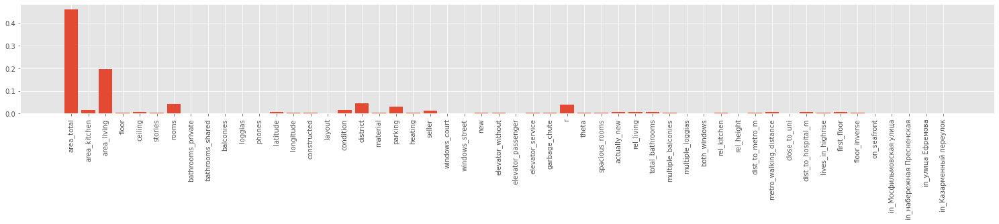

In [101]:
plt.figure(figsize=(26, 3))
plt.bar(train_labels.drop(["building_id"], axis=1).columns.tolist(), best_model.feature_importances_)
plt.xticks(rotation=90)
plt.show()

As we can see from the feature importance, area_total is waay too important for this model - let us do as we have done before: remove area total and rather predict the price per/area and see how the feture importance is then altered, and how the score changes.

**Train a XGB model to predict price/area**

In [104]:
# make sure all data is what we expect
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street"] #, "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = ["street"]

# Load data
train, test, metaData = load_all_data()
# Clean data. 
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=False, log_area=True, fillNan=True)
# Add new features
train_labels, test_labels, added_features = feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    add_some_more_features=True,                                                            
    add_district_information=True,                                                            
    )

# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# One-hot encoding
#train_labels, test_labels = one_hot_encoder(train_labels, test_labels, ["condition", "district", "material", "parking", "heating", "seller"], drop_old=True)
# Drop some features
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

C:\Users\henri\AppData\Local\Temp/ipykernel_19460/2629155559.py:137: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  train_labels = train_labels.fillna(train_labels.median()) # Boolean
C:\Users\henri\AppData\Local\Temp/ipykernel_19460/2629155559.py:146: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  test_labels = test_labels.fillna(test_labels.median()) # Boolean


minMax


In [105]:
price_per_square_meter = train_targets/train['area_total'] # real price / real_area

In [106]:
model_params = [5, 12, 0.15, 0.8, 0.8, 1.1, 0.3, 0.01, 10000]

scores, avg, best_model, models = XGB_groupKFold(5, model_params,
                                                 train_labels.drop(['area_total'],axis=1), np.log(price_per_square_meter),
                                                 eval_metric='rmse')
print(scores)
print("=>",avg)


[0.2037805224017407, 0.17215253259003765, 0.19868815992401082, 0.183412621975599, 0.23091027500342245]
=> 0.19778882237896211


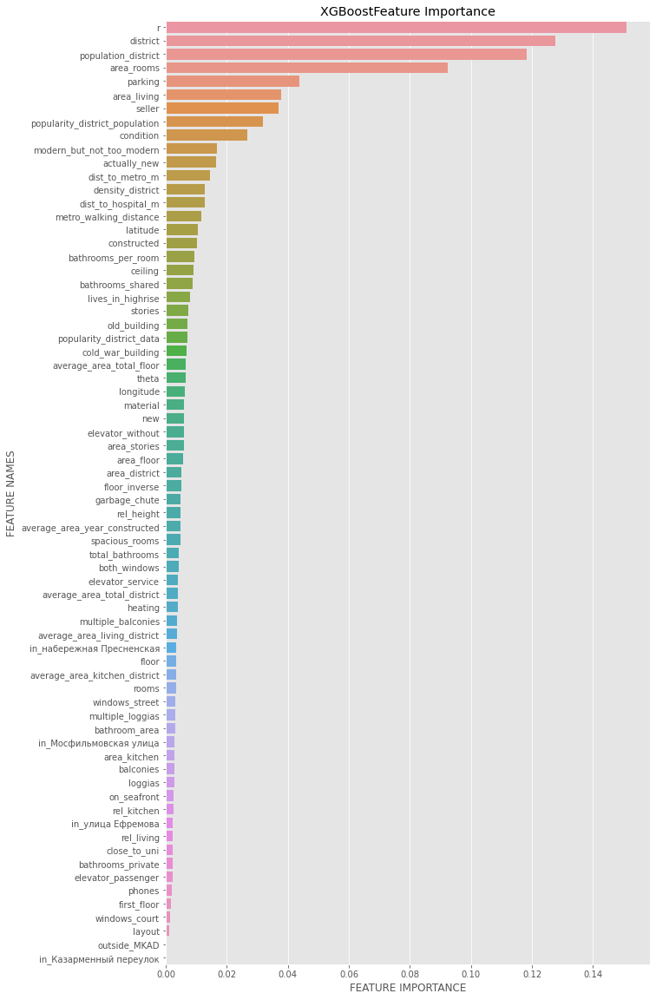

In [107]:
plot_feature_importance(
    best_model.feature_importances_, train_labels.drop(["building_id", "area_total"], axis=1).columns.tolist(),
    model_type="XGBoost")

**XGB conclusions**

Removing area_total and predicting price/area => Not only did the score improve - but we can see from the feature importance graph that we are now relying on many different features rather than just area_total! Great. This seems to be a big problem with XGB: if one features is really well correlated to the target, it will focus too much on this one, and stop caring little for the other features.

As a result, adding more or less features didnt really affect the score of XGB beyond a certain point. But removing the area_total helped alot.

## Ensemble of models

### Bagging
Bagging is pretty straight forward: combine the predictions of a lot of models and hope they have not comitted the same errors. IF the models have very correlated error they will not give each other anything new, but if not they can get a better score together. Luckily we have a lot of different models, who probably have not done the same mistakes at all times.

You will see bagging in action in the final short notebook.

**csv_bagging** simply combines predictions based on their scores and prepares a new prediction for kaggle. This is how we achieved many our best scores in the end, simply by bagg our best LGB model with some other good, but different, models.

In [85]:
def csv_bagging(scores, csv_paths, submission_path):
    # Making the acc dataframe
    d = {}
    for i, score in enumerate(scores):
        d[i] = score
    acc = pd.DataFrame(
    d,
    index=[0]
    )
    acc = acc.T
    acc.columns = ['RMSLE']
    acc

    # Read dataframes, sort and store
    pd_predictions = []
    for path in csv_paths:
        pd_predictions.append(
            pd.read_csv(path).sort_values(by="id")
            )
    # Cast to numpy
    np_predictions = []
    for pred in pd_predictions:
        np_predictions.append(
            pred["price_prediction"].to_numpy().T
        )

    # Bagging
    avg_prediction = np.average(
        np_predictions,
        weights = 1 / acc['RMSLE'] ** 4,
        axis=0
        )
    
    result = avg_prediction
    submission = pd.DataFrame()
    submission['id'] = pd_predictions[0]['id']
    submission['price_prediction'] = result
    if len(submission['id']) != 9937:
        raise Exception("Not enough rows submitted!")
    
    submission.to_csv(submission_path, index=False)

**tree_bagging**: even if we know that bagging is just a linear combination of the different predictions, we made a this function to combine different succesful bags into a bigger bag in a tree structure.

In [102]:
def tree_bagging(bags, submission_path, weight=[4]):
    submission = bag(bags, 0, weight)['data']
    submission.to_csv(submission_path, index=False)

def bag(bags, i, weight = [4]):
    if type(bags) != list:
        return bags
    else:
        new_bags = []
        for b in bags:
            new_bags.append(bag(b, i+1 if i < len(weight)-1 else i, weight))

    if 'data' not in new_bags[0].keys():
        for b in new_bags:
            b['data'] = pd.read_csv(b['path']).sort_values(by="id")

    np_predictions = []
    for b in new_bags:
        np_predictions.append(b['data']["price_prediction"].to_numpy().T)

    score = np.average([bag['score'] for bag in new_bags], weights = [1 / bag['score'] ** weight[i] for bag in new_bags])
    # Bagging
    result = np.average(
        np_predictions,
        weights = [1 / bag['score'] ** weight[i] for bag in new_bags],
        axis=0
        )
    
    submission = pd.DataFrame()
    submission['id'] = new_bags[0]['data']['id']
    submission['price_prediction'] = result
    return {'data': submission, 'score': score}

### Stacking

Unlike bagging, stacking uses a lot of models to predict target both in the training data and testing data - using a sliding oof-window (out of fold) we can train a model on 4/5ths of training data, and then predict the last part. For testing data, each of the 4/5th models predict the entire test set, and their predictions are averaged/bagged together.

The OOF data is then used to train a meta-model on top. This synergy is like having a king listening to his advisors. The king should also have access to the base features, to make up his own mind, but will mostly listen to the advisors.

**Out of fold** / oof functions were created for each model to create the oof data. WE start by training all advisors, and try some different models on top of the stack.

In [103]:
train, test, metaData = load_all_data()

#### XGB advisor 1 😎: all features - predicting price/area

In [4]:
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street"] #, "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = ["street"]

# Load data
train, test, metaData = load_all_data()
# Clean data. 
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=False, log_area=True, fillNan=False)
# Add new features
train_labels, test_labels, added_features = feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    add_some_more_features=False                                                            
    )
# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# Drop
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

minMax


In [5]:
price_per_square_meter = train_targets/train['area_total'] # real price / real_area

In [6]:
xgb_advisor_1 = xgboost.XGBRegressor(max_depth=5, min_child_weight=12, gamma=0.15,
                                 subsample=0.8, colsample_bytree=0.8, reg_alpha=1.1,
                                 reg_lambda=0.3, learning_rate=0.01, n_estimators=10000)

xgb_oof_train_1, xgb_oof_test_1, scores_1 = get_oof_xgboost(xgb_advisor_1, train_labels.drop(['area_total'],axis=1),
                                                      np.log(price_per_square_meter), test_labels.drop(['area_total'],axis=1))

In [7]:
print(scores_1)

[0.20252494570910018, 0.1719402910622423, 0.19194384452156768, 0.18187339676857273, 0.23624429647388234]


In [80]:
np.savez("oofs/xgb_oof_train_area", xgb_oof_train_1)
np.savez("oofs/xgb_oof_test_area", xgb_oof_test_1)

#### XGB advisor 2 😎: Even more features - as well as area total - predicting price

In [8]:
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street"] #, "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = ["street"]

# Load data
train, test, metaData = load_all_data()
# Clean data. 
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=True, log_area=True, fillNan=True)
# Add new features
train_labels, test_labels, added_features = feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    add_some_more_features=True                                                            
    )
# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# Drop
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

C:\School\høst 2021\TDT4173-ML\common_utils.py:1467: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  train_labels = train_labels.fillna(train_labels.median()) # Boolean
C:\School\høst 2021\TDT4173-ML\common_utils.py:1476: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  test_labels = test_labels.fillna(test_labels.median()) # Boolean


minMax


In [9]:
xgb_advisor_2 = xgboost.XGBRegressor(max_depth=5, min_child_weight=12, gamma=0.15,
                                 subsample=0.8, colsample_bytree=0.8, reg_alpha=1.1,
                                 reg_lambda=0.3, learning_rate=0.01, n_estimators=10000)

xgb_oof_train_2, xgb_oof_test_2, scores_2 = get_oof_xgboost(xgb_advisor_2, train_labels,
                                                      train_targets, test_labels)

In [10]:
print(scores_2)

[0.21366608257200162, 0.17480404267524746, 0.19900553175201274, 0.18699747945287365, 0.2390275085244918]


In [79]:
np.savez("oofs/xgb_oof_train_price", xgb_oof_train_2)
np.savez("oofs/xgb_oof_test_price", xgb_oof_test_2)

#### DL advisor 1 - Predicting area_price

In [81]:
%run ../common_utils.py

In [82]:
# Mostly the ones correlated to price.
float_numerical_features = ["area_total", "area_kitchen", "area_living", "latitude", "longitude", "ceiling"]

int_numerical_features = ["floor", "stories", "rooms", "bathrooms_shared", "bathrooms_private", "balconies", "constructed"]

cat_features = ["district", "material", "parking", "seller"]

bool_features = []

features = ["building_id", "street"] + float_numerical_features + int_numerical_features + cat_features + bool_features

# Many of the features was just added to help clean/engineer other features.
droptable = ['longitude', 'latitude', 'area_kitchen', 'area_living', 'floor', 'stories', "street",
            "rel_living", "bathrooms_shared", "bathrooms_private", "theta"] 

In [83]:
# Load data
train, test, metaData = load_all_data()

In [84]:
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=False, log_area=False, fillNan=True)

C:\School\høst 2021\TDT4173-ML\common_utils.py:1508: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  train_labels = train_labels.fillna(train_labels.median()) # Boolean
C:\School\høst 2021\TDT4173-ML\common_utils.py:1517: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  test_labels = test_labels.fillna(test_labels.median()) # Boolean


In [85]:
# Feature engineering
train_labels, test_labels, added_features = feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=False,
    add_weak_features=False,
    add_dist_to_metro=True,
    add_close_to_uni=False,
    add_dist_to_hospital=False,
    add_floor_features=False,
    add_street_info=True,
    )

In [86]:
# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")

minMax


In [87]:
# One-hot encoding
train_labels, test_labels = one_hot_encoder(train_labels, test_labels,
                                            cat_features, drop_old=True)

In [88]:
# Droptable
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

In [89]:
price_per_square_meter = train_targets/train['area_total']

In [96]:
model_params = ([18, 18, 18], tensorflow.nn.leaky_relu,
                     [False, False, False], 0.2, 'adam',
                      rmsle_custom, ['mse', 'msle', tensorflow.keras.metrics.Accuracy()], True)

ann_oof_train_1, ann_oof_test_1, hists_1 = get_oof_ann(model_params,
                                                 train_labels.drop(['area_total'],axis=1),
                                                 price_per_square_meter,
                                                 test_labels.drop(['area_total'],axis=1), strict_restart=False)


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
..........Epoch 00510: early stopping

....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
...................................................

In [97]:
for history in hists_1:
    print(history.history["val_loss"][-1], end=", ")

0.22691620886325836, 0.216660276055336, 0.21282845735549927, 0.21846720576286316, 0.24183255434036255, 

In [98]:
np.savez("oofs/ann_oof_train_area", ann_oof_train_1)
np.savez("oofs/ann_oof_test_area", ann_oof_test_1)

#### DL advisor 2 - Predicting price directly

In [27]:
%run ../common_utils.py

In [113]:
# Mostly the ones correlated to price.
float_numerical_features = ["area_total", "area_kitchen", "area_living", "latitude", "longitude", "ceiling"]

int_numerical_features = ["floor", "stories", "rooms", "bathrooms_shared", "bathrooms_private", "balconies", "constructed"]

cat_features = ["district", "material", "parking", "seller"]

bool_features = []

features = ["building_id", "street"] + float_numerical_features + int_numerical_features + cat_features + bool_features

# Many of the features was just added to help clean/engineer other features.
droptable = ['longitude', 'latitude', 'area_kitchen', 'area_living', 'floor', 'stories', "street",
            "rel_living", "bathrooms_shared", "bathrooms_private", "theta"]

In [114]:
# Load data
train, test, metaData = load_all_data()

In [115]:
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=False, log_area=False, fillNan=True)

C:\School\høst 2021\TDT4173-ML\common_utils.py:1513: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  train_labels = train_labels.fillna(train_labels.median()) # Boolean
C:\School\høst 2021\TDT4173-ML\common_utils.py:1522: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  test_labels = test_labels.fillna(test_labels.median()) # Boolean


In [116]:
# Feature engineering
train_labels, test_labels, added_features = feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=False,
    add_weak_features=False,
    add_dist_to_metro=True,
    add_close_to_uni=False,
    add_dist_to_hospital=False,
    add_floor_features=False,
    add_street_info=True,
    )

In [117]:
# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")

minMax


In [118]:
# Droptable
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

In [129]:
model_params = ([18, 18, 18], tensorflow.nn.leaky_relu,
                     [False, False, False], 0.2, 'adam',
                      rmsle_custom, ['mse', 'msle', tensorflow.keras.metrics.Accuracy()], True)

ann_oof_train_2, ann_oof_test_2, hists_2 = get_oof_ann(model_params,
                                                 train_labels,
                                                 train_targets,
                                                 test_labels, strict_restart=True)


....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
.......................................Epoch 00539: early stopping

....................................................................................................
....................................................................................................
....................................................................................................
....................................................................................................
......................

In [130]:
for history in hists_2:
    print(history.history["val_loss"][-1], end=", ")

0.25357669591903687, 0.24738579988479614, 0.24683038890361786, 0.2576080560684204, 0.3004554212093353, 

In [132]:
np.savez("oofs/ann_oof_train_price", ann_oof_train_2)
np.savez("oofs/ann_oof_test_price", ann_oof_test_2)

#### Best LGB advisor - predicts price/area

In [100]:
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street", "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = []

# Load data
train, test, metaData = load_all_data()
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=False, log_area=True, fillNan=True)
# Add new features
train_labels, test_labels, added_features = feature_engineering(
    train_labels, 
    test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    add_some_more_features=True,
    add_district_information=True,
    )

# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# One-hot encoding
train_labels, test_labels = one_hot_encoder(train_labels, test_labels, ["condition", "district", "material", "parking", "heating", "seller"], drop_old=True)
# Drop some features
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

droptable = ['street','address']
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

# Price per area
price_per_square_meter = train_targets/train['area_total'] # real price / real_area

C:\School\høst 2021\TDT4173-ML\common_utils.py:1513: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  train_labels = train_labels.fillna(train_labels.median()) # Boolean
C:\School\høst 2021\TDT4173-ML\common_utils.py:1522: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  test_labels = test_labels.fillna(test_labels.median()) # Boolean


minMax


In [106]:
params= {
 'num_iterations': 10000,
 'n_estimators': 152*5,
 'learning_rate': 0.05/5,
 'num_leaves': 40,
 'max_depth': 10,
 'min_data_in_leaf': 20,
 'bagging_fraction': 0.9,
 'bagging_freq': 5,
 'feature_fraction': 0.8,
}

lgbm_model = lightgbm.LGBMRegressor(
    **params, 
    random_state=42,
    early_stopping_round=100,
    silent=True,
    metric='regression',
    num_threads=4)

In [109]:
lgbm_oof_train, lgbm_oof_test, scores = get_oof_lgbm(lgbm_model,
                                                     train_labels.drop(['area_total'],axis=1),
                                                     np.log(price_per_square_meter),
                                                     test_labels.drop(['area_total'],axis=1))

c:\python\python38\lib\site-packages\lightgbm\sklearn.py:598: UserWarning: 'silent' argument is deprecated and will be removed in a future release of LightGBM. Pass 'verbose' parameter via keyword arguments instead.
  _log_warning("'silent' argument is deprecated and will be removed in a future release of LightGBM. "
c:\python\python38\lib\site-packages\lightgbm\sklearn.py:736: UserWarning: 'verbose' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose' argument is deprecated and will be removed in a future release of LightGBM. "
c:\python\python38\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")


[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] num_threads is set=4, n_jobs=-1 will be ignored. Current value: num_threads=4
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5
Training until validation scores don't improve for 15 rounds
Early stopping, best iteration is:
[998]	valid_0's l2: 0.0395304	valid_0's custom_asymmetric_eval: 0.0146689
[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Wa

In [110]:
print(scores)

[0.19882169591944485, 0.17331712016749312, 0.1921920843857648, 0.18744743537675287, 0.21970472822532938]


In [111]:
np.savez("oofs/lgb_oof_train_area", lgbm_oof_train)
np.savez("oofs/lgb_oof_test_area", lgbm_oof_test)

**Now** we have prepared a nice set of advisors, and will start putting meta-models on top. For fun, we call the meta models "king", due to the advisor-king analogy we gave earlier.

#### XGBoost King 👑👑👑

In [15]:
import warnings
warnings.filterwarnings("ignore")

In [37]:
# Train only on advisors.
#train_labels = train[["building_id", "area_total"]]
#test_labels = test[["building_id", "area_total"]]
#train_targets = train['price']
# make sure all data is what we expect

features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street"] #, "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = ["street"]

# Load data
train, test, metaData = load_all_data()
# Clean data. 
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=False, log_area=True, fillNan=False)
# Add new features
train_labels, test_labels, added_features = feature_engineering(train_labels, test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    add_some_more_features=False,                                                            
    add_district_information=False,                                                            
    )

# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# One-hot encoding
#train_labels, test_labels = one_hot_encoder(train_labels, test_labels, ["condition", "district", "material", "parking", "heating", "seller"], drop_old=True)
# Drop some features
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)


minMax


Adding all the advisors model's. WE also have some "old" adviors which we trained in a different notebook. They were made in the start of the project and dont perform to well. BUt it is up to the king to listen to them. 

In [38]:
# OLD
old_lgbm_oof_train = (np.load("oofs/old_lgbm_oof_train.npz")['arr_0']).reshape((len(old_lgbm_oof_train), )) 
old_lgbm_oof_test = (np.load("oofs/old_lgbm_oof_test.npz")['arr_0']).reshape((len(old_lgbm_oof_test), )) 

old_rf_oof_train = (np.load("oofs/old_rf_oof_train.npz")['arr_0']).reshape((len(old_rf_oof_train), )) 
old_rf_oof_test = (np.load("oofs/old_rf_oof_test.npz")['arr_0']).reshape((len(old_rf_oof_test), )) 

old_xgb_oof_train = (np.load("oofs/old_xgb_oof_train.npz")['arr_0']).reshape((len(old_xgb_oof_train), )) 
old_xgb_oof_test = (np.load("oofs/old_xgb_oof_test.npz")['arr_0']).reshape((len(old_xgb_oof_test), )) 

old_ann_oof_train = (np.load("oofs/old_ann_oof_train.npz")['arr_0']).reshape((len(old_ann_oof_train), )) 
old_ann_oof_test = (np.load("oofs/old_ann_oof_test.npz")['arr_0']).reshape((len(old_ann_oof_test), )) 
# NEW
lgbm_oof_train_area = (np.load("oofs/lgb_oof_train_area.npz")['arr_0']).reshape((len(lgbm_oof_train_area), )) 
lgbm_oof_test_area = (np.load("oofs/lgb_oof_test_area.npz")['arr_0']).reshape((len(lgbm_oof_test_area), ))

ann_oof_train_area = (np.load("oofs/ann_oof_train_area.npz")['arr_0']).reshape((len(ann_oof_train_area), )) 
ann_oof_test_area = (np.load("oofs/ann_oof_test_area.npz")['arr_0']).reshape((len(ann_oof_test_area), ))

ann_oof_train_price = (np.load("oofs/ann_oof_train_price.npz")['arr_0']).reshape((len(ann_oof_train_price), )) 
ann_oof_test_price = (np.load("oofs/ann_oof_test_price.npz")['arr_0']).reshape((len(ann_oof_test_price), ))

xgb_oof_train_area = (np.load("oofs/xgb_oof_train_area.npz")['arr_0']).reshape((len(xgb_oof_train_area), )) 
xgb_oof_test_area = (np.load("oofs/xgb_oof_test_area.npz")['arr_0']).reshape((len(xgb_oof_test_area), ))

xgb_oof_train_price = (np.load("oofs/xgb_oof_train_price.npz")['arr_0']).reshape((len(xgb_oof_train_price), )) 
xgb_oof_test_price = (np.load("oofs/xgb_oof_test_price.npz")['arr_0']).reshape((len(xgb_oof_test_price), ))

In [43]:
# The old advisors
train_labels["old_xgb_preds"] = np.log(np.exp(old_xgb_oof_train) / train['area_total'])
test_labels["old_xgb_preds"] = np.log(np.exp(old_xgb_oof_test) / test['area_total'])

train_labels["old_lgbm_preds"] = np.log(np.exp(old_lgbm_oof_train) / train['area_total'])
test_labels["old_lgbm_preds"] = np.log(np.exp(old_lgbm_oof_test) / test['area_total'])

train_labels["old_ann_preds"] = np.log(old_ann_oof_train / train['area_total'])
test_labels["old_ann_preds"] = np.log(old_ann_oof_test / test['area_total'])

train_labels["old_rf_preds"] = np.log(old_rf_oof_train / train['area_total'])
test_labels["old_rf_preds"] = np.log(old_rf_oof_test / test['area_total'])

# New advisor
train_labels["lgbm_oof_area"] = lgbm_oof_train_area
test_labels["lgbm_oof_area"] = lgbm_oof_test_area

train_labels["ann_oof_area"] = np.log(ann_oof_train_area)
test_labels["ann_oof_area"] = np.log(ann_oof_test_area)

train_labels["ann_oof_price"] = np.log(ann_oof_train_price / train['area_total'])
test_labels["ann_oof_price"] = np.log(ann_oof_test_price / test['area_total'])

train_labels["xgb_oof_area"] = xgb_oof_train_area
test_labels["xgb_oof_area"] = xgb_oof_test_area

train_labels["xgb_oof_price"] = np.log(np.exp(xgb_oof_train_price) / train['area_total'])
test_labels["xgb_oof_price"] = np.log(np.exp(xgb_oof_test_price) / test['area_total'])

In [44]:
# Normalize these predictions.
predictor_feats=[ "old_xgb_preds", "old_lgbm_preds", "old_ann_preds", "old_rf_preds", "lgbm_oof_area", "ann_oof_area", "ann_oof_price", "xgb_oof_area", "xgb_oof_price"]
train_labels, test_labels = normalize(train_labels, test_labels, predictor_feats, scaler="minMax")

minMax


In [45]:
price_per_square_meter = train_targets/train['area_total'] # real price / real_area

##### Stacking the standard way. TODO - normalize the labels.

In [49]:
model_params = [5, 12, 0.15, 0.8, 0.8, 1.1, 0.3, 0.01, 10000]
scores, avg, best_model, models = XGB_groupKFold(5, model_params,
                                                 train_labels.drop(['area_total'],axis=1), np.log(price_per_square_meter),
                                                 eval_metric='rmse')
print(scores)
print("=>",avg)

[0.21209225956096223, 0.18773399078543584, 0.19879196452834388, 0.18505137129530672, 0.2373648517897129]
=> 0.20420688759195232


In [50]:
predict_and_store(best_model, test_labels.drop(["building_id", "area_total"], axis=1),
                  test, path="ensemble_predictions/stacking_on_old_and_new_2", exponential=True,
                  price_per_sq=True, total_area_df=test["area_total"])

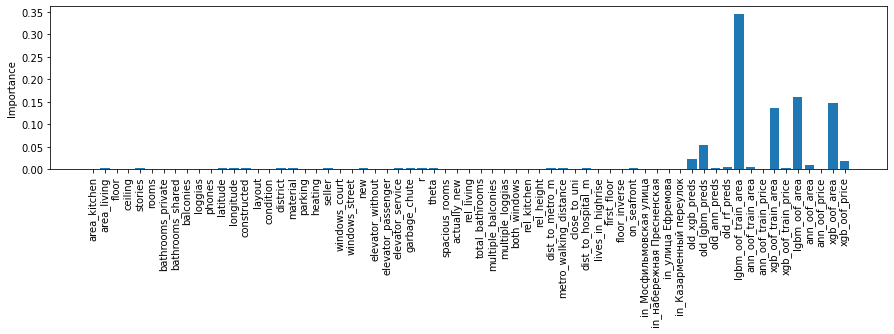

In [52]:
#plot_feature_importance(
#    train_labels.drop(["building_id", "area_total"], axis=1).columns.tolist(), best_model.feature_importances_,
#    model_type="XGBoost", figsize=(20, 4))

plt.figure(figsize=(15, 3))
plt.bar(train_labels.drop(["building_id", "area_total"], axis=1).columns.tolist(), best_model.feature_importances_)
plt.xticks(rotation=90)
plt.ylabel("Importance")
plt.show()

**The XGB** king listened a lot to his advisors, whithout looking too much at the input from the pesants (other data). This fits with what we knew about XGB from before: it quickly starts focusing on only the best features ignoring the rest. As we can see from the score above, the XGB king was not really improving the scores from its advisors, just copying it more or less: lets try another king! # Revolution

#### Now train on all the data!

In [53]:
## Make a model, predicting on all the stuff. Might overfit a lot!
xgb_model = xgboost.XGBRegressor(max_depth=5, min_child_weight=12, gamma=0.15, subsample=0.8, colsample_bytree=0.8, reg_alpha=1.1, reg_lambda=0.3, learning_rate=0.01, n_estimators=10000)
fit_data = xgb_model.fit(train_labels.drop(['area_total', 'building_id'],axis=1),
            np.log(price_per_square_meter),
            eval_metric='rmse',
            verbose=False,)

In [54]:
# Training score
prediction = np.exp(xgb_model.predict(train_labels.drop(['area_total', 'building_id'],axis=1)))

In [55]:
predict_and_store(xgb_model, test_labels.drop(["building_id", "area_total"], axis=1),
                  test, path="ensemble_predictions/stacking_on_all_data_2", exponential=True,
                  price_per_sq=True, total_area_df=test["area_total"])

#### LGB KING 👑👑

In [56]:
%run ../common_utils.py

In [57]:
features =           ["building_id", # For grouping
                      "area_total", "area_kitchen", "area_living", "floor", "ceiling", "stories", "rooms",
                      "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed", # Numerical
                     "layout", "condition", "district", "material", "parking", "heating", "seller", #Categorical
                      "windows_court", "windows_street", "new", "elevator_without", "elevator_passenger", "elevator_service", "garbage_chute", # Bool
                     "street", "address"] # Strings

all_numerical_features = ["area_total", "area_kitchen", "area_living", "floor",
                      "ceiling", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies","loggias", "phones", "latitude", "longitude", "constructed"]

float_numerical_features = ["area_total", "area_kitchen", "area_living", "ceiling", "latitude", "longitude", "constructed"]
int_numerical_features = ["floor", "stories", "rooms", "bathrooms_private", "bathrooms_shared", "balconies", "loggias", "phones"] # Ordinal categories

cat_features = ["layout", "condition", "district", "material", "parking", "heating", "seller"] # All are non-ordinal

droptable = []

# Load data
train, test, metaData = load_all_data()
# Clean data
train_labels, train_targets, test_labels = clean_data(train, test, features, float_numerical_features, int_numerical_features, cat_features,
                                                      log_targets=False, log_area=True, fillNan=True)
# Add new features
train_labels, test_labels, added_features = feature_engineering(
    train_labels, 
    test_labels,
    add_base_features=True, 
    add_bool_features=True,
    add_weak_features=True,
    add_dist_to_metro=True,
    add_close_to_uni=True,
    add_dist_to_hospital=True,
    add_floor_features=True,
    add_street_info=True,
    add_some_more_features=True,
    add_district_information=True,
    )

# Normalize
train_labels, test_labels = normalize(train_labels, test_labels, float_numerical_features, scaler="minMax")
# One-hot encoding
train_labels, test_labels = one_hot_encoder(train_labels, test_labels, ["condition", "district", "material", "parking", "heating", "seller"], drop_old=True)
# Drop some features
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

droptable = ['street','address']
train_labels.drop(droptable, inplace=True, axis=1)
test_labels.drop(droptable, inplace=True, axis=1)

# Price per area
price_per_square_meter = train_targets/train['area_total'] # real price / real_area

minMax


In [58]:
# OLD
old_lgbm_oof_train = (np.load("oofs/old_lgbm_oof_train.npz")['arr_0']).reshape((len(old_lgbm_oof_train), )) 
old_lgbm_oof_test = (np.load("oofs/old_lgbm_oof_test.npz")['arr_0']).reshape((len(old_lgbm_oof_test), )) 

old_rf_oof_train = (np.load("oofs/old_rf_oof_train.npz")['arr_0']).reshape((len(old_rf_oof_train), )) 
old_rf_oof_test = (np.load("oofs/old_rf_oof_test.npz")['arr_0']).reshape((len(old_rf_oof_test), )) 

old_xgb_oof_train = (np.load("oofs/old_xgb_oof_train.npz")['arr_0']).reshape((len(old_xgb_oof_train), )) 
old_xgb_oof_test = (np.load("oofs/old_xgb_oof_test.npz")['arr_0']).reshape((len(old_xgb_oof_test), )) 

old_ann_oof_train = (np.load("oofs/old_ann_oof_train.npz")['arr_0']).reshape((len(old_ann_oof_train), )) 
old_ann_oof_test = (np.load("oofs/old_ann_oof_test.npz")['arr_0']).reshape((len(old_ann_oof_test), )) 
# NEW
lgbm_oof_train_area = (np.load("oofs/lgb_oof_train_area.npz")['arr_0']).reshape((len(lgbm_oof_train_area), )) 
lgbm_oof_test_area = (np.load("oofs/lgb_oof_test_area.npz")['arr_0']).reshape((len(lgbm_oof_test_area), ))

ann_oof_train_area = (np.load("oofs/ann_oof_train_area.npz")['arr_0']).reshape((len(ann_oof_train_area), )) 
ann_oof_test_area = (np.load("oofs/ann_oof_test_area.npz")['arr_0']).reshape((len(ann_oof_test_area), ))

ann_oof_train_price = (np.load("oofs/ann_oof_train_price.npz")['arr_0']).reshape((len(ann_oof_train_price), )) 
ann_oof_test_price = (np.load("oofs/ann_oof_test_price.npz")['arr_0']).reshape((len(ann_oof_test_price), ))

xgb_oof_train_area = (np.load("oofs/xgb_oof_train_area.npz")['arr_0']).reshape((len(xgb_oof_train_area), )) 
xgb_oof_test_area = (np.load("oofs/xgb_oof_test_area.npz")['arr_0']).reshape((len(xgb_oof_test_area), ))

xgb_oof_train_price = (np.load("oofs/xgb_oof_train_price.npz")['arr_0']).reshape((len(xgb_oof_train_price), )) 
xgb_oof_test_price = (np.load("oofs/xgb_oof_test_price.npz")['arr_0']).reshape((len(xgb_oof_test_price), ))

In [59]:
# The old advisors
train_labels["old_xgb_preds"] = np.log(np.exp(old_xgb_oof_train) / train['area_total'])
test_labels["old_xgb_preds"] = np.log(np.exp(old_xgb_oof_test) / test['area_total'])

train_labels["old_lgbm_preds"] = np.log(np.exp(old_lgbm_oof_train) / train['area_total'])
test_labels["old_lgbm_preds"] = np.log(np.exp(old_lgbm_oof_test) / test['area_total'])

train_labels["old_ann_preds"] = np.log(old_ann_oof_train / train['area_total'])
test_labels["old_ann_preds"] = np.log(old_ann_oof_test / test['area_total'])

train_labels["old_rf_preds"] = np.log(old_rf_oof_train / train['area_total'])
test_labels["old_rf_preds"] = np.log(old_rf_oof_test / test['area_total'])

# New advisor
train_labels["lgbm_oof_area"] = lgbm_oof_train_area
test_labels["lgbm_oof_area"] = lgbm_oof_test_area

train_labels["ann_oof_area"] = np.log(ann_oof_train_area)
test_labels["ann_oof_area"] = np.log(ann_oof_test_area)

train_labels["ann_oof_price"] = np.log(ann_oof_train_price / train['area_total'])
test_labels["ann_oof_price"] = np.log(ann_oof_test_price / test['area_total'])

train_labels["xgb_oof_area"] = xgb_oof_train_area
test_labels["xgb_oof_area"] = xgb_oof_test_area

train_labels["xgb_oof_price"] = np.log(np.exp(xgb_oof_train_price) / train['area_total'])
test_labels["xgb_oof_price"] = np.log(np.exp(xgb_oof_test_price) / test['area_total'])

In [60]:
# Normalize these predictions.
predictor_feats=[ "old_xgb_preds", "old_lgbm_preds", "old_ann_preds", "old_rf_preds", "lgbm_oof_area", "ann_oof_area", "ann_oof_price", "xgb_oof_area", "xgb_oof_price"]
train_labels, test_labels = normalize(train_labels, test_labels, predictor_feats, scaler="minMax")

minMax


In [67]:
params= {
 'num_iterations': 10000,
 'n_estimators': 152*5,
 'learning_rate': 0.05/5,
 'num_leaves': 40,
 'max_depth': 10,
 'min_data_in_leaf': 20,
 'bagging_fraction': 0.9,
 'bagging_freq': 5,
 'feature_fraction': 0.8,
}
lgbm_king = lightgbm.LGBMRegressor(
    **params, 
    random_state=1,
    early_stopping_round=100,
    silent=True,
    metric='regression',
    num_threads=4)
lgbm_no_cv = lightgbm.LGBMRegressor(
    **params, 
    random_state=1,
    silent=True,
    metric='regression',
    num_threads=4)

In [69]:
%%capture --no-display
scores, average_score, best_model, best_index = lgbm_groupKFold(
    number_of_splits=5,
    model=lgbm_king,
    X_train=train_labels.drop(['area_total'],axis=1), 
    y_train=np.log(price_per_square_meter))

In [70]:
print(scores)

[0.20990739653805268, 0.1833667824219476, 0.19733090181417692, 0.186006516347325, 0.23292145346480514]


In [71]:
#lgbm_oof_train, lgbm_oof_test, scores = get_oof_lgbm(lgbm_model,
#                                                     train_labels.drop(['area_total'],axis=1),
#                                                     np.log(price_per_square_meter),
#                                                     test_labels.drop(['area_total'],axis=1))

lgbm_no_cv.fit(train_labels.drop(['area_total'],axis=1),np.log(price_per_square_meter))

[LightGBM] [Warning] feature_fraction is set=0.8, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.8
[LightGBM] [Warning] min_data_in_leaf is set=20, min_child_samples=20 will be ignored. Current value: min_data_in_leaf=20
[LightGBM] [Warning] bagging_fraction is set=0.9, subsample=1.0 will be ignored. Current value: bagging_fraction=0.9
[LightGBM] [Warning] num_threads is set=4, n_jobs=-1 will be ignored. Current value: num_threads=4
[LightGBM] [Warning] bagging_freq is set=5, subsample_freq=0 will be ignored. Current value: bagging_freq=5


LGBMRegressor(bagging_fraction=0.9, bagging_freq=5, feature_fraction=0.8,
              learning_rate=0.01, max_depth=10, metric='regression',
              min_data_in_leaf=20, n_estimators=760, num_iterations=10000,
              num_leaves=40, num_threads=4, random_state=1, silent=True)

In [73]:
predict_and_store(best_model, test_labels.drop(['area_total'],axis=1),
                  test, path="ensemble_predictions\lgbm_king_cv.csv", exponential=True, price_per_sq = True,
                  total_area_df = test['area_total'])

predict_and_store(lgbm_no_cv, test_labels.drop(['area_total'],axis=1),
                  test, path="ensemble_predictions\lgbm_king_no_cv.csv", exponential=True, price_per_sq = True,
                  total_area_df = test['area_total'])


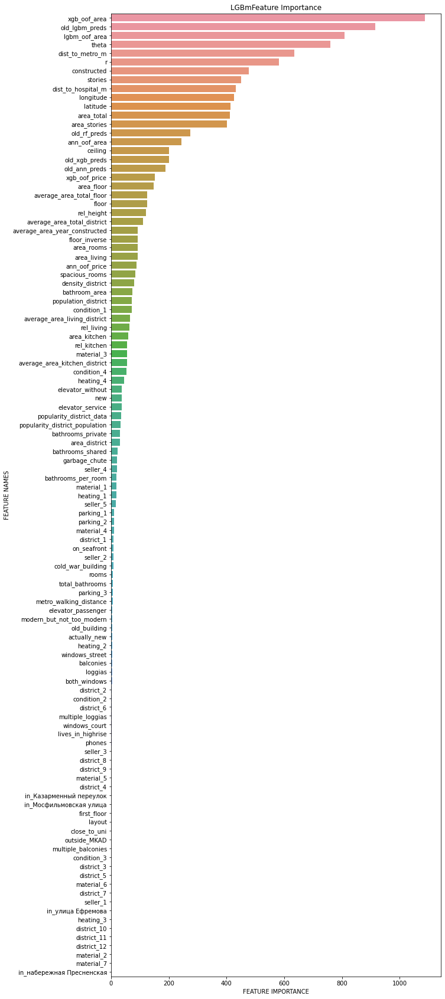

In [78]:
plot_feature_importance(
    best_model.feature_importances_, train_labels.drop(["building_id"], axis=1).columns.tolist(),
    model_type="LGBm", figsize=(10,30))

In [108]:
print(np.average([0.20990739653805268, 0.1833667824219476, 0.19733090181417692, 0.186006516347325, 0.23292145346480514]))

0.20190661011726146


**LGBM KING** Even if the LGBM king looked more at the other features, not only listening to the advisors, it also didnt really manage to increase the scores for this problem. Maybe we need a new king!

### THE ANN KING 👑👑👑

In [111]:
model_params = ([18, 18, 18], nn.leaky_relu,
                     [False, False, False], 0.2, 'adam',
                      rmsle_custom, ['mse', 'msle', metrics.Accuracy()], True)

In [39]:
ann_scores, models, best_model, hists = ANN_groupKFold(5, model_params, train_labels, train_targets)


...........................................................................Epoch 00075: early stopping
New best model!

...............................................................Epoch 00063: early stopping

....................................................Epoch 00052: early stopping
New best model!

.........................................Epoch 00041: early stopping

....................................................................Epoch 00068: early stopping


In [40]:
print(ann_scores)
print("==>\t", np.average(ann_scores))

[0.1852976232767105, 0.18717044591903687, 0.15437853336334229, 16.474166870117188, 0.19578523933887482]
==>	 3.43935974240303


,loss,mse,msle,accuracy,val_loss,val_mse,val_msle,val_accuracy,epoch
66,0.187477,1.614198e+14,0.037160,0.0,0.195575,2.207648e+14,0.056483,0.0,66
67,0.187364,1.608416e+14,0.037057,0.0,0.195785,2.187477e+14,0.056272,0.0,67


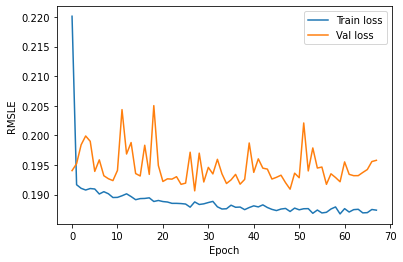

In [58]:
# Results
history = hists[4]
hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
#hist.loc[hist["val_loss"]==hist["val_loss"].min()]
display(hist.tail(2))
plt.figure()
plt.xlabel('Epoch')
plt.ylabel('RMSLE')
#plt.yscale("log")
plt.plot(hist['epoch'], hist['loss'], label='Train loss')
plt.plot(hist['epoch'], hist['val_loss'], label = 'Val loss')
plt.legend()
plt.show()

In [43]:
# deep_king_1: uses same features as deep advisor, and same model type as 8_4.
# deep_king_2: is the same, just re-running deep_advisor for better score. NB: deleted...
# deep_king_3: Is deeper, and wider, and adds regularizations. Is worse. - NB! Also used leaky relu! Three tings were added: depth, regularization and leaky => worse!
# deep_king_4: removes regularization, is a little less wide (64)        - NB! Also used leaky relu! Regularization was removed: improved slightly!
# deep_king_5: removes all other than the pre-trained ones!              - Completely different test. Made a lot of copies.

In [44]:
predict_and_store(best_model, #models[4],
                  test_labels.drop(["building_id"], axis=1), test, path="ensemble_predictions/deep_king_5_5", exponential=False)

**THE ANN KING is promising**, if we ignore the unstability of the ANN model - the scores look a lot better than for the other kings. We guess the ANN is better at finding the patterns in this situation.

### Stacking conclusions

Stacking takes a lot of time and work: training each advisor, storing the OOFS, making the OOF functions etc. The results we got for this time was not that impressive, and doing simple bagging worked better for all of our tests. Even the ANN king could beat the best booting models.

Our problem probably lies with the king/meta model. All our models are tuned for a certain set of features, and not for the OOF data. IF we had had more time we would have looked at tuning the models better. The ANN model is hardly tuned at all and all the others are tuned for a diffrent dataset.
